In [3]:
import numpy as np
import pandas as pd
import cv2
import pickle
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from sklearn.cluster import AgglomerativeClustering
from imutils import build_montages

In [2]:
print("[INFO] Loading face encodings...")
data = pickle.loads(open("encodings1.pickle", "rb").read())
data = np.array(data)
encodings = [d["encoding"] for d in data]

[INFO] Loading face encodings...


In [3]:
n_components_values = list(range(1, min(len(encodings[0]), len(encodings)) + 1))

explained_variances = []

for n_component in n_components_values:
    pca = PCA(n_components=n_component)
    pca.fit(encodings)
    explained_variances.append(np.sum(pca.explained_variance_ratio_))

[INFO] Number of unique faces: 30
[INFO] Faces for face ID: 0


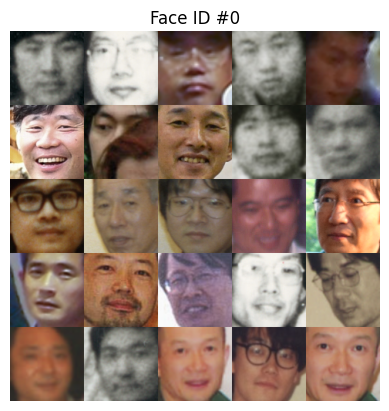

[INFO] Faces for face ID: 1


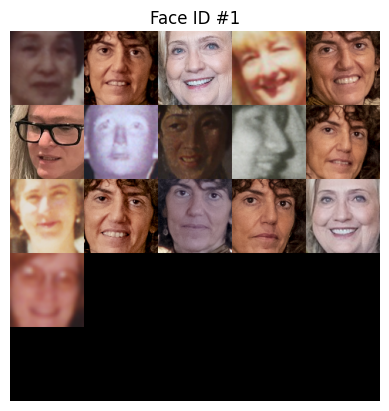

[INFO] Faces for face ID: 2


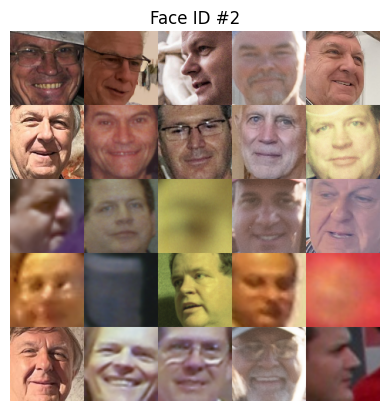

[INFO] Faces for face ID: 3


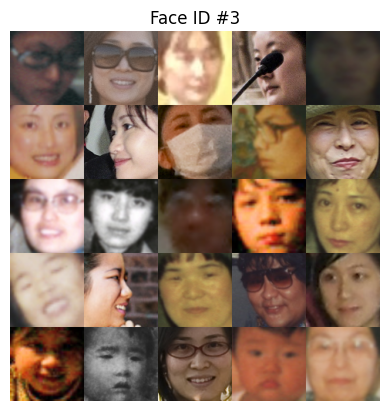

[INFO] Faces for face ID: 4


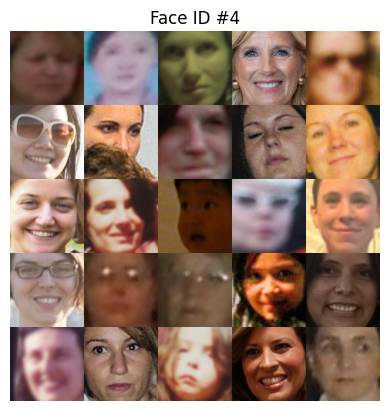

[INFO] Faces for face ID: 5


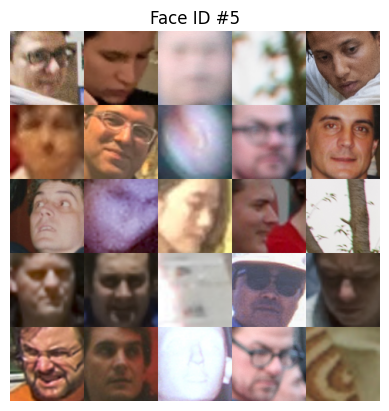

[INFO] Faces for face ID: 6


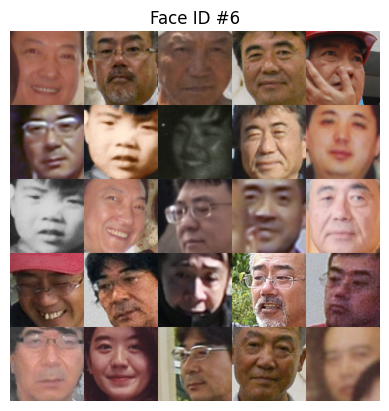

[INFO] Faces for face ID: 7


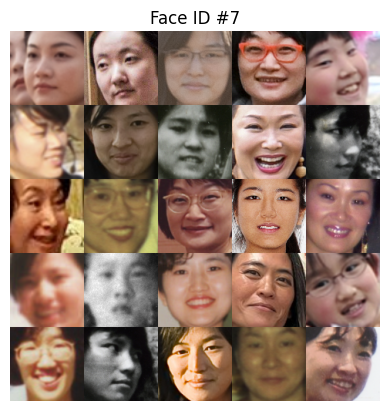

[INFO] Faces for face ID: 8


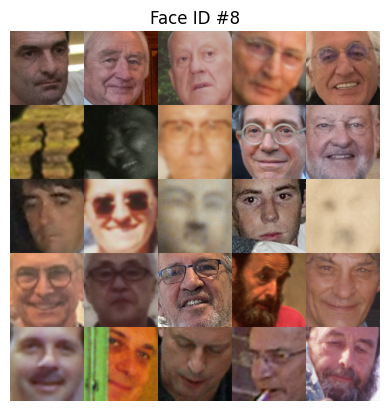

[INFO] Faces for face ID: 9


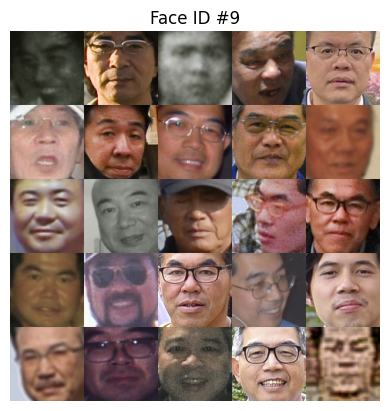

[INFO] Faces for face ID: 10


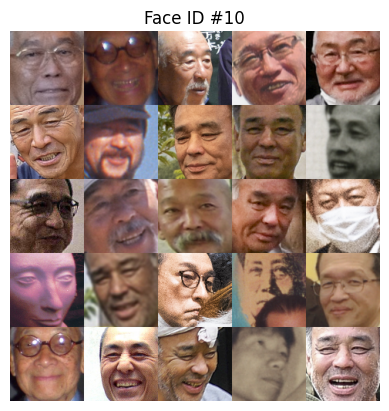

[INFO] Faces for face ID: 11


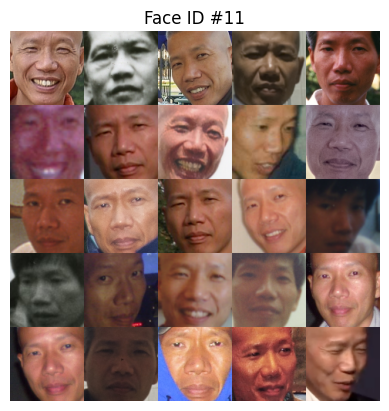

[INFO] Faces for face ID: 12


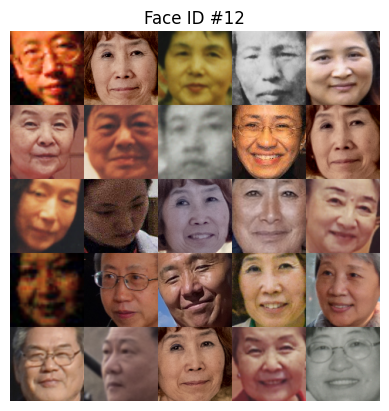

[INFO] Faces for face ID: 13


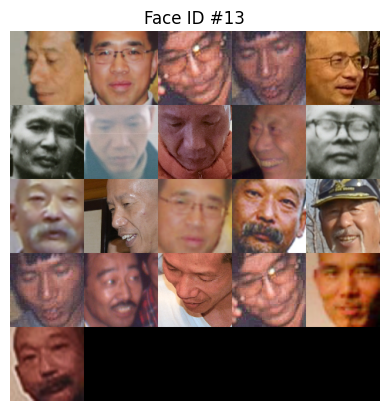

[INFO] Faces for face ID: 14


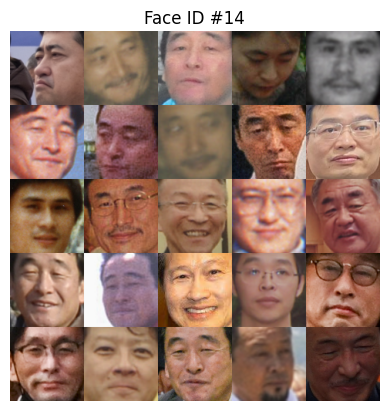

[INFO] Faces for face ID: 15


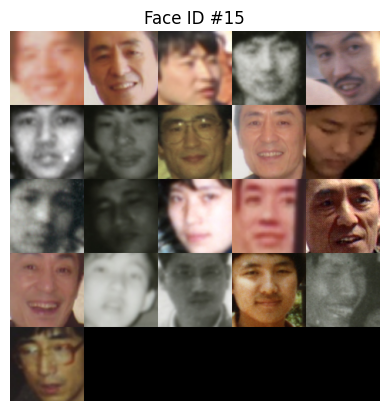

[INFO] Faces for face ID: 16


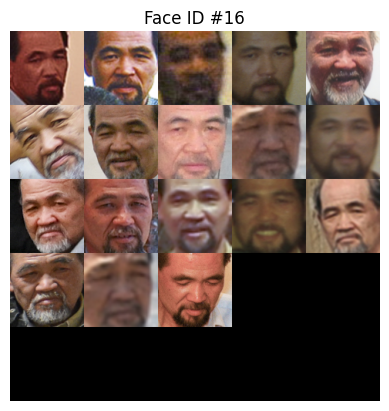

[INFO] Faces for face ID: 17


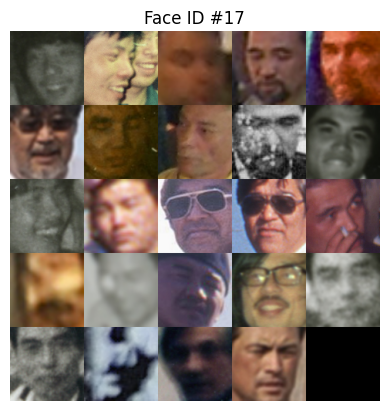

[INFO] Faces for face ID: 18


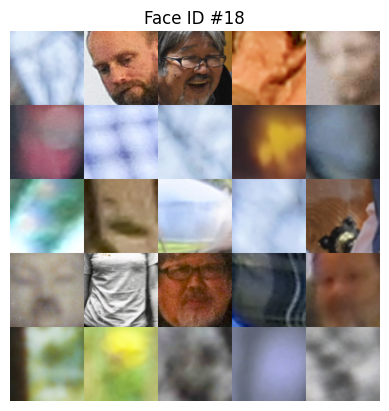

[INFO] Faces for face ID: 19


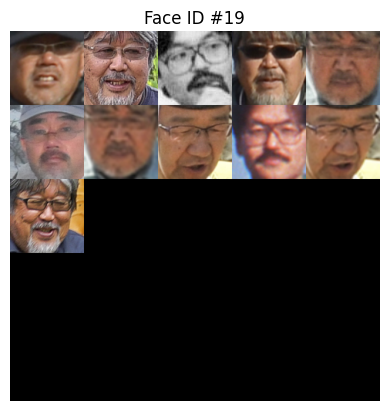

[INFO] Faces for face ID: 20


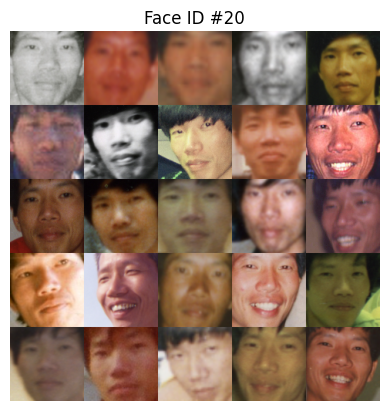

[INFO] Faces for face ID: 21


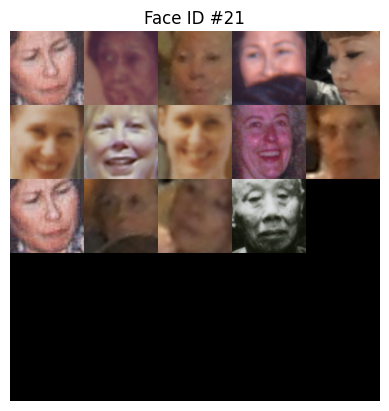

[INFO] Faces for face ID: 22


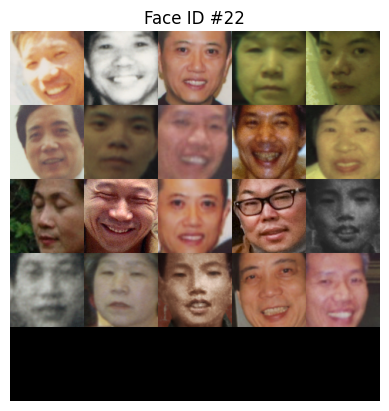

[INFO] Faces for face ID: 23


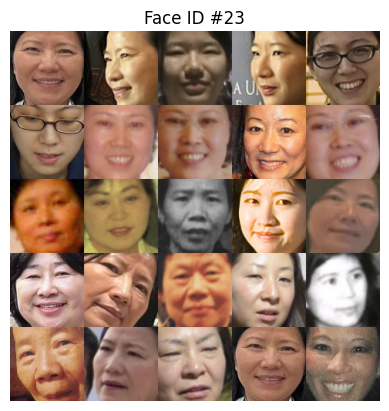

[INFO] Faces for face ID: 24


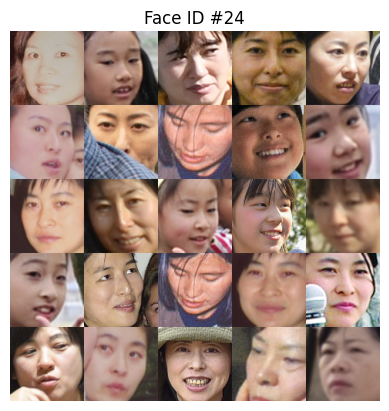

[INFO] Faces for face ID: 25


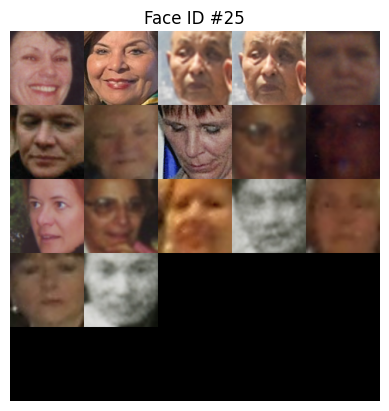

[INFO] Faces for face ID: 26


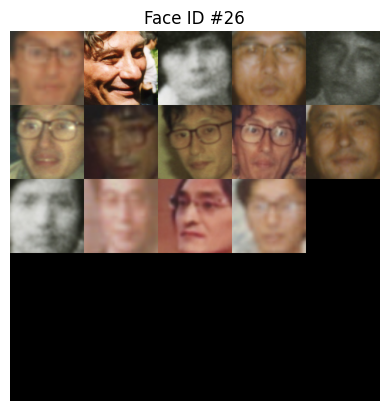

[INFO] Faces for face ID: 27


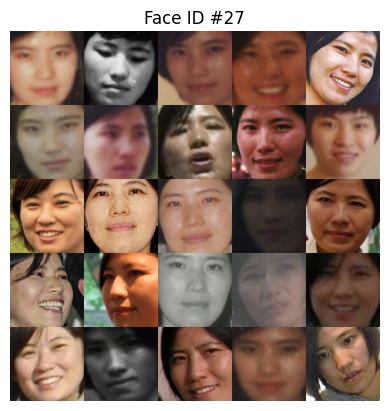

[INFO] Faces for face ID: 28


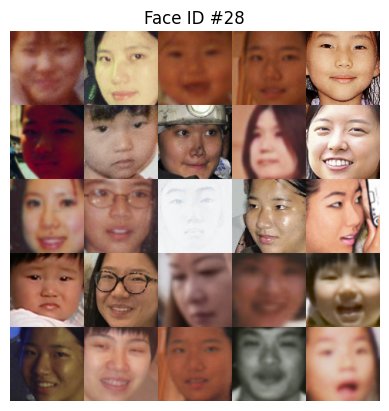

[INFO] Faces for face ID: 29


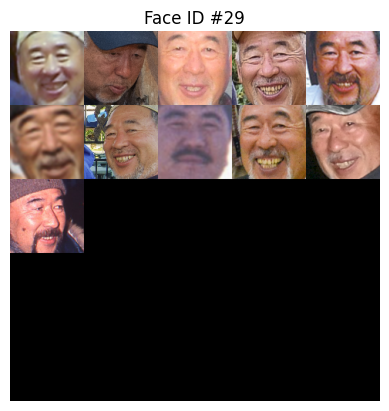

In [19]:

# Load data and encodings (make sure these are defined)
# For example: data = [{"imagePath": "path/to/image.jpg", "loc": (top, right, bottom, left)}, ...]
# encodings = np.array([...])

# Perform PCA to reduce dimensionality (you can adjust the number of components)
pca = PCA(n_components=12)
reduced_data = pca.fit_transform(encodings)

# Cluster the embeddings using AgglomerativeClustering
n_clusters = 30  # Set the desired number of clusters
clt = AgglomerativeClustering(n_clusters=n_clusters, metric='euclidean', linkage='ward')
clt.fit(reduced_data)

# Create a DataFrame to store clustering results
df = pd.DataFrame(columns=["image path", "encoding", "initial cluster", "secondary cluster", "person", 'loc'])

# Populate the DataFrame with initial clustering results
rows = []
for i, (encoding, label) in enumerate(zip(encodings, clt.labels_)):
    row = {
        "image path": data[i]["imagePath"],
        "encoding": encoding,
        "initial cluster": label,
        "secondary cluster": None,  # Will be filled during secondary clustering
        "person": None,  # Placeholder for manual labeling
        "loc": data[i]["loc"]
    }
    rows.append(row)

df = pd.concat([df, pd.DataFrame(rows)], ignore_index=True)

# Save initial cluster labels and reduced data for later use (if needed)
# np.save('initial_labels.npy', clt.labels_)
# np.save('reduced_data.npy', reduced_data)

# Determine the total number of unique faces found in the dataset
labelIDs = np.unique(clt.labels_)
numUniqueFaces = len(labelIDs)
print("[INFO] Number of unique faces: {}".format(numUniqueFaces))

# Loop over the unique face integers for visualization
for labelID in labelIDs:
    print("[INFO] Faces for face ID: {}".format(labelID))
    idxs = np.where(clt.labels_ == labelID)[0]
    idxs = np.random.choice(idxs, size=min(25, len(idxs)), replace=False)
    
    faces = []
    
    for i in idxs:
        image = cv2.imread(data[i]["imagePath"])
        (top, right, bottom, left) = data[i]["loc"]
        face = image[top:bottom, left:right]
        face = cv2.resize(face, (96, 96))
        faces.append(face)
    
    montage = build_montages(faces, (96, 96), (5, 5))[0]
    rgb_image = cv2.cvtColor(montage, cv2.COLOR_BGR2RGB)
    
    title = "Face ID #{}".format(labelID)
    plt.imshow(rgb_image)
    plt.title(title)
    plt.axis('off')
    plt.show()


In [20]:
df

,image path,encoding,initial cluster,secondary cluster,person,loc
0,dataset/1970s_D-10376.jpg,"[-0.1708115190267563, 0.13608162105083466, 0.0...",27,None,None,"(409, 884, 676, 617)"
1,dataset/Opening3_D-012870.jpg,"[-0.12119422852993011, 0.06642526388168335, 0....",7,None,None,"(2446, 2495, 2669, 2272)"
2,dataset/Opening3_D-012870.jpg,"[-0.1493520438671112, 0.0626177042722702, -0.0...",2,None,None,"(2310, 812, 2631, 491)"
3,dataset/Opening3_D-012870.jpg,"[-0.10438930988311768, 0.05997324734926224, 0....",5,None,None,"(2627, 1646, 2782, 1491)"
4,dataset/Opening3_D-012870.jpg,"[-0.16430115699768066, 0.03228508308529854, -0...",2,None,None,"(2050, 5913, 2272, 5690)"
...,...,...,...,...,...,...
984,dataset/D-191344_grandfather.jpg,"[-0.04460219293832779, 0.12104383111000061, 0....",0,None,None,"(1068, 2356, 2724, 700)"
985,dataset/2007-8_Beijing-friend-visit_1.tiff,"[-0.054153844714164734, 0.10568483173847198, 0...",23,None,None,"(368, 612, 497, 483)"
986,dataset/1988_WithTakamiAkihkoAndHuangrui_Bio_C...,"[-0.1454055905342102, 0.03945478796958923, 0.1...",26,None,None,"(999, 1429, 1128, 1300)"
987,dataset/1988_WithTakamiAkihkoAndHuangrui_Bio_C...,"[-0.21817828714847565, 0.029434405267238617, 0...",17,None,None,"(970, 1844, 1099, 1715)"


[INFO] Processing initial cluster 0...
[INFO] Number of faces in secondary cluster 0 within initial cluster 0: 13
[INFO] Number of faces in secondary cluster 1 within initial cluster 0: 12
[INFO] Number of faces in secondary cluster 2 within initial cluster 0: 6
[INFO] Number of faces in secondary cluster 3 within initial cluster 0: 5
[INFO] Number of faces in secondary cluster 4 within initial cluster 0: 6
[INFO] Number of faces in secondary cluster 5 within initial cluster 0: 3
[INFO] Number of faces in secondary cluster 6 within initial cluster 0: 7
[INFO] Number of faces in secondary cluster 7 within initial cluster 0: 4
[INFO] Number of faces in secondary cluster 8 within initial cluster 0: 4
[INFO] Number of faces in secondary cluster 9 within initial cluster 0: 3


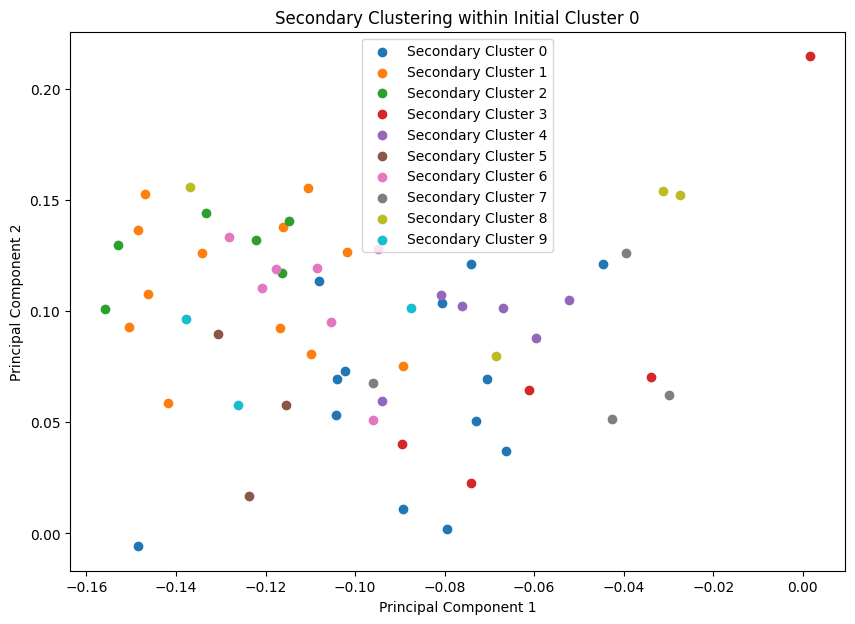

[INFO] Processing initial cluster 1...
[INFO] Number of faces in secondary cluster 0 within initial cluster 1: 6
[INFO] Number of faces in secondary cluster 1 within initial cluster 1: 1
[INFO] Number of faces in secondary cluster 2 within initial cluster 1: 2
[INFO] Number of faces in secondary cluster 3 within initial cluster 1: 1
[INFO] Number of faces in secondary cluster 4 within initial cluster 1: 1
[INFO] Number of faces in secondary cluster 5 within initial cluster 1: 1
[INFO] Number of faces in secondary cluster 6 within initial cluster 1: 1
[INFO] Number of faces in secondary cluster 7 within initial cluster 1: 1
[INFO] Number of faces in secondary cluster 8 within initial cluster 1: 1
[INFO] Number of faces in secondary cluster 9 within initial cluster 1: 1


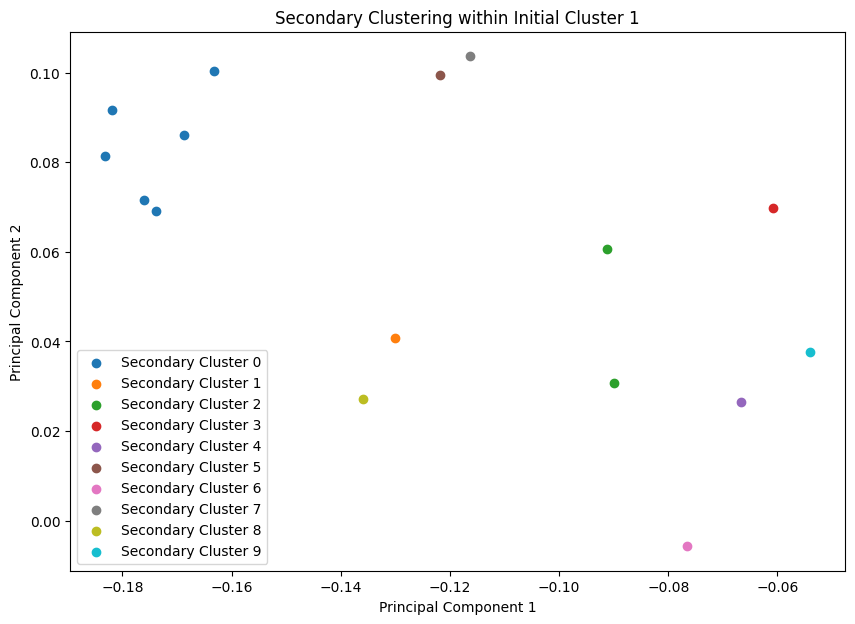

[INFO] Processing initial cluster 2...
[INFO] Number of faces in secondary cluster 0 within initial cluster 2: 5
[INFO] Number of faces in secondary cluster 1 within initial cluster 2: 4
[INFO] Number of faces in secondary cluster 2 within initial cluster 2: 3
[INFO] Number of faces in secondary cluster 3 within initial cluster 2: 3
[INFO] Number of faces in secondary cluster 4 within initial cluster 2: 4
[INFO] Number of faces in secondary cluster 5 within initial cluster 2: 3
[INFO] Number of faces in secondary cluster 6 within initial cluster 2: 7
[INFO] Number of faces in secondary cluster 7 within initial cluster 2: 4
[INFO] Number of faces in secondary cluster 8 within initial cluster 2: 1
[INFO] Number of faces in secondary cluster 9 within initial cluster 2: 2


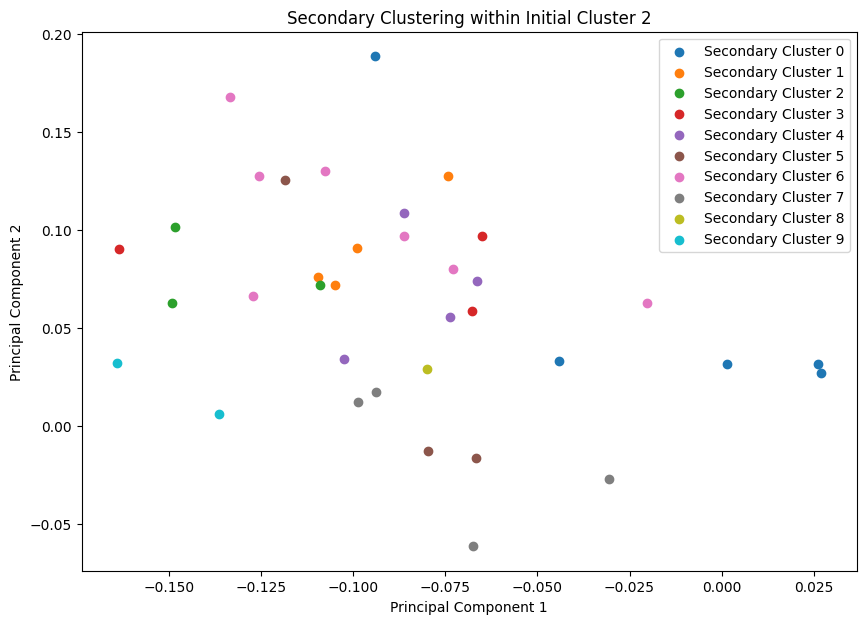

[INFO] Processing initial cluster 3...
[INFO] Number of faces in secondary cluster 0 within initial cluster 3: 8
[INFO] Number of faces in secondary cluster 1 within initial cluster 3: 5
[INFO] Number of faces in secondary cluster 2 within initial cluster 3: 4
[INFO] Number of faces in secondary cluster 3 within initial cluster 3: 3
[INFO] Number of faces in secondary cluster 4 within initial cluster 3: 3
[INFO] Number of faces in secondary cluster 5 within initial cluster 3: 6
[INFO] Number of faces in secondary cluster 6 within initial cluster 3: 3
[INFO] Number of faces in secondary cluster 7 within initial cluster 3: 2
[INFO] Number of faces in secondary cluster 8 within initial cluster 3: 2
[INFO] Number of faces in secondary cluster 9 within initial cluster 3: 1


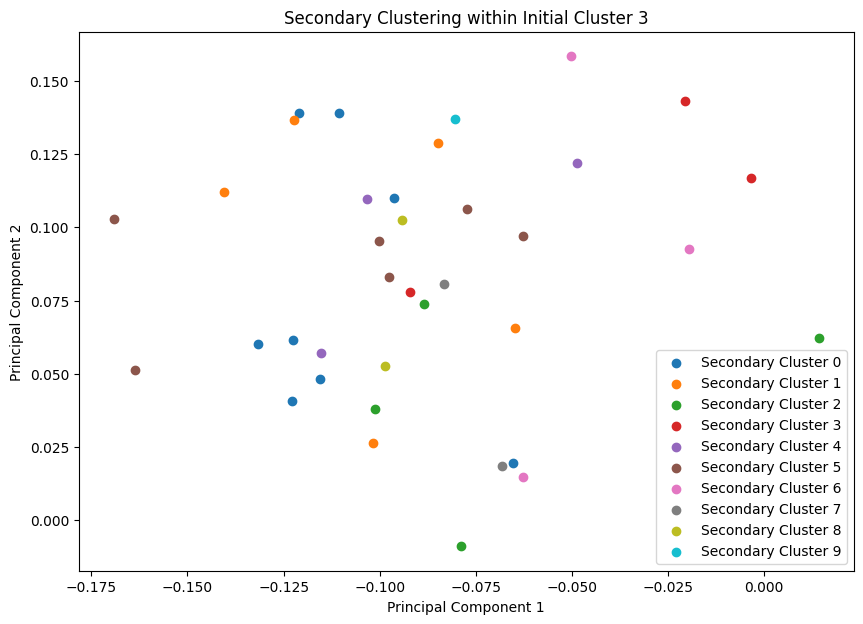

[INFO] Processing initial cluster 4...
[INFO] Number of faces in secondary cluster 0 within initial cluster 4: 6
[INFO] Number of faces in secondary cluster 1 within initial cluster 4: 4
[INFO] Number of faces in secondary cluster 2 within initial cluster 4: 5
[INFO] Number of faces in secondary cluster 3 within initial cluster 4: 3
[INFO] Number of faces in secondary cluster 4 within initial cluster 4: 3
[INFO] Number of faces in secondary cluster 5 within initial cluster 4: 3
[INFO] Number of faces in secondary cluster 6 within initial cluster 4: 3
[INFO] Number of faces in secondary cluster 7 within initial cluster 4: 2
[INFO] Number of faces in secondary cluster 8 within initial cluster 4: 3
[INFO] Number of faces in secondary cluster 9 within initial cluster 4: 2


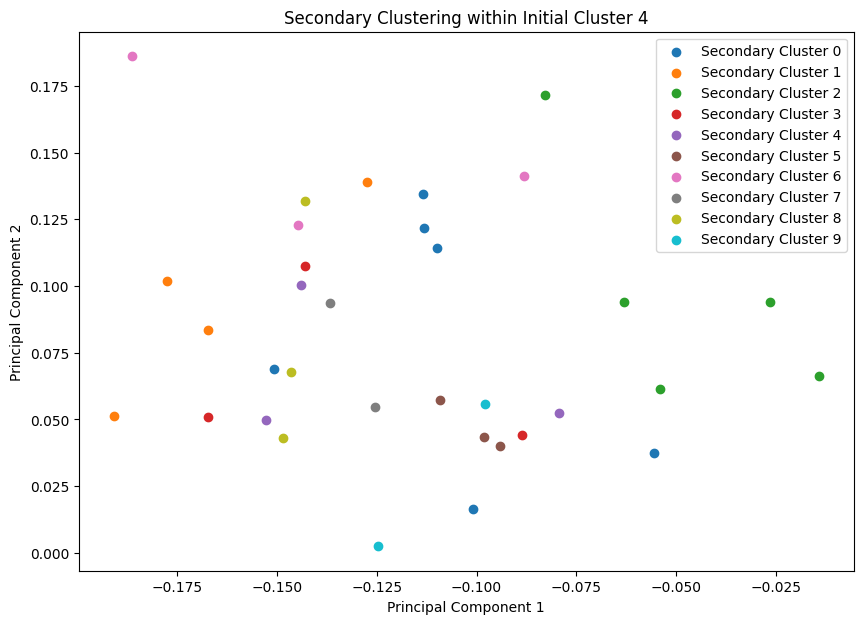

[INFO] Processing initial cluster 5...
[INFO] Number of faces in secondary cluster 0 within initial cluster 5: 4
[INFO] Number of faces in secondary cluster 1 within initial cluster 5: 5
[INFO] Number of faces in secondary cluster 2 within initial cluster 5: 5
[INFO] Number of faces in secondary cluster 3 within initial cluster 5: 3
[INFO] Number of faces in secondary cluster 4 within initial cluster 5: 5
[INFO] Number of faces in secondary cluster 5 within initial cluster 5: 2
[INFO] Number of faces in secondary cluster 6 within initial cluster 5: 3
[INFO] Number of faces in secondary cluster 7 within initial cluster 5: 2
[INFO] Number of faces in secondary cluster 8 within initial cluster 5: 1
[INFO] Number of faces in secondary cluster 9 within initial cluster 5: 1


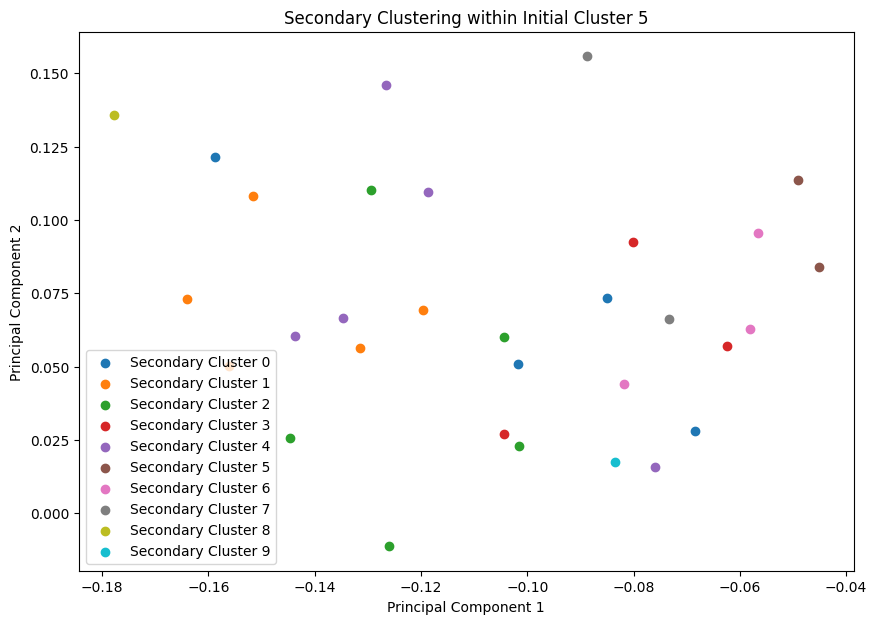

[INFO] Processing initial cluster 6...
[INFO] Number of faces in secondary cluster 0 within initial cluster 6: 7
[INFO] Number of faces in secondary cluster 1 within initial cluster 6: 3
[INFO] Number of faces in secondary cluster 2 within initial cluster 6: 6
[INFO] Number of faces in secondary cluster 3 within initial cluster 6: 2
[INFO] Number of faces in secondary cluster 4 within initial cluster 6: 2
[INFO] Number of faces in secondary cluster 5 within initial cluster 6: 6
[INFO] Number of faces in secondary cluster 6 within initial cluster 6: 5
[INFO] Number of faces in secondary cluster 7 within initial cluster 6: 1
[INFO] Number of faces in secondary cluster 8 within initial cluster 6: 4
[INFO] Number of faces in secondary cluster 9 within initial cluster 6: 1


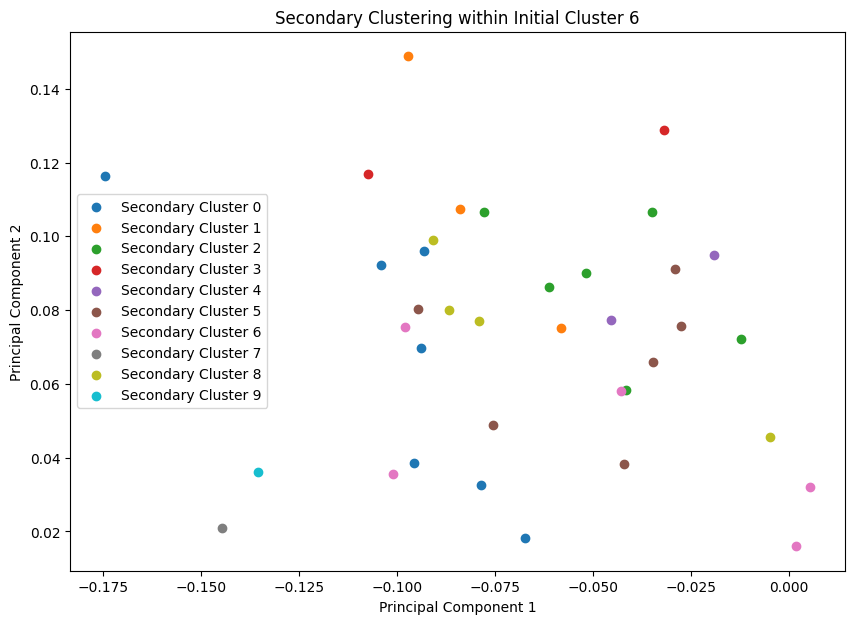

[INFO] Processing initial cluster 7...
[INFO] Number of faces in secondary cluster 0 within initial cluster 7: 4
[INFO] Number of faces in secondary cluster 1 within initial cluster 7: 4
[INFO] Number of faces in secondary cluster 2 within initial cluster 7: 3
[INFO] Number of faces in secondary cluster 3 within initial cluster 7: 2
[INFO] Number of faces in secondary cluster 4 within initial cluster 7: 3
[INFO] Number of faces in secondary cluster 5 within initial cluster 7: 6
[INFO] Number of faces in secondary cluster 6 within initial cluster 7: 3
[INFO] Number of faces in secondary cluster 7 within initial cluster 7: 2
[INFO] Number of faces in secondary cluster 8 within initial cluster 7: 2
[INFO] Number of faces in secondary cluster 9 within initial cluster 7: 2


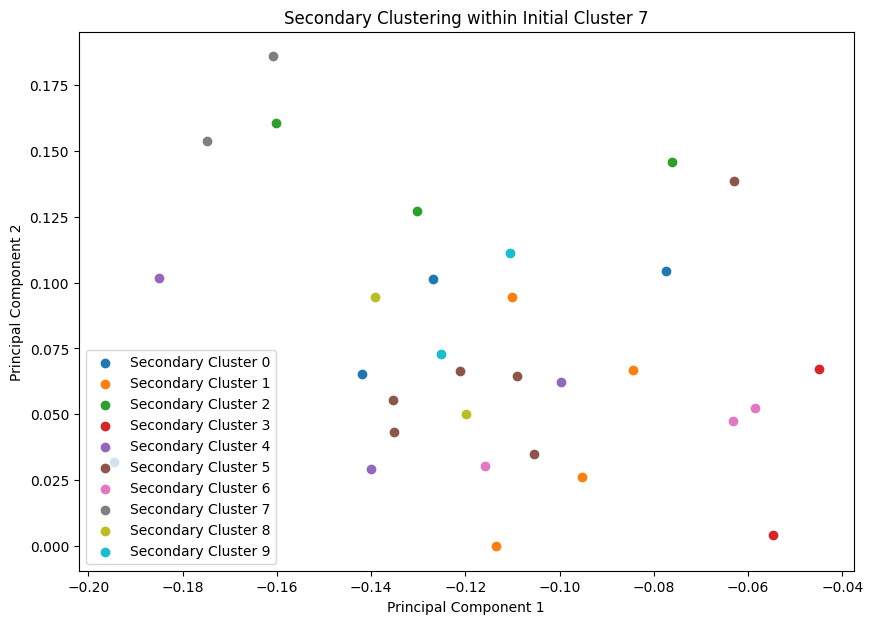

[INFO] Processing initial cluster 8...
[INFO] Number of faces in secondary cluster 0 within initial cluster 8: 11
[INFO] Number of faces in secondary cluster 1 within initial cluster 8: 6
[INFO] Number of faces in secondary cluster 2 within initial cluster 8: 4
[INFO] Number of faces in secondary cluster 3 within initial cluster 8: 2
[INFO] Number of faces in secondary cluster 4 within initial cluster 8: 5
[INFO] Number of faces in secondary cluster 5 within initial cluster 8: 3
[INFO] Number of faces in secondary cluster 6 within initial cluster 8: 5
[INFO] Number of faces in secondary cluster 7 within initial cluster 8: 2
[INFO] Number of faces in secondary cluster 8 within initial cluster 8: 2
[INFO] Number of faces in secondary cluster 9 within initial cluster 8: 2


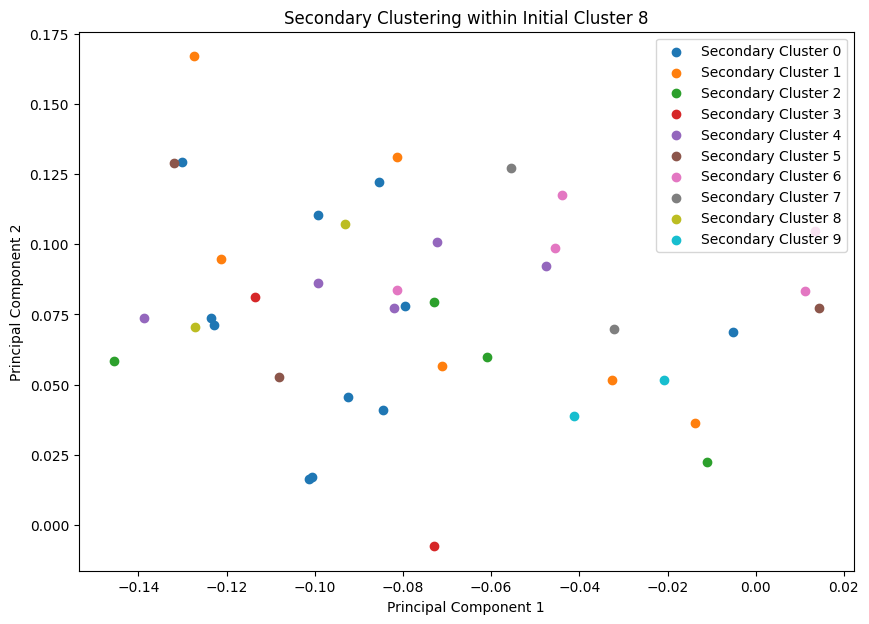

[INFO] Processing initial cluster 9...
[INFO] Number of faces in secondary cluster 0 within initial cluster 9: 6
[INFO] Number of faces in secondary cluster 1 within initial cluster 9: 5
[INFO] Number of faces in secondary cluster 2 within initial cluster 9: 4
[INFO] Number of faces in secondary cluster 3 within initial cluster 9: 2
[INFO] Number of faces in secondary cluster 4 within initial cluster 9: 4
[INFO] Number of faces in secondary cluster 5 within initial cluster 9: 3
[INFO] Number of faces in secondary cluster 6 within initial cluster 9: 1
[INFO] Number of faces in secondary cluster 7 within initial cluster 9: 2
[INFO] Number of faces in secondary cluster 8 within initial cluster 9: 1
[INFO] Number of faces in secondary cluster 9 within initial cluster 9: 1


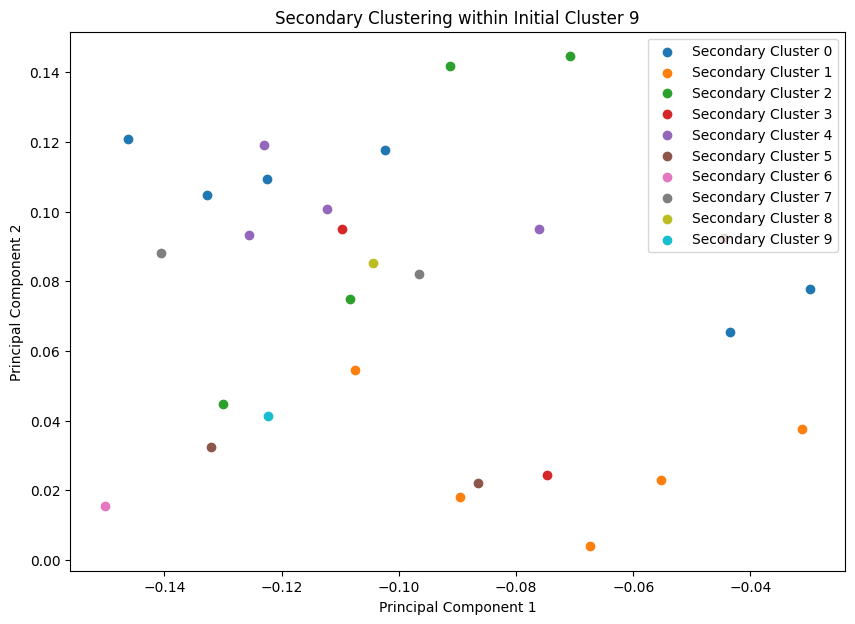

[INFO] Processing initial cluster 10...
[INFO] Number of faces in secondary cluster 0 within initial cluster 10: 7
[INFO] Number of faces in secondary cluster 1 within initial cluster 10: 5
[INFO] Number of faces in secondary cluster 2 within initial cluster 10: 4
[INFO] Number of faces in secondary cluster 3 within initial cluster 10: 5
[INFO] Number of faces in secondary cluster 4 within initial cluster 10: 3
[INFO] Number of faces in secondary cluster 5 within initial cluster 10: 3
[INFO] Number of faces in secondary cluster 6 within initial cluster 10: 2
[INFO] Number of faces in secondary cluster 7 within initial cluster 10: 5
[INFO] Number of faces in secondary cluster 8 within initial cluster 10: 4
[INFO] Number of faces in secondary cluster 9 within initial cluster 10: 2


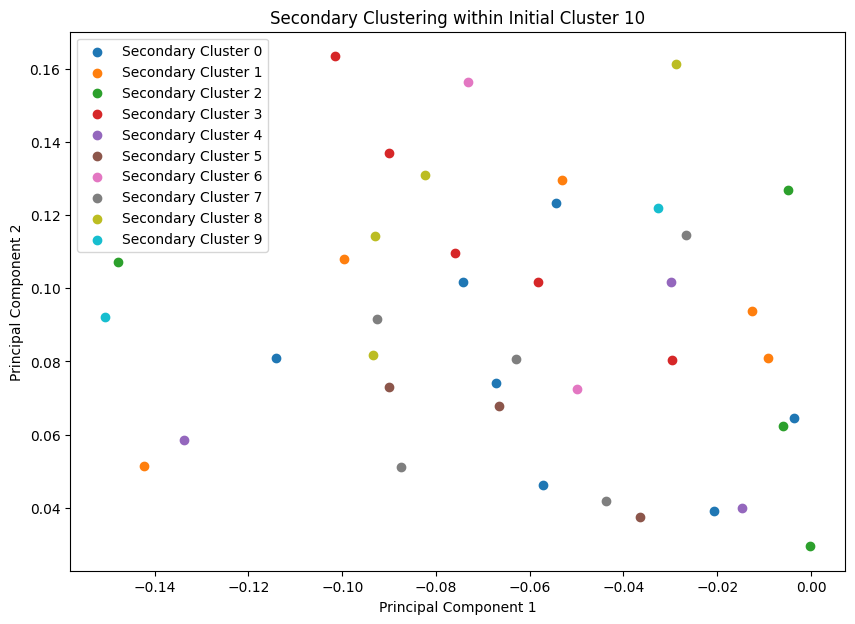

[INFO] Processing initial cluster 11...
[INFO] Number of faces in secondary cluster 0 within initial cluster 11: 33
[INFO] Number of faces in secondary cluster 1 within initial cluster 11: 5
[INFO] Number of faces in secondary cluster 2 within initial cluster 11: 12
[INFO] Number of faces in secondary cluster 3 within initial cluster 11: 10
[INFO] Number of faces in secondary cluster 4 within initial cluster 11: 4
[INFO] Number of faces in secondary cluster 5 within initial cluster 11: 18
[INFO] Number of faces in secondary cluster 6 within initial cluster 11: 12
[INFO] Number of faces in secondary cluster 7 within initial cluster 11: 9
[INFO] Number of faces in secondary cluster 8 within initial cluster 11: 6
[INFO] Number of faces in secondary cluster 9 within initial cluster 11: 7


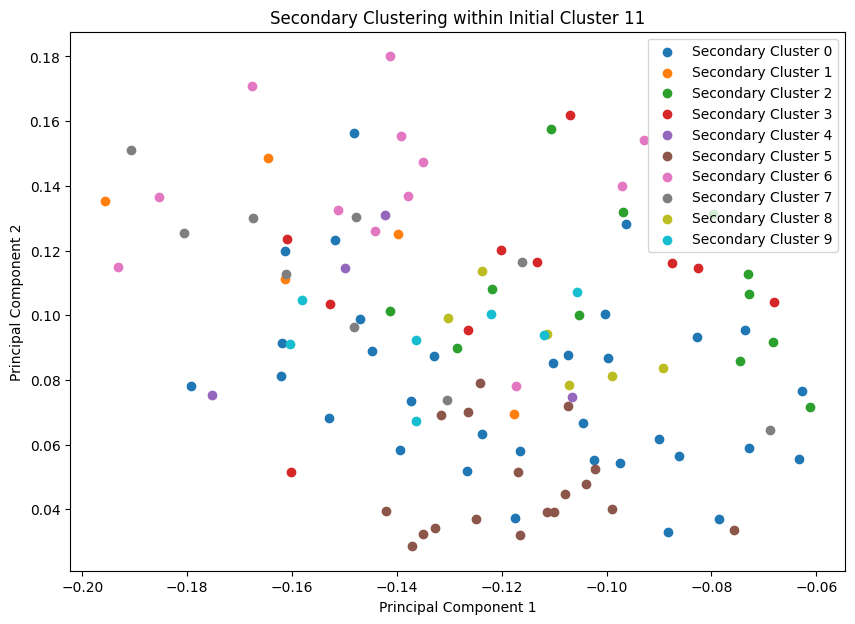

[INFO] Processing initial cluster 12...
[INFO] Number of faces in secondary cluster 0 within initial cluster 12: 6
[INFO] Number of faces in secondary cluster 1 within initial cluster 12: 2
[INFO] Number of faces in secondary cluster 2 within initial cluster 12: 5
[INFO] Number of faces in secondary cluster 3 within initial cluster 12: 3
[INFO] Number of faces in secondary cluster 4 within initial cluster 12: 4
[INFO] Number of faces in secondary cluster 5 within initial cluster 12: 2
[INFO] Number of faces in secondary cluster 6 within initial cluster 12: 3
[INFO] Number of faces in secondary cluster 7 within initial cluster 12: 1
[INFO] Number of faces in secondary cluster 8 within initial cluster 12: 7
[INFO] Number of faces in secondary cluster 9 within initial cluster 12: 2


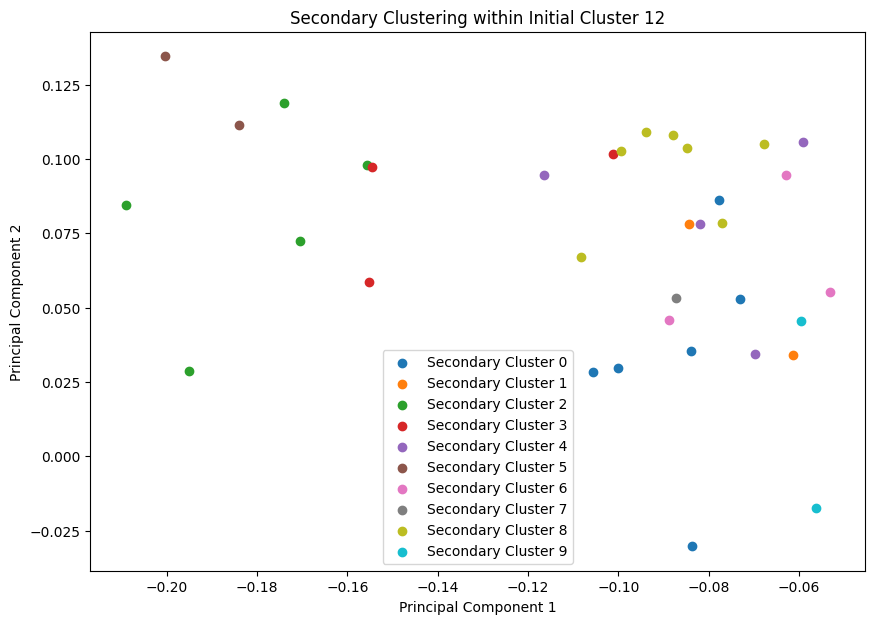

[INFO] Processing initial cluster 13...
[INFO] Number of faces in secondary cluster 0 within initial cluster 13: 4
[INFO] Number of faces in secondary cluster 1 within initial cluster 13: 3
[INFO] Number of faces in secondary cluster 2 within initial cluster 13: 2
[INFO] Number of faces in secondary cluster 3 within initial cluster 13: 2
[INFO] Number of faces in secondary cluster 4 within initial cluster 13: 2
[INFO] Number of faces in secondary cluster 5 within initial cluster 13: 3
[INFO] Number of faces in secondary cluster 6 within initial cluster 13: 1
[INFO] Number of faces in secondary cluster 7 within initial cluster 13: 2
[INFO] Number of faces in secondary cluster 8 within initial cluster 13: 1
[INFO] Number of faces in secondary cluster 9 within initial cluster 13: 1


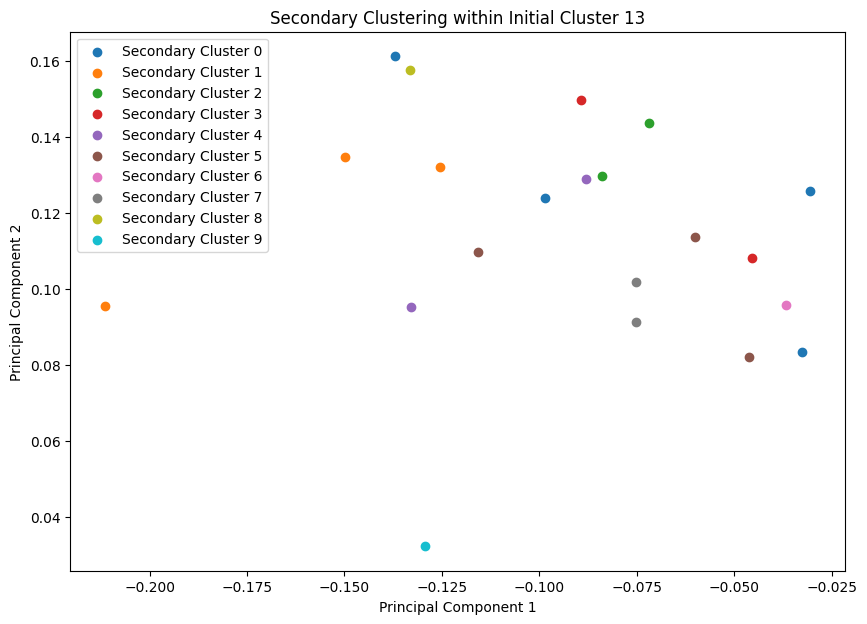

[INFO] Processing initial cluster 14...
[INFO] Number of faces in secondary cluster 0 within initial cluster 14: 5
[INFO] Number of faces in secondary cluster 1 within initial cluster 14: 7
[INFO] Number of faces in secondary cluster 2 within initial cluster 14: 6
[INFO] Number of faces in secondary cluster 3 within initial cluster 14: 3
[INFO] Number of faces in secondary cluster 4 within initial cluster 14: 2
[INFO] Number of faces in secondary cluster 5 within initial cluster 14: 2
[INFO] Number of faces in secondary cluster 6 within initial cluster 14: 2
[INFO] Number of faces in secondary cluster 7 within initial cluster 14: 2
[INFO] Number of faces in secondary cluster 8 within initial cluster 14: 5
[INFO] Number of faces in secondary cluster 9 within initial cluster 14: 4


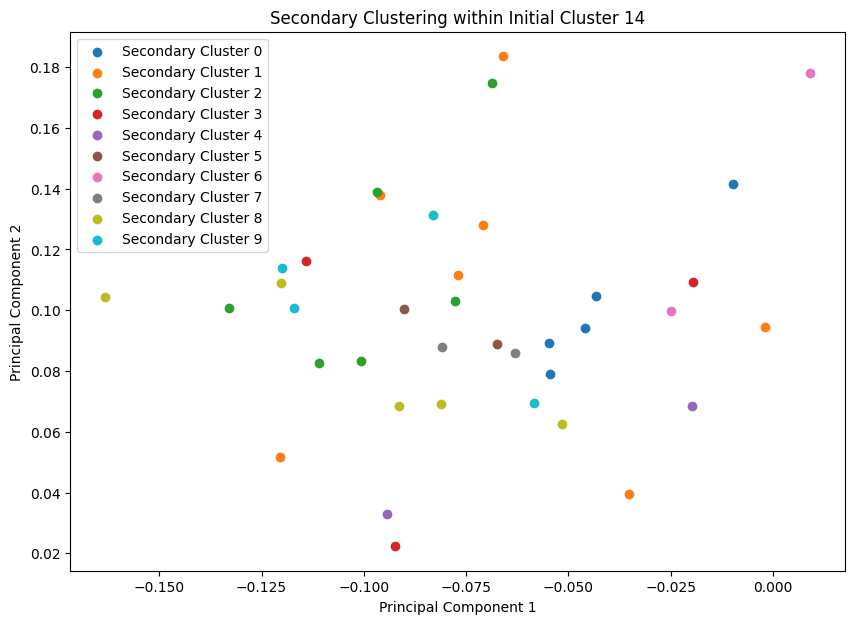

[INFO] Processing initial cluster 15...
[INFO] Number of faces in secondary cluster 0 within initial cluster 15: 4
[INFO] Number of faces in secondary cluster 1 within initial cluster 15: 2
[INFO] Number of faces in secondary cluster 2 within initial cluster 15: 3
[INFO] Number of faces in secondary cluster 3 within initial cluster 15: 4
[INFO] Number of faces in secondary cluster 4 within initial cluster 15: 2
[INFO] Number of faces in secondary cluster 5 within initial cluster 15: 1
[INFO] Number of faces in secondary cluster 6 within initial cluster 15: 1
[INFO] Number of faces in secondary cluster 7 within initial cluster 15: 1
[INFO] Number of faces in secondary cluster 8 within initial cluster 15: 1
[INFO] Number of faces in secondary cluster 9 within initial cluster 15: 2


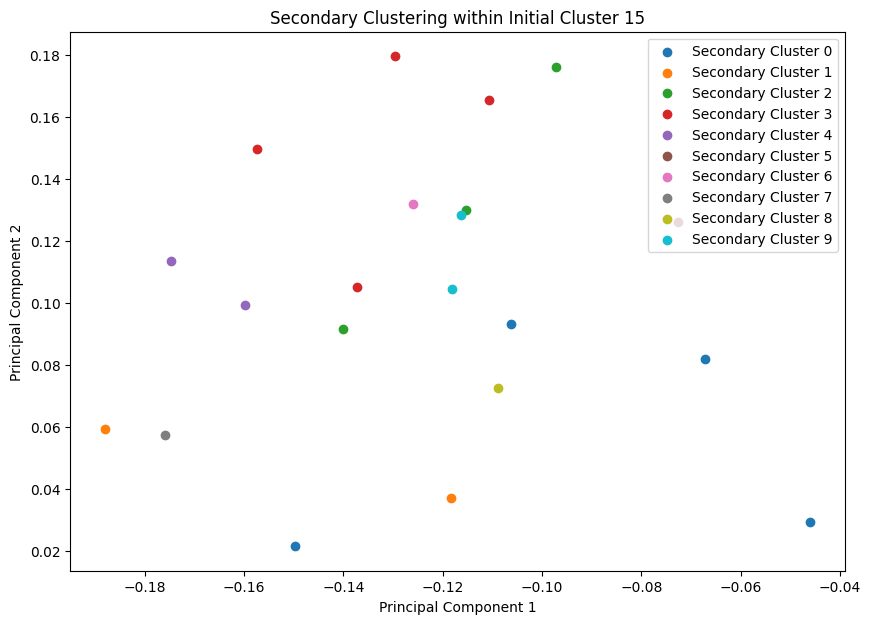

[INFO] Processing initial cluster 16...
[INFO] Number of faces in secondary cluster 0 within initial cluster 16: 2
[INFO] Number of faces in secondary cluster 1 within initial cluster 16: 3
[INFO] Number of faces in secondary cluster 2 within initial cluster 16: 1
[INFO] Number of faces in secondary cluster 3 within initial cluster 16: 3
[INFO] Number of faces in secondary cluster 4 within initial cluster 16: 2
[INFO] Number of faces in secondary cluster 5 within initial cluster 16: 1
[INFO] Number of faces in secondary cluster 6 within initial cluster 16: 1
[INFO] Number of faces in secondary cluster 7 within initial cluster 16: 3
[INFO] Number of faces in secondary cluster 8 within initial cluster 16: 1
[INFO] Number of faces in secondary cluster 9 within initial cluster 16: 1


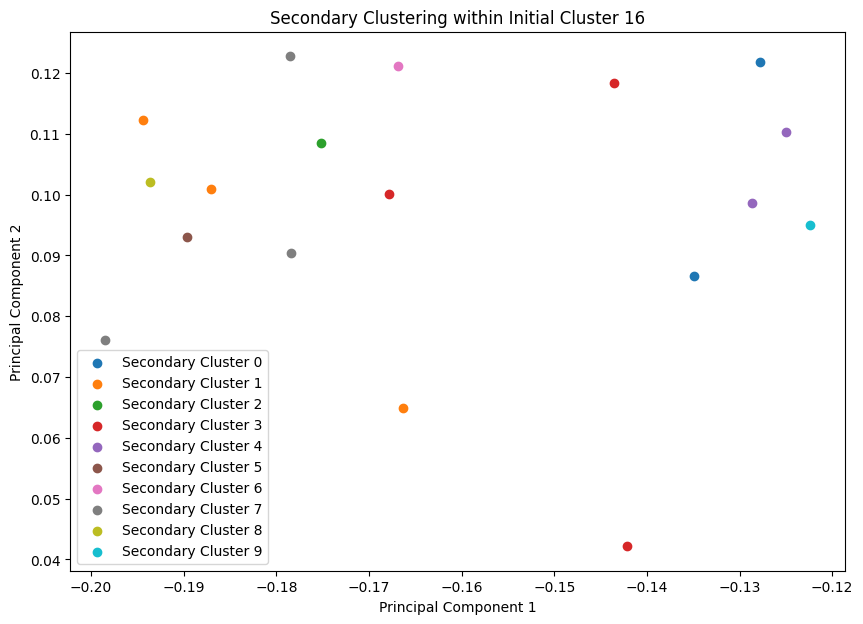

[INFO] Processing initial cluster 17...
[INFO] Number of faces in secondary cluster 0 within initial cluster 17: 3
[INFO] Number of faces in secondary cluster 1 within initial cluster 17: 3
[INFO] Number of faces in secondary cluster 2 within initial cluster 17: 4
[INFO] Number of faces in secondary cluster 3 within initial cluster 17: 4
[INFO] Number of faces in secondary cluster 4 within initial cluster 17: 2
[INFO] Number of faces in secondary cluster 5 within initial cluster 17: 3
[INFO] Number of faces in secondary cluster 6 within initial cluster 17: 1
[INFO] Number of faces in secondary cluster 7 within initial cluster 17: 2
[INFO] Number of faces in secondary cluster 8 within initial cluster 17: 1
[INFO] Number of faces in secondary cluster 9 within initial cluster 17: 1


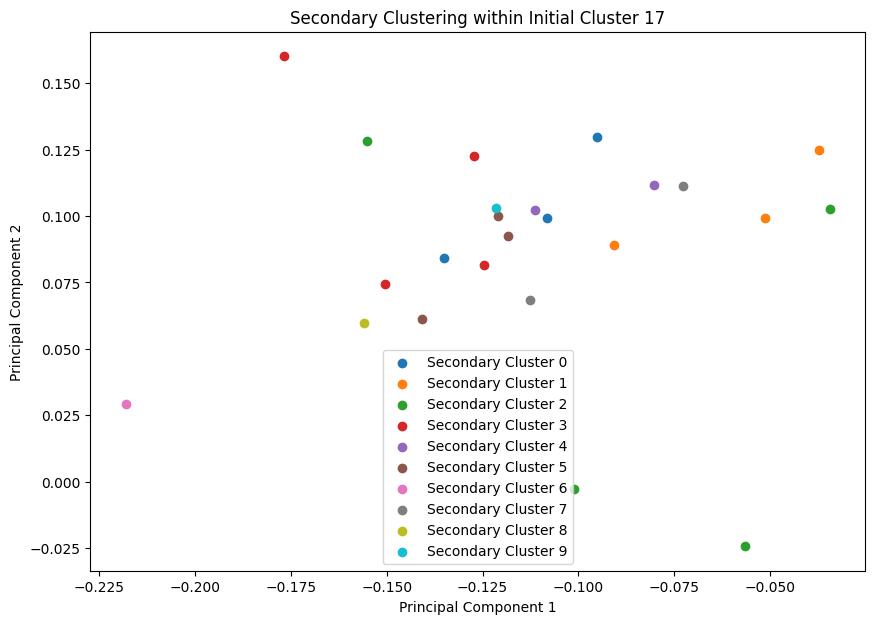

[INFO] Processing initial cluster 18...
[INFO] Number of faces in secondary cluster 0 within initial cluster 18: 4
[INFO] Number of faces in secondary cluster 1 within initial cluster 18: 5
[INFO] Number of faces in secondary cluster 2 within initial cluster 18: 2
[INFO] Number of faces in secondary cluster 3 within initial cluster 18: 3
[INFO] Number of faces in secondary cluster 4 within initial cluster 18: 3
[INFO] Number of faces in secondary cluster 5 within initial cluster 18: 4
[INFO] Number of faces in secondary cluster 6 within initial cluster 18: 1
[INFO] Number of faces in secondary cluster 7 within initial cluster 18: 1
[INFO] Number of faces in secondary cluster 8 within initial cluster 18: 4
[INFO] Number of faces in secondary cluster 9 within initial cluster 18: 2


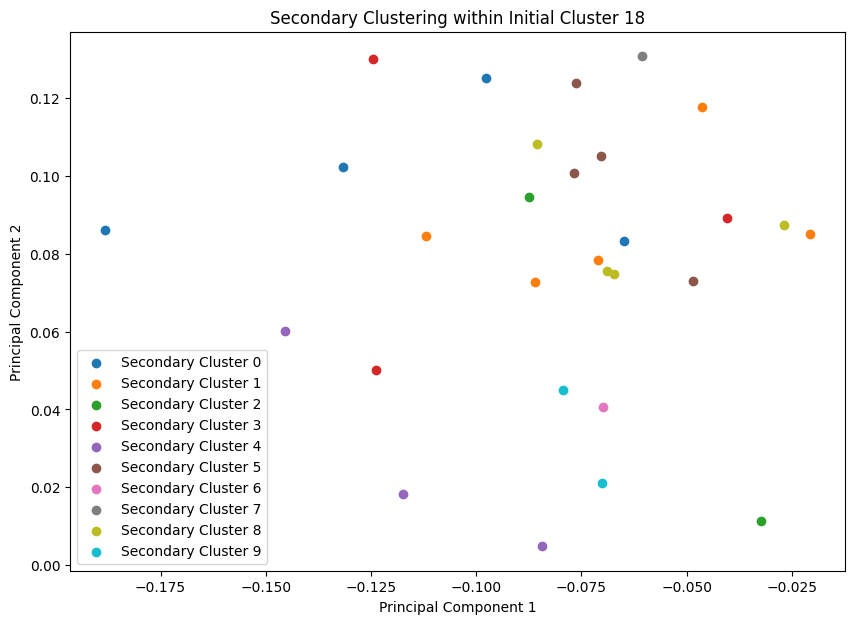

[INFO] Processing initial cluster 19...
[INFO] Number of faces in secondary cluster 0 within initial cluster 19: 2
[INFO] Number of faces in secondary cluster 1 within initial cluster 19: 1
[INFO] Number of faces in secondary cluster 2 within initial cluster 19: 1
[INFO] Number of faces in secondary cluster 3 within initial cluster 19: 1
[INFO] Number of faces in secondary cluster 4 within initial cluster 19: 1
[INFO] Number of faces in secondary cluster 5 within initial cluster 19: 1
[INFO] Number of faces in secondary cluster 6 within initial cluster 19: 1
[INFO] Number of faces in secondary cluster 7 within initial cluster 19: 1
[INFO] Number of faces in secondary cluster 8 within initial cluster 19: 1
[INFO] Number of faces in secondary cluster 9 within initial cluster 19: 1


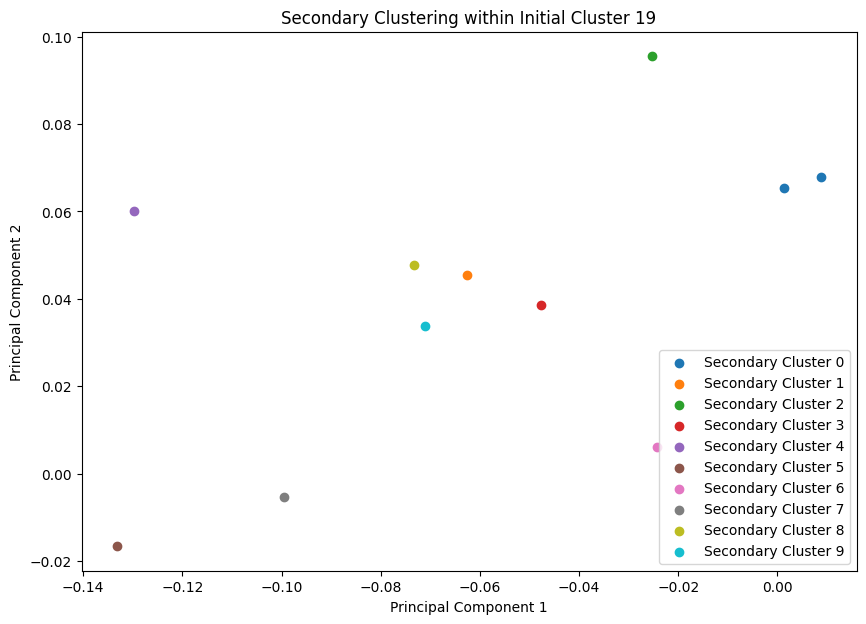

[INFO] Processing initial cluster 20...
[INFO] Number of faces in secondary cluster 0 within initial cluster 20: 14
[INFO] Number of faces in secondary cluster 1 within initial cluster 20: 5
[INFO] Number of faces in secondary cluster 2 within initial cluster 20: 3
[INFO] Number of faces in secondary cluster 3 within initial cluster 20: 4
[INFO] Number of faces in secondary cluster 4 within initial cluster 20: 8
[INFO] Number of faces in secondary cluster 5 within initial cluster 20: 2
[INFO] Number of faces in secondary cluster 6 within initial cluster 20: 2
[INFO] Number of faces in secondary cluster 7 within initial cluster 20: 2
[INFO] Number of faces in secondary cluster 8 within initial cluster 20: 3
[INFO] Number of faces in secondary cluster 9 within initial cluster 20: 2


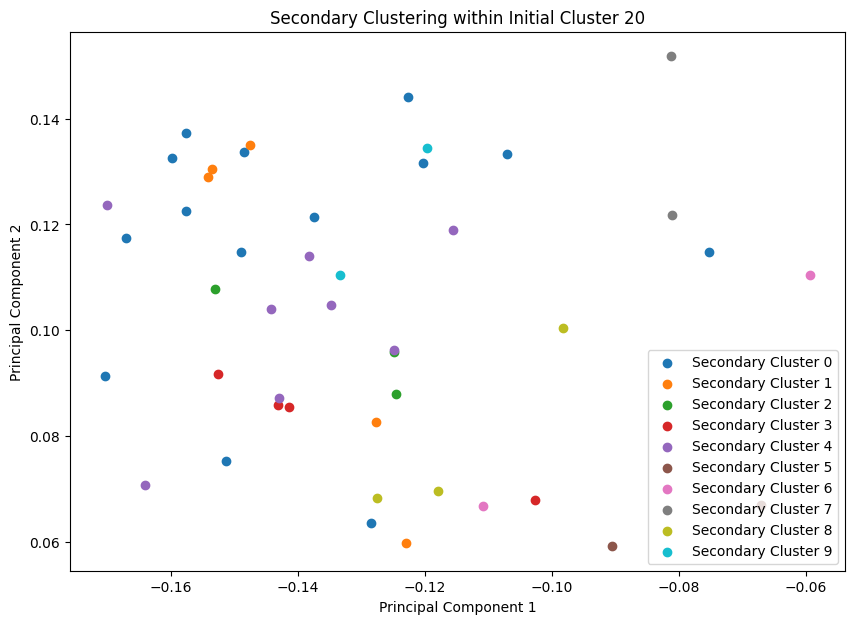

[INFO] Processing initial cluster 21...
[INFO] Number of faces in secondary cluster 0 within initial cluster 21: 2
[INFO] Number of faces in secondary cluster 1 within initial cluster 21: 2
[INFO] Number of faces in secondary cluster 2 within initial cluster 21: 2
[INFO] Number of faces in secondary cluster 3 within initial cluster 21: 2
[INFO] Number of faces in secondary cluster 4 within initial cluster 21: 1
[INFO] Number of faces in secondary cluster 5 within initial cluster 21: 1
[INFO] Number of faces in secondary cluster 6 within initial cluster 21: 1
[INFO] Number of faces in secondary cluster 7 within initial cluster 21: 1
[INFO] Number of faces in secondary cluster 8 within initial cluster 21: 1
[INFO] Number of faces in secondary cluster 9 within initial cluster 21: 1


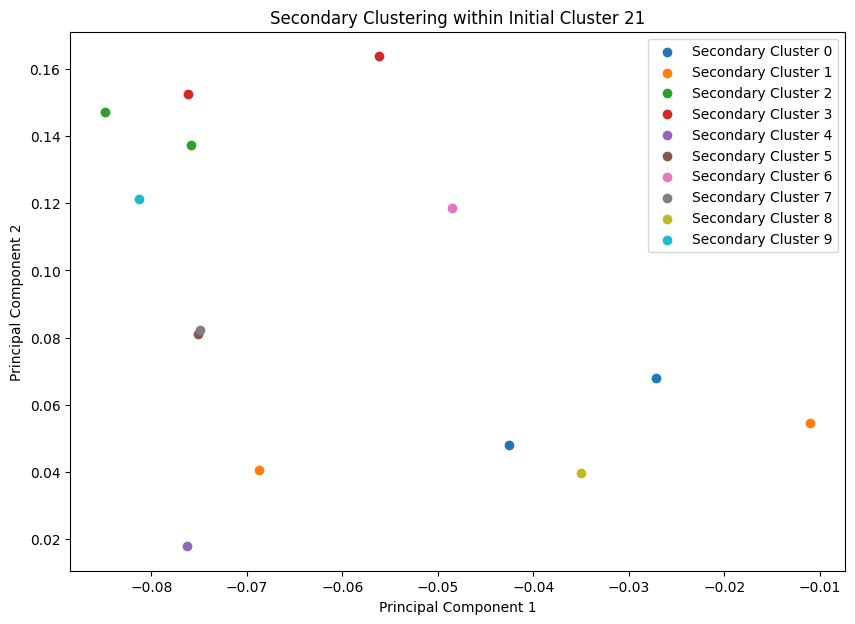

[INFO] Processing initial cluster 22...
[INFO] Number of faces in secondary cluster 0 within initial cluster 22: 5
[INFO] Number of faces in secondary cluster 1 within initial cluster 22: 2
[INFO] Number of faces in secondary cluster 2 within initial cluster 22: 3
[INFO] Number of faces in secondary cluster 3 within initial cluster 22: 2
[INFO] Number of faces in secondary cluster 4 within initial cluster 22: 2
[INFO] Number of faces in secondary cluster 5 within initial cluster 22: 2
[INFO] Number of faces in secondary cluster 6 within initial cluster 22: 1
[INFO] Number of faces in secondary cluster 7 within initial cluster 22: 1
[INFO] Number of faces in secondary cluster 8 within initial cluster 22: 1
[INFO] Number of faces in secondary cluster 9 within initial cluster 22: 1


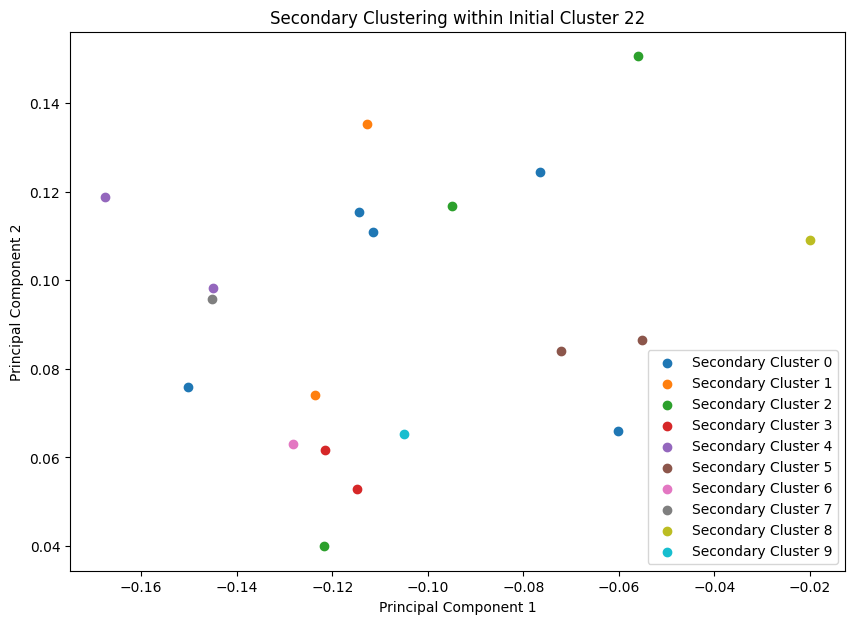

[INFO] Processing initial cluster 23...
[INFO] Number of faces in secondary cluster 0 within initial cluster 23: 7
[INFO] Number of faces in secondary cluster 1 within initial cluster 23: 4
[INFO] Number of faces in secondary cluster 2 within initial cluster 23: 2
[INFO] Number of faces in secondary cluster 3 within initial cluster 23: 4
[INFO] Number of faces in secondary cluster 4 within initial cluster 23: 2
[INFO] Number of faces in secondary cluster 5 within initial cluster 23: 4
[INFO] Number of faces in secondary cluster 6 within initial cluster 23: 8
[INFO] Number of faces in secondary cluster 7 within initial cluster 23: 6
[INFO] Number of faces in secondary cluster 8 within initial cluster 23: 3
[INFO] Number of faces in secondary cluster 9 within initial cluster 23: 5


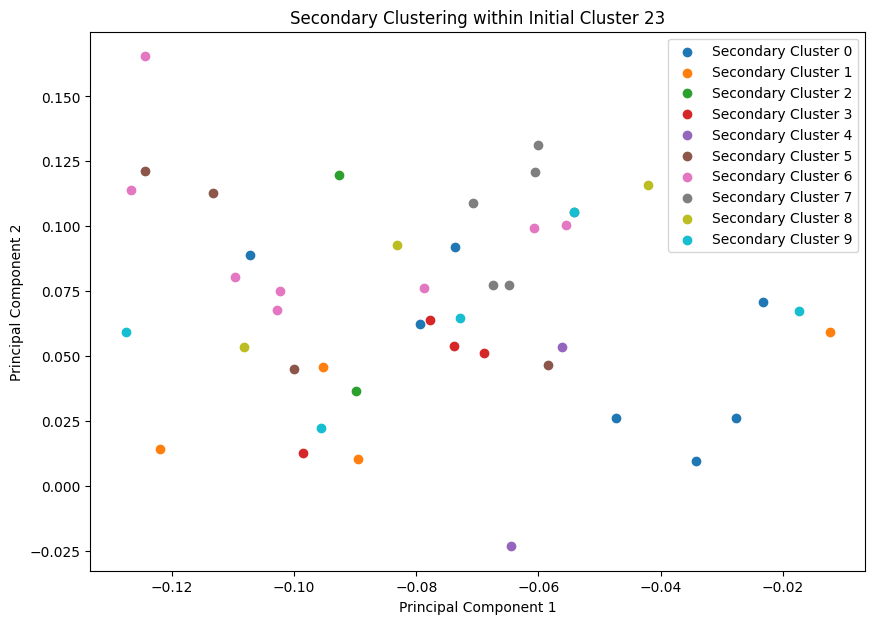

[INFO] Processing initial cluster 24...
[INFO] Number of faces in secondary cluster 0 within initial cluster 24: 2
[INFO] Number of faces in secondary cluster 1 within initial cluster 24: 5
[INFO] Number of faces in secondary cluster 2 within initial cluster 24: 4
[INFO] Number of faces in secondary cluster 3 within initial cluster 24: 3
[INFO] Number of faces in secondary cluster 4 within initial cluster 24: 4
[INFO] Number of faces in secondary cluster 5 within initial cluster 24: 2
[INFO] Number of faces in secondary cluster 6 within initial cluster 24: 2
[INFO] Number of faces in secondary cluster 7 within initial cluster 24: 1
[INFO] Number of faces in secondary cluster 8 within initial cluster 24: 1
[INFO] Number of faces in secondary cluster 9 within initial cluster 24: 5


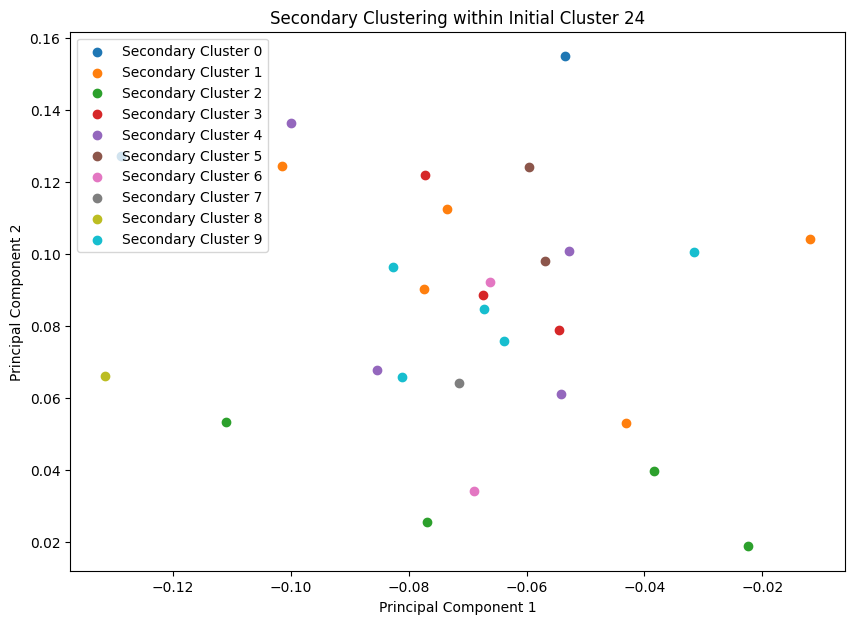

[INFO] Processing initial cluster 25...
[INFO] Number of faces in secondary cluster 0 within initial cluster 25: 3
[INFO] Number of faces in secondary cluster 1 within initial cluster 25: 2
[INFO] Number of faces in secondary cluster 2 within initial cluster 25: 2
[INFO] Number of faces in secondary cluster 3 within initial cluster 25: 2
[INFO] Number of faces in secondary cluster 4 within initial cluster 25: 2
[INFO] Number of faces in secondary cluster 5 within initial cluster 25: 1
[INFO] Number of faces in secondary cluster 6 within initial cluster 25: 1
[INFO] Number of faces in secondary cluster 7 within initial cluster 25: 1
[INFO] Number of faces in secondary cluster 8 within initial cluster 25: 2
[INFO] Number of faces in secondary cluster 9 within initial cluster 25: 1


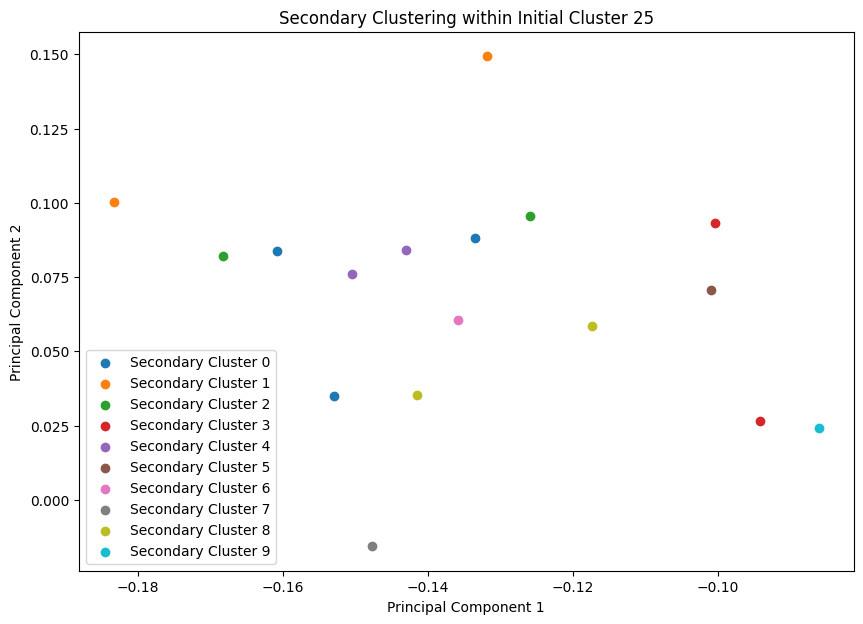

[INFO] Processing initial cluster 26...
[INFO] Number of faces in secondary cluster 0 within initial cluster 26: 3
[INFO] Number of faces in secondary cluster 1 within initial cluster 26: 3
[INFO] Number of faces in secondary cluster 2 within initial cluster 26: 1
[INFO] Number of faces in secondary cluster 3 within initial cluster 26: 1
[INFO] Number of faces in secondary cluster 4 within initial cluster 26: 1
[INFO] Number of faces in secondary cluster 5 within initial cluster 26: 1
[INFO] Number of faces in secondary cluster 6 within initial cluster 26: 1
[INFO] Number of faces in secondary cluster 7 within initial cluster 26: 1
[INFO] Number of faces in secondary cluster 8 within initial cluster 26: 1
[INFO] Number of faces in secondary cluster 9 within initial cluster 26: 1


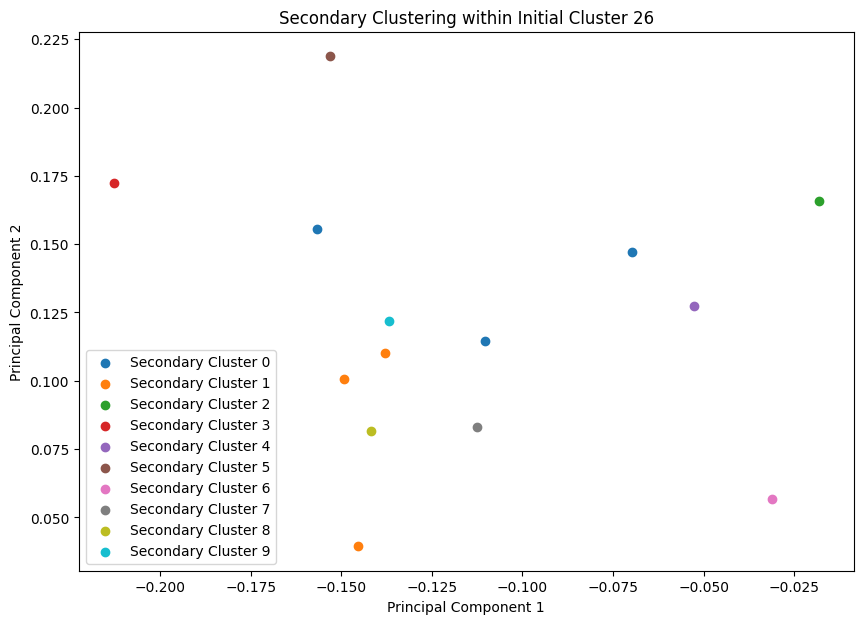

[INFO] Processing initial cluster 27...
[INFO] Number of faces in secondary cluster 0 within initial cluster 27: 5
[INFO] Number of faces in secondary cluster 1 within initial cluster 27: 5
[INFO] Number of faces in secondary cluster 2 within initial cluster 27: 7
[INFO] Number of faces in secondary cluster 3 within initial cluster 27: 3
[INFO] Number of faces in secondary cluster 4 within initial cluster 27: 5
[INFO] Number of faces in secondary cluster 5 within initial cluster 27: 8
[INFO] Number of faces in secondary cluster 6 within initial cluster 27: 7
[INFO] Number of faces in secondary cluster 7 within initial cluster 27: 2
[INFO] Number of faces in secondary cluster 8 within initial cluster 27: 2
[INFO] Number of faces in secondary cluster 9 within initial cluster 27: 2


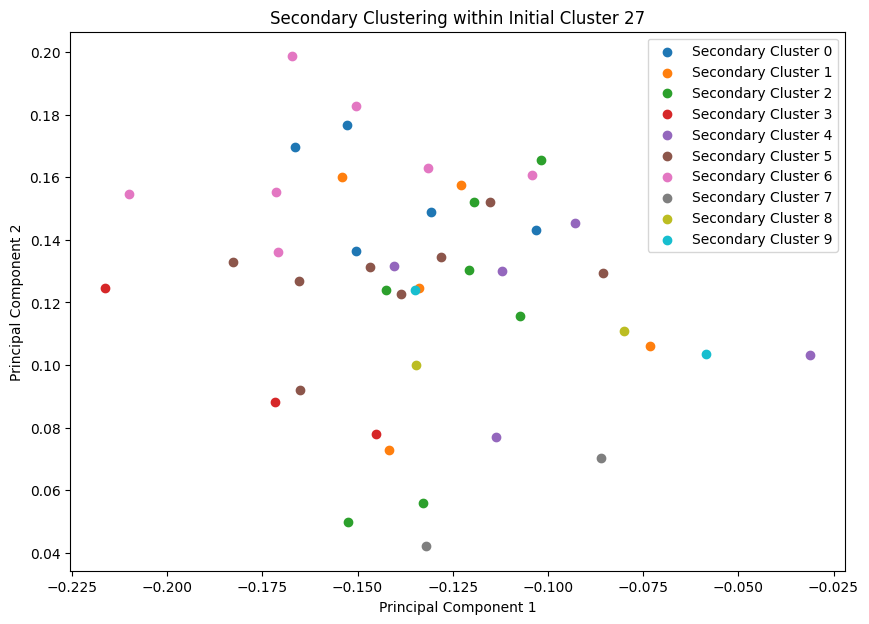

[INFO] Processing initial cluster 28...
[INFO] Number of faces in secondary cluster 0 within initial cluster 28: 8
[INFO] Number of faces in secondary cluster 1 within initial cluster 28: 5
[INFO] Number of faces in secondary cluster 2 within initial cluster 28: 5
[INFO] Number of faces in secondary cluster 3 within initial cluster 28: 3
[INFO] Number of faces in secondary cluster 4 within initial cluster 28: 4
[INFO] Number of faces in secondary cluster 5 within initial cluster 28: 2
[INFO] Number of faces in secondary cluster 6 within initial cluster 28: 1
[INFO] Number of faces in secondary cluster 7 within initial cluster 28: 2
[INFO] Number of faces in secondary cluster 8 within initial cluster 28: 6
[INFO] Number of faces in secondary cluster 9 within initial cluster 28: 3


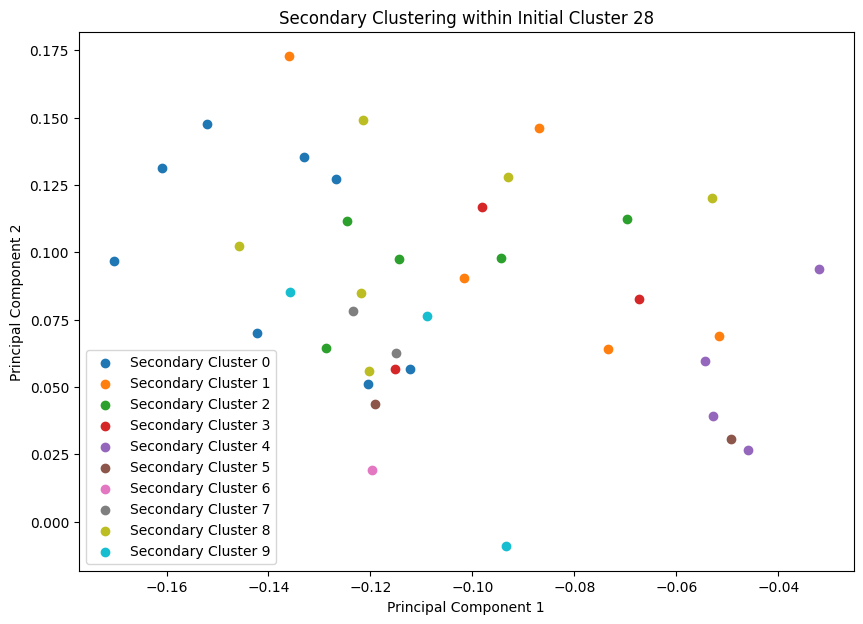

[INFO] Processing initial cluster 29...
[INFO] Number of faces in secondary cluster 0 within initial cluster 29: 2
[INFO] Number of faces in secondary cluster 1 within initial cluster 29: 1
[INFO] Number of faces in secondary cluster 2 within initial cluster 29: 1
[INFO] Number of faces in secondary cluster 3 within initial cluster 29: 1
[INFO] Number of faces in secondary cluster 4 within initial cluster 29: 1
[INFO] Number of faces in secondary cluster 5 within initial cluster 29: 1
[INFO] Number of faces in secondary cluster 6 within initial cluster 29: 1
[INFO] Number of faces in secondary cluster 7 within initial cluster 29: 1
[INFO] Number of faces in secondary cluster 8 within initial cluster 29: 1
[INFO] Number of faces in secondary cluster 9 within initial cluster 29: 1


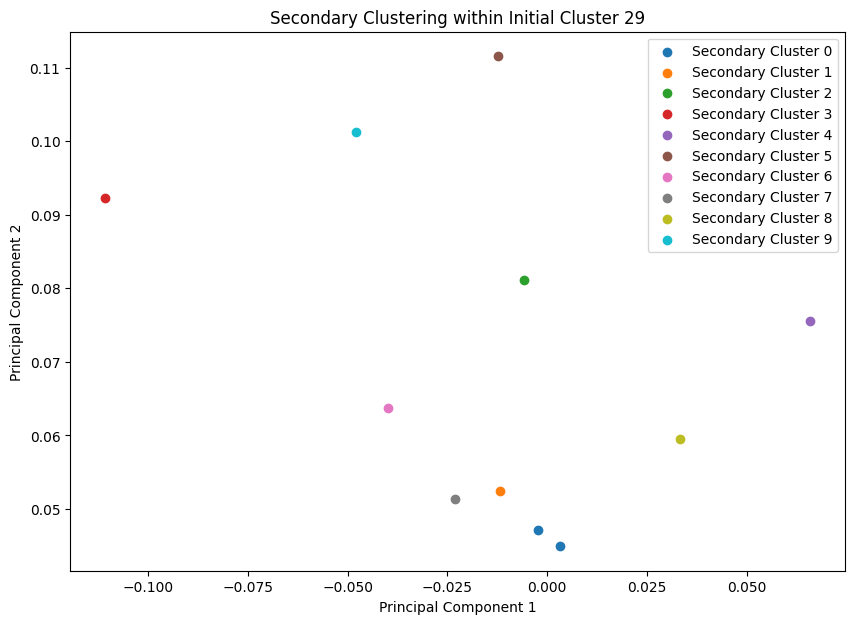

Secondary Cluster counts:
[INFO] Secondary clusters within initial cluster 0:
Secondary Cluster 0: 13 faces
Secondary Cluster 1: 12 faces
Secondary Cluster 2: 6 faces
Secondary Cluster 3: 5 faces
Secondary Cluster 4: 6 faces
Secondary Cluster 5: 3 faces
Secondary Cluster 6: 7 faces
Secondary Cluster 7: 4 faces
Secondary Cluster 8: 4 faces
Secondary Cluster 9: 3 faces
[INFO] Secondary clusters within initial cluster 1:
Secondary Cluster 0: 6 faces
Secondary Cluster 1: 1 faces
Secondary Cluster 2: 2 faces
Secondary Cluster 3: 1 faces
Secondary Cluster 4: 1 faces
Secondary Cluster 5: 1 faces
Secondary Cluster 6: 1 faces
Secondary Cluster 7: 1 faces
Secondary Cluster 8: 1 faces
Secondary Cluster 9: 1 faces
[INFO] Secondary clusters within initial cluster 2:
Secondary Cluster 0: 5 faces
Secondary Cluster 1: 4 faces
Secondary Cluster 2: 3 faces
Secondary Cluster 3: 3 faces
Secondary Cluster 4: 4 faces
Secondary Cluster 5: 3 faces
Secondary Cluster 6: 7 faces
Secondary Cluster 7: 4 faces
Seco

In [21]:

# Perform secondary clustering within each initial cluster
n_secondary_clusters = 10  # Set the desired number of secondary clusters

for initial_label in np.unique(clt.labels_):
    print(f"[INFO] Processing initial cluster {initial_label}...")

    cluster_idxs = df[df['initial cluster'] == initial_label].index
    cluster_data = np.array(df.loc[cluster_idxs, "encoding"].tolist())  # Extract encodings for the current cluster
    
    # Adjust number of secondary clusters based on the number of samples in the current cluster
    current_n_clusters = min(n_secondary_clusters, len(cluster_data))
    
    if current_n_clusters > 9:  # Ensure we have more than 1 cluster
        secondary_clt = AgglomerativeClustering(n_clusters=current_n_clusters, metric='euclidean', linkage='ward')
        secondary_labels = secondary_clt.fit_predict(cluster_data)
        
        # Update the secondary_cluster column in the DataFrame
        df.loc[cluster_idxs, "secondary cluster"] = secondary_labels
        
        # Print the number of faces in each secondary cluster
        for sec_label in np.unique(secondary_labels):
            print(f"[INFO] Number of faces in secondary cluster {sec_label} within initial cluster {initial_label}: {np.sum(secondary_labels == sec_label)}")
        
        # Visualization of secondary clusters
        plt.figure(figsize=(10, 7))
        for sec_label in np.unique(secondary_labels):
            plt.scatter(cluster_data[secondary_labels == sec_label, 0], cluster_data[secondary_labels == sec_label, 1], label=f'Secondary Cluster {sec_label}')
        
        plt.title(f'Secondary Clustering within Initial Cluster {initial_label}')
        plt.xlabel('Principal Component 1')
        plt.ylabel('Principal Component 2')
        plt.legend()
        plt.show()

        """# Create montages for each secondary cluster within the initial cluster
        for sec_label in np.unique(secondary_labels):
            print(f"[INFO] Faces for secondary cluster {sec_label} within initial cluster {initial_label}...")
            sec_cluster_idxs = cluster_idxs[secondary_labels == sec_label]
            idxs = np.random.choice(sec_cluster_idxs, size=min(25, len(sec_cluster_idxs)), replace=False)
            
            faces = []
            for i in idxs:
                image = cv2.imread(df.loc[i, "image path"])
                (top, right, bottom, left) = data[i]["loc"]
                face = image[top:bottom, left:right]
                face = cv2.resize(face, (96, 96))
                faces.append(face)
            
            montage = build_montages(faces, (96, 96), (5, 5))[0]
            rgb_image = cv2.cvtColor(montage, cv2.COLOR_BGR2RGB)
            
            title = f"Secondary Cluster {sec_label} in Initial Cluster {initial_label}"
            plt.imshow(rgb_image)
            plt.title(title)
            plt.axis('off')
            plt.show()"""
    else:
        print(f"[INFO] Skipping secondary clustering for initial cluster {initial_label} because it has too few samples.")

# Print the number of images per secondary cluster within each initial cluster
print("Secondary Cluster counts:")
for initial_label in np.unique(clt.labels_):
    print(f"[INFO] Secondary clusters within initial cluster {initial_label}:")
    cluster_data = np.array(df[df['initial cluster'] == initial_label]["encoding"].tolist())
    current_n_clusters = min(n_secondary_clusters, len(cluster_data))
    
    if current_n_clusters > 9:
        secondary_clt = AgglomerativeClustering(n_clusters=current_n_clusters, metric='euclidean', linkage='ward')
        secondary_labels = secondary_clt.fit_predict(cluster_data)
        
        cluster_counts = {label: 0 for label in np.unique(secondary_labels)}
        for sec_label in np.unique(secondary_labels):
            count = np.sum(secondary_labels == sec_label)
            cluster_counts[sec_label] = count
            print(f"Secondary Cluster {sec_label}: {count} faces")

In [ ]:

# Save the DataFrame to a CSV file for later use
#df.to_csv("clustering_results.csv", index=False)

print("[INFO] Clustering results saved to 'clustering_results.csv'.")


In [22]:
df

,image path,encoding,initial cluster,secondary cluster,person,loc
0,dataset/1970s_D-10376.jpg,"[-0.1708115190267563, 0.13608162105083466, 0.0...",27,6,None,"(409, 884, 676, 617)"
1,dataset/Opening3_D-012870.jpg,"[-0.12119422852993011, 0.06642526388168335, 0....",7,5,None,"(2446, 2495, 2669, 2272)"
2,dataset/Opening3_D-012870.jpg,"[-0.1493520438671112, 0.0626177042722702, -0.0...",2,2,None,"(2310, 812, 2631, 491)"
3,dataset/Opening3_D-012870.jpg,"[-0.10438930988311768, 0.05997324734926224, 0....",5,2,None,"(2627, 1646, 2782, 1491)"
4,dataset/Opening3_D-012870.jpg,"[-0.16430115699768066, 0.03228508308529854, -0...",2,9,None,"(2050, 5913, 2272, 5690)"
...,...,...,...,...,...,...
984,dataset/D-191344_grandfather.jpg,"[-0.04460219293832779, 0.12104383111000061, 0....",0,0,None,"(1068, 2356, 2724, 700)"
985,dataset/2007-8_Beijing-friend-visit_1.tiff,"[-0.054153844714164734, 0.10568483173847198, 0...",23,7,None,"(368, 612, 497, 483)"
986,dataset/1988_WithTakamiAkihkoAndHuangrui_Bio_C...,"[-0.1454055905342102, 0.03945478796958923, 0.1...",26,1,None,"(999, 1429, 1128, 1300)"
987,dataset/1988_WithTakamiAkihkoAndHuangrui_Bio_C...,"[-0.21817828714847565, 0.029434405267238617, 0...",17,6,None,"(970, 1844, 1099, 1715)"


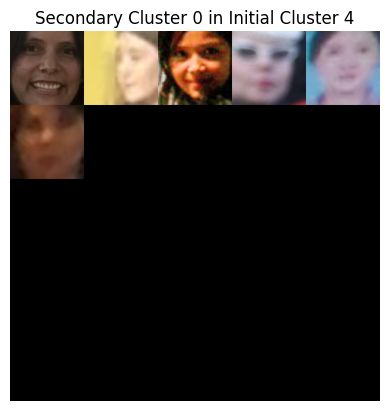

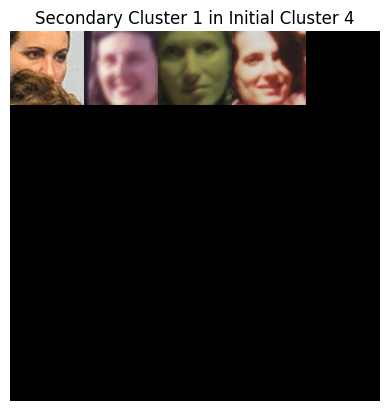

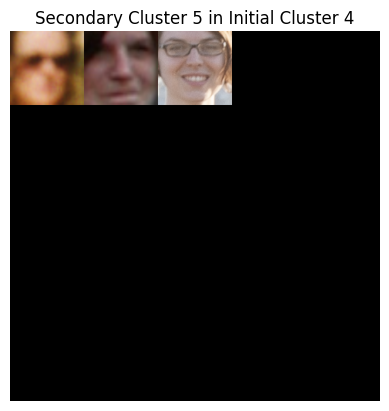

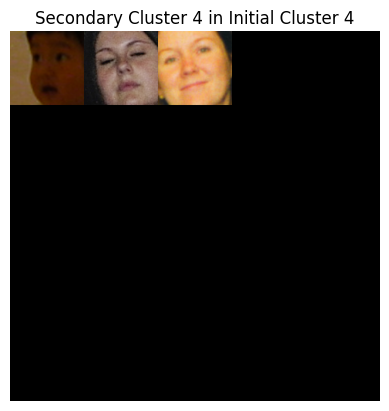

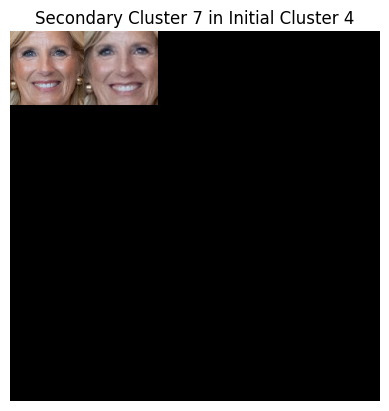

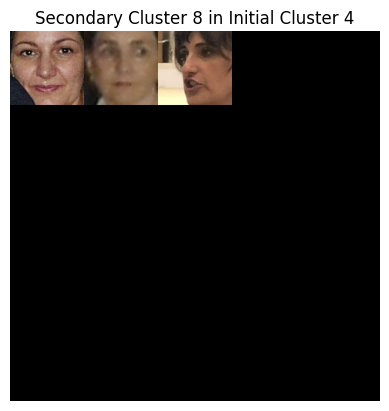

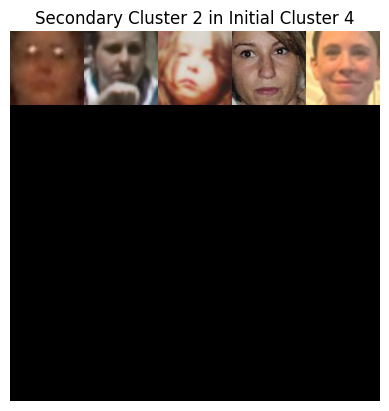

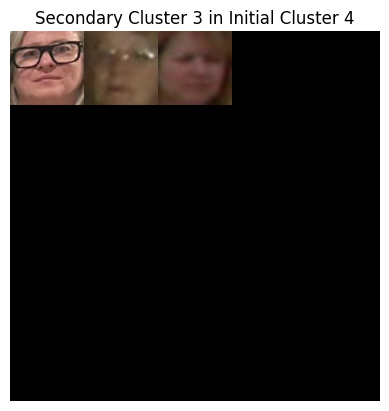

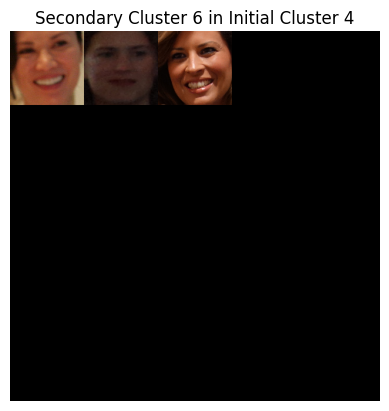

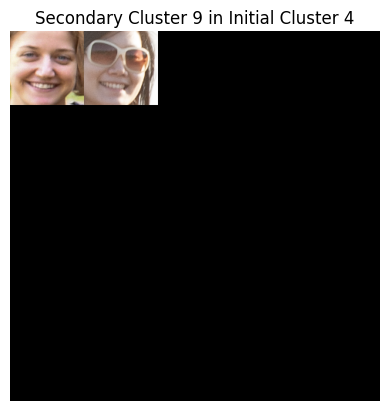

In [23]:

# Define the initial cluster you want to visualize
initial_cluster_label = 4

# Filter the DataFrame for the specified initial cluster
filtered_df = df[df['initial cluster'] == initial_cluster_label]

# Get the unique secondary clusters within the initial cluster
secondary_cluster_labels = filtered_df['secondary cluster'].unique()

# Iterate over each secondary cluster and create a montage
for secondary_cluster_label in secondary_cluster_labels:
    # Filter the DataFrame for the current secondary cluster
    sec_cluster_df = filtered_df[filtered_df['secondary cluster'] == secondary_cluster_label]
    
    # Randomly sample up to 25 images from the filtered DataFrame
    sample_size = min(25, len(sec_cluster_df))
    sampled_df = sec_cluster_df.sample(n=sample_size, random_state=42)
    
    faces = []

    # Loop over the sampled DataFrame rows to extract and process the face images
    for _, row in sampled_df.iterrows():
        image_path = row["image path"]
        image = cv2.imread(image_path)
        # Assuming the 'loc' column is in your DataFrame and contains the face bounding box
        (top, right, bottom, left) = row["loc"]
        face = image[top:bottom, left:right]
        face = cv2.resize(face, (96, 96))
        faces.append(face)

    # Create a montage using 96x96 "tiles" with 5 rows and 5 columns
    if faces:
        montage = build_montages(faces, (96, 96), (5, 5))[0]
        rgb_image = cv2.cvtColor(montage, cv2.COLOR_BGR2RGB)
        
        title = f"Secondary Cluster {secondary_cluster_label} in Initial Cluster {initial_cluster_label}"
        plt.imshow(rgb_image)
        plt.title(title)
        plt.axis('off')  # Optional: Turn off the axis labels
        plt.show()
    else:
        print(f"[INFO] No images found for Secondary Cluster {secondary_cluster_label} in Initial Cluster {initial_cluster_label}")

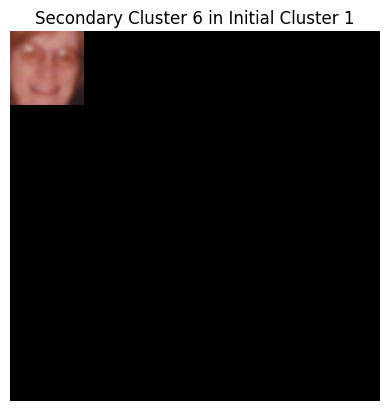

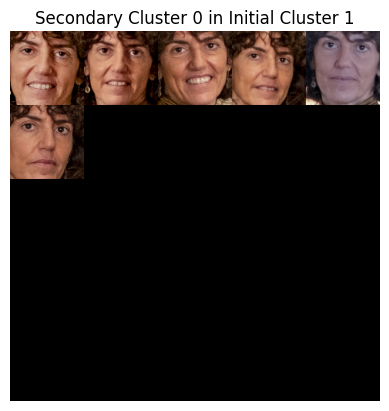

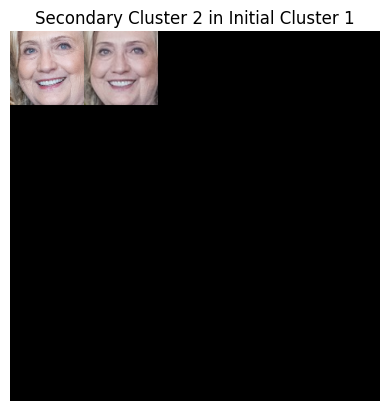

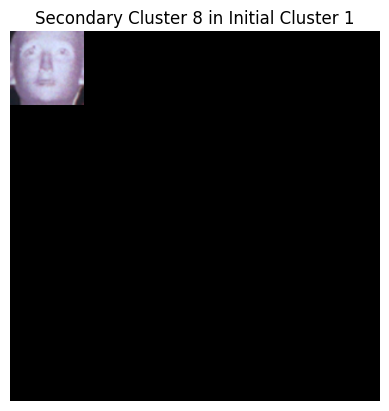

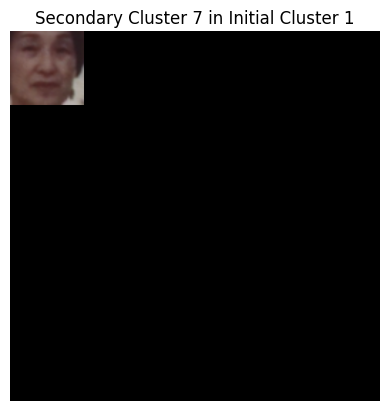

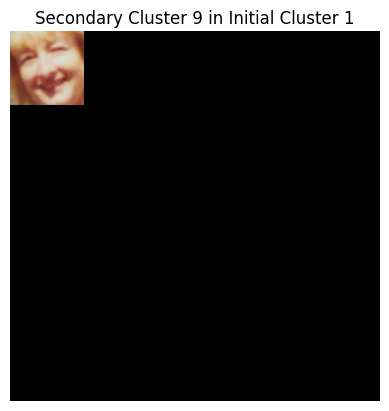

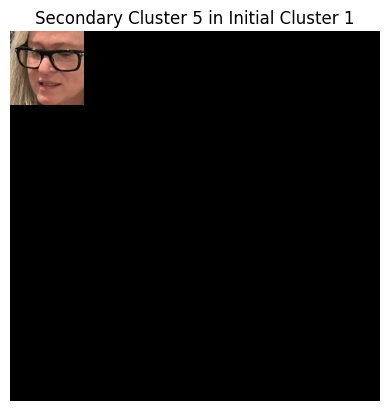

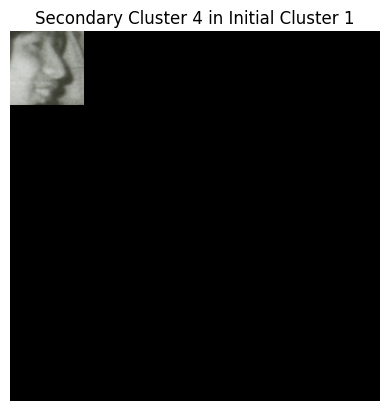

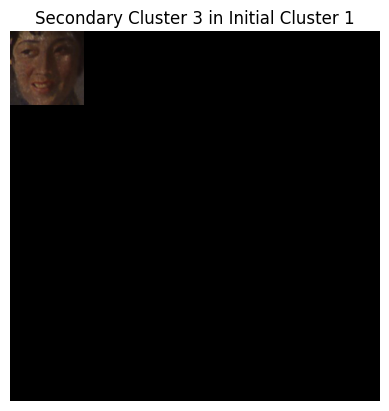

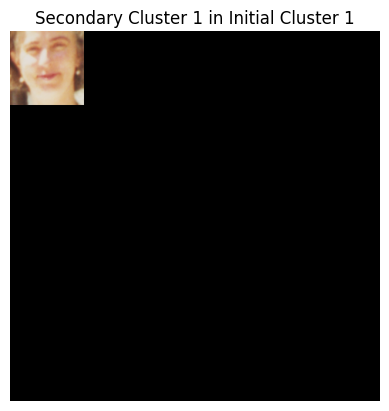

In [24]:

# Define the initial cluster you want to visualize
initial_cluster_label = 1

# Filter the DataFrame for the specified initial cluster
filtered_df = df[df['initial cluster'] == initial_cluster_label]

# Get the unique secondary clusters within the initial cluster
secondary_cluster_labels = filtered_df['secondary cluster'].unique()

# Iterate over each secondary cluster and create a montage
for secondary_cluster_label in secondary_cluster_labels:
    # Filter the DataFrame for the current secondary cluster
    sec_cluster_df = filtered_df[filtered_df['secondary cluster'] == secondary_cluster_label]
    
    # Randomly sample up to 25 images from the filtered DataFrame
    sample_size = min(25, len(sec_cluster_df))
    sampled_df = sec_cluster_df.sample(n=sample_size, random_state=42)
    
    faces = []

    # Loop over the sampled DataFrame rows to extract and process the face images
    for _, row in sampled_df.iterrows():
        image_path = row["image path"]
        image = cv2.imread(image_path)
        # Assuming the 'loc' column is in your DataFrame and contains the face bounding box
        (top, right, bottom, left) = row["loc"]
        face = image[top:bottom, left:right]
        face = cv2.resize(face, (96, 96))
        faces.append(face)

    # Create a montage using 96x96 "tiles" with 5 rows and 5 columns
    if faces:
        montage = build_montages(faces, (96, 96), (5, 5))[0]
        rgb_image = cv2.cvtColor(montage, cv2.COLOR_BGR2RGB)
        
        title = f"Secondary Cluster {secondary_cluster_label} in Initial Cluster {initial_cluster_label}"
        plt.imshow(rgb_image)
        plt.title(title)
        plt.axis('off')  # Optional: Turn off the axis labels
        plt.show()
    else:
        print(f"[INFO] No images found for Secondary Cluster {secondary_cluster_label} in Initial Cluster {initial_cluster_label}")

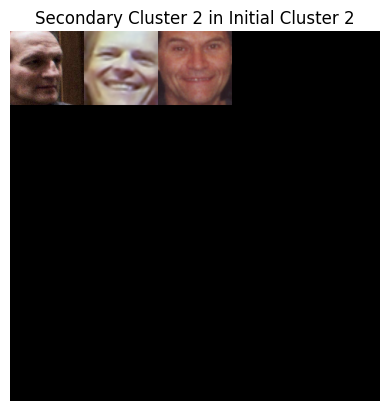

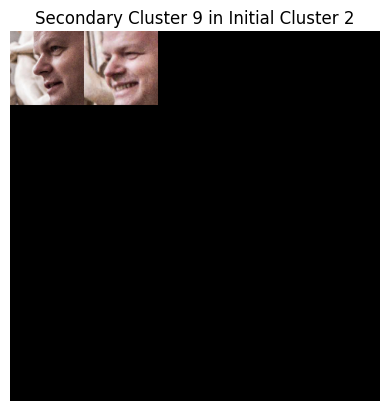

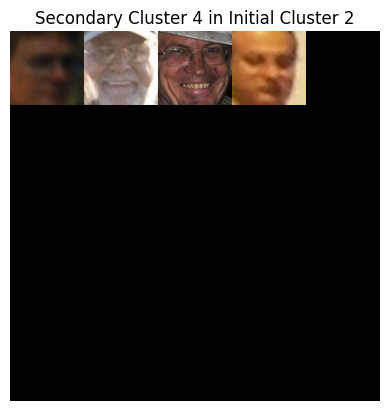

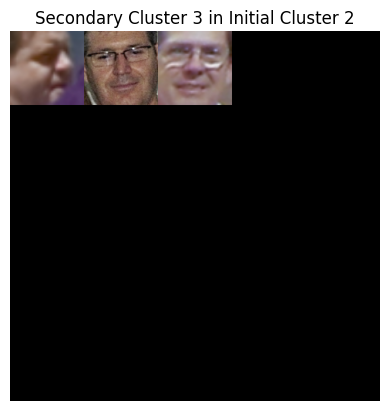

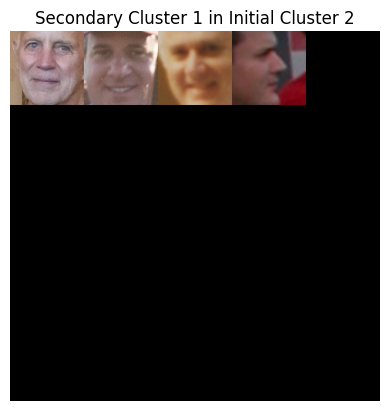

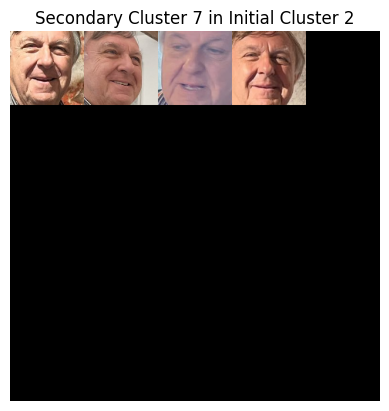

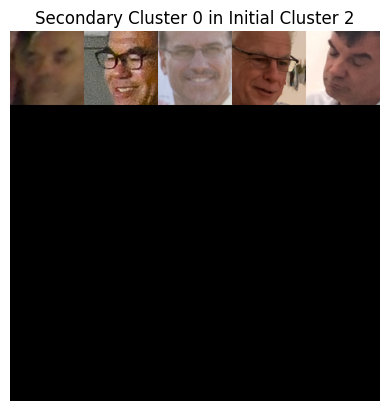

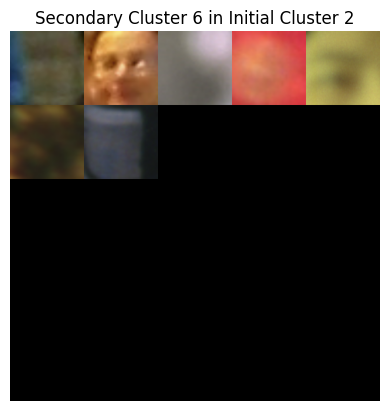

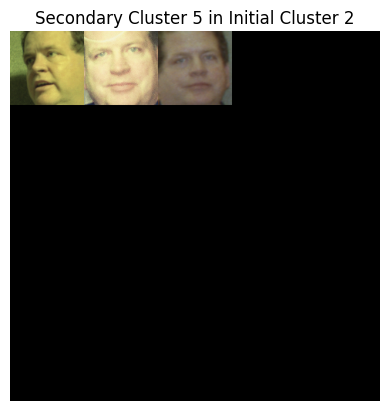

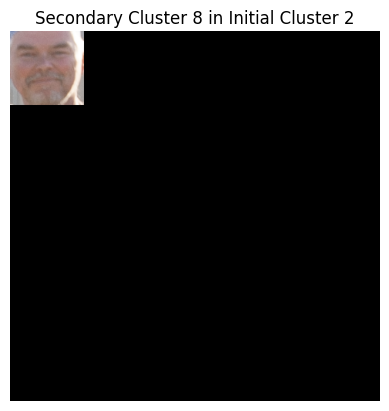

In [25]:

# Define the initial cluster you want to visualize
initial_cluster_label = 2

# Filter the DataFrame for the specified initial cluster
filtered_df = df[df['initial cluster'] == initial_cluster_label]

# Get the unique secondary clusters within the initial cluster
secondary_cluster_labels = filtered_df['secondary cluster'].unique()

# Iterate over each secondary cluster and create a montage
for secondary_cluster_label in secondary_cluster_labels:
    # Filter the DataFrame for the current secondary cluster
    sec_cluster_df = filtered_df[filtered_df['secondary cluster'] == secondary_cluster_label]
    
    # Randomly sample up to 25 images from the filtered DataFrame
    sample_size = min(25, len(sec_cluster_df))
    sampled_df = sec_cluster_df.sample(n=sample_size, random_state=42)
    
    faces = []

    # Loop over the sampled DataFrame rows to extract and process the face images
    for _, row in sampled_df.iterrows():
        image_path = row["image path"]
        image = cv2.imread(image_path)
        # Assuming the 'loc' column is in your DataFrame and contains the face bounding box
        (top, right, bottom, left) = row["loc"]
        face = image[top:bottom, left:right]
        face = cv2.resize(face, (96, 96))
        faces.append(face)

    # Create a montage using 96x96 "tiles" with 5 rows and 5 columns
    if faces:
        montage = build_montages(faces, (96, 96), (5, 5))[0]
        rgb_image = cv2.cvtColor(montage, cv2.COLOR_BGR2RGB)
        
        title = f"Secondary Cluster {secondary_cluster_label} in Initial Cluster {initial_cluster_label}"
        plt.imshow(rgb_image)
        plt.title(title)
        plt.axis('off')  # Optional: Turn off the axis labels
        plt.show()
    else:
        print(f"[INFO] No images found for Secondary Cluster {secondary_cluster_label} in Initial Cluster {initial_cluster_label}")

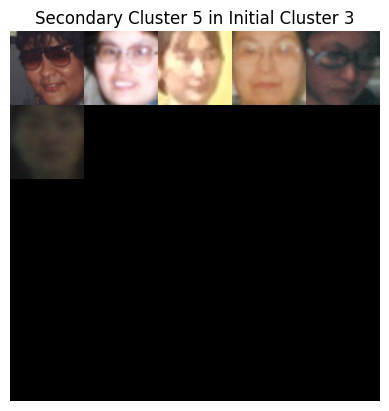

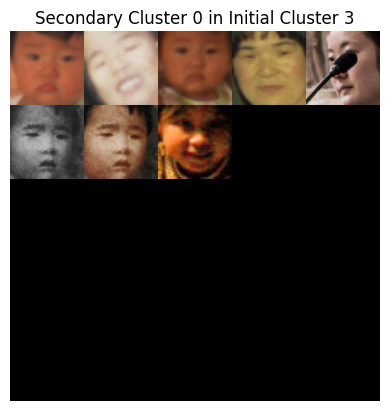

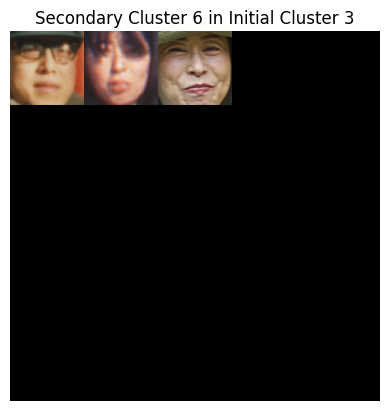

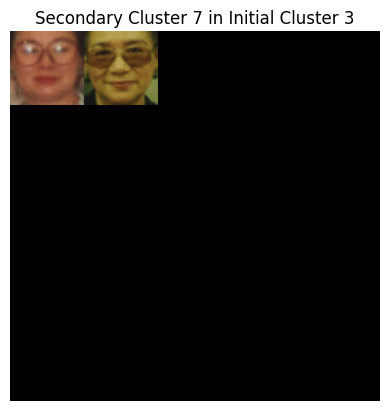

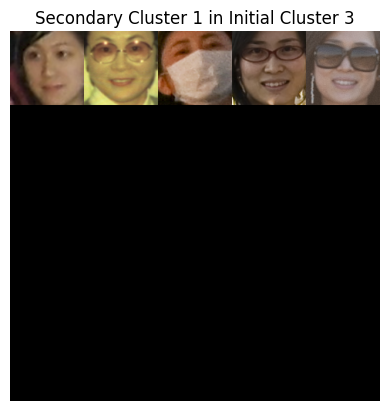

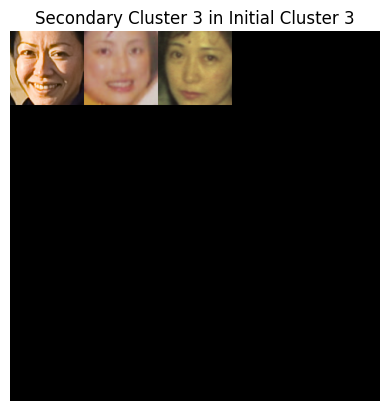

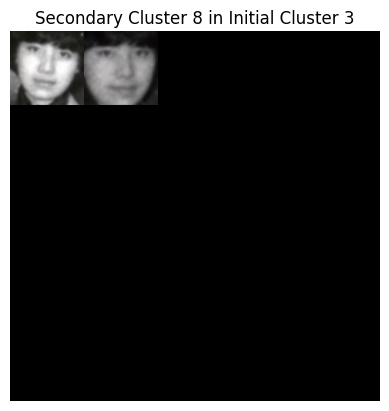

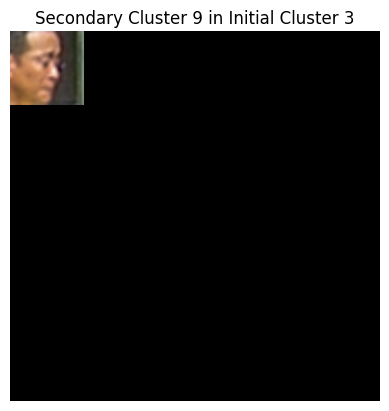

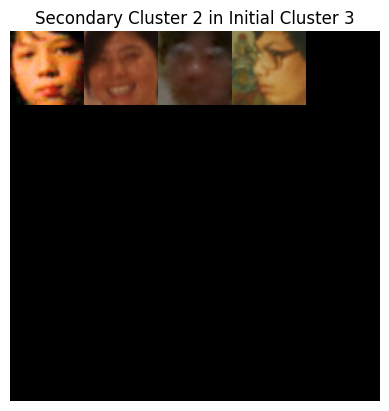

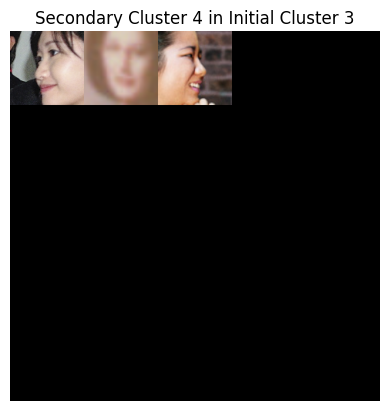

In [26]:

# Define the initial cluster you want to visualize
initial_cluster_label = 3

# Filter the DataFrame for the specified initial cluster
filtered_df = df[df['initial cluster'] == initial_cluster_label]

# Get the unique secondary clusters within the initial cluster
secondary_cluster_labels = filtered_df['secondary cluster'].unique()

# Iterate over each secondary cluster and create a montage
for secondary_cluster_label in secondary_cluster_labels:
    # Filter the DataFrame for the current secondary cluster
    sec_cluster_df = filtered_df[filtered_df['secondary cluster'] == secondary_cluster_label]
    
    # Randomly sample up to 25 images from the filtered DataFrame
    sample_size = min(25, len(sec_cluster_df))
    sampled_df = sec_cluster_df.sample(n=sample_size, random_state=42)
    
    faces = []

    # Loop over the sampled DataFrame rows to extract and process the face images
    for _, row in sampled_df.iterrows():
        image_path = row["image path"]
        image = cv2.imread(image_path)
        # Assuming the 'loc' column is in your DataFrame and contains the face bounding box
        (top, right, bottom, left) = row["loc"]
        face = image[top:bottom, left:right]
        face = cv2.resize(face, (96, 96))
        faces.append(face)

    # Create a montage using 96x96 "tiles" with 5 rows and 5 columns
    if faces:
        montage = build_montages(faces, (96, 96), (5, 5))[0]
        rgb_image = cv2.cvtColor(montage, cv2.COLOR_BGR2RGB)
        
        title = f"Secondary Cluster {secondary_cluster_label} in Initial Cluster {initial_cluster_label}"
        plt.imshow(rgb_image)
        plt.title(title)
        plt.axis('off')  # Optional: Turn off the axis labels
        plt.show()
    else:
        print(f"[INFO] No images found for Secondary Cluster {secondary_cluster_label} in Initial Cluster {initial_cluster_label}")

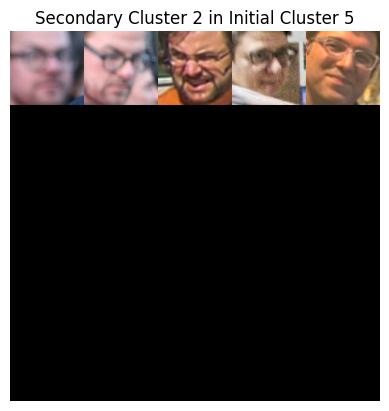

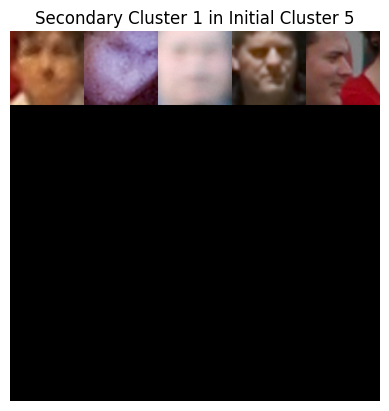

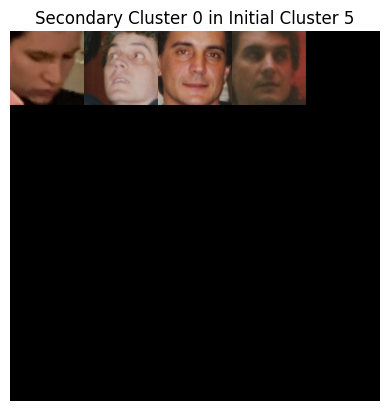

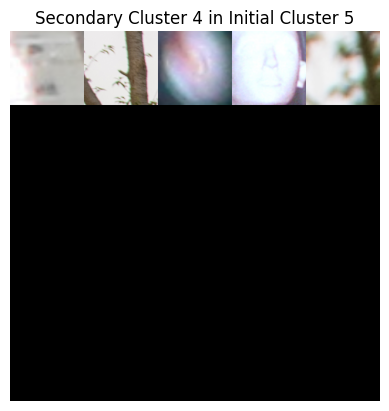

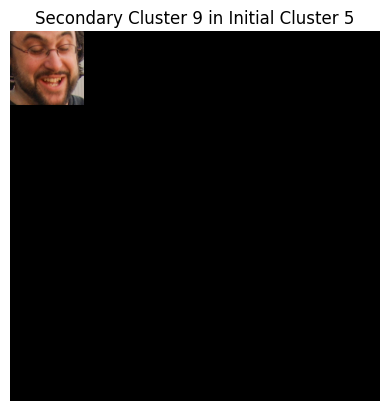

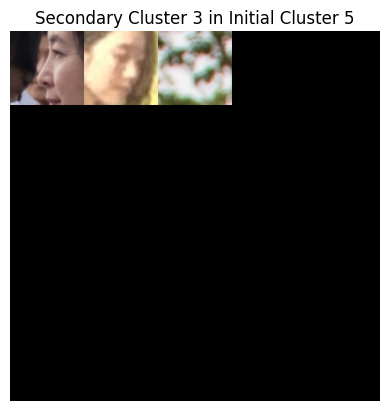

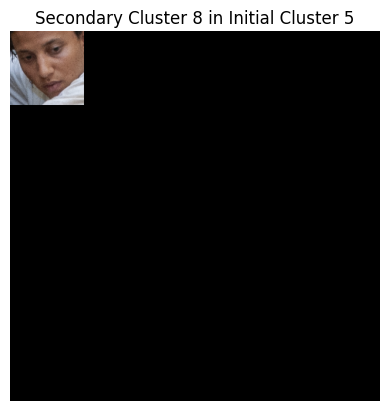

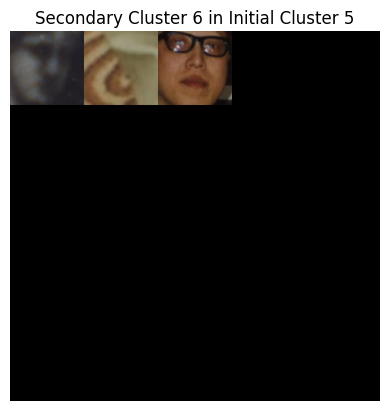

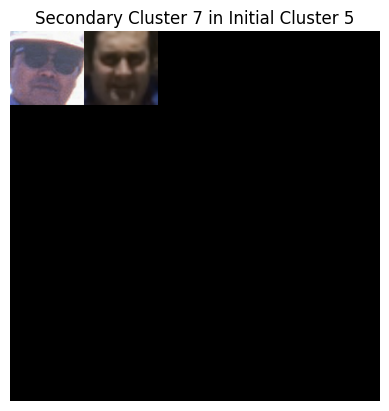

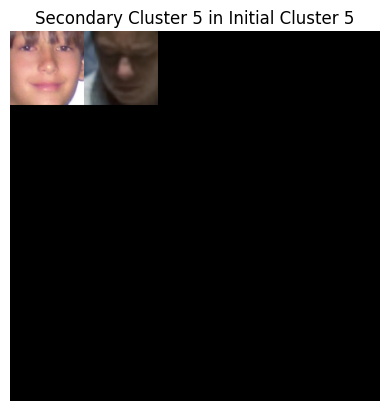

In [28]:

# Define the initial cluster you want to visualize
initial_cluster_label = 5

# Filter the DataFrame for the specified initial cluster
filtered_df = df[df['initial cluster'] == initial_cluster_label]

# Get the unique secondary clusters within the initial cluster
secondary_cluster_labels = filtered_df['secondary cluster'].unique()

# Iterate over each secondary cluster and create a montage
for secondary_cluster_label in secondary_cluster_labels:
    # Filter the DataFrame for the current secondary cluster
    sec_cluster_df = filtered_df[filtered_df['secondary cluster'] == secondary_cluster_label]
    
    # Randomly sample up to 25 images from the filtered DataFrame
    sample_size = min(25, len(sec_cluster_df))
    sampled_df = sec_cluster_df.sample(n=sample_size, random_state=42)
    
    faces = []

    # Loop over the sampled DataFrame rows to extract and process the face images
    for _, row in sampled_df.iterrows():
        image_path = row["image path"]
        image = cv2.imread(image_path)
        # Assuming the 'loc' column is in your DataFrame and contains the face bounding box
        # Check the contents of the "loc" column for the first row  

        (top, right, bottom, left) = row["loc"]
        face = image[top:bottom, left:right]
        face = cv2.resize(face, (96, 96))
        faces.append(face)

    # Create a montage using 96x96 "tiles" with 5 rows and 5 columns
    if faces:
        montage = build_montages(faces, (96, 96), (5, 5))[0]
        rgb_image = cv2.cvtColor(montage, cv2.COLOR_BGR2RGB)
        
        title = f"Secondary Cluster {secondary_cluster_label} in Initial Cluster {initial_cluster_label}"
        plt.imshow(rgb_image)
        plt.title(title)
        plt.axis('off')  # Optional: Turn off the axis labels
        plt.show()
    else:
        print(f"[INFO] No images found for Secondary Cluster {secondary_cluster_label} in Initial Cluster {initial_cluster_label}")

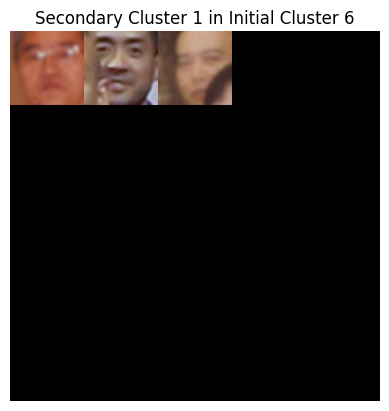

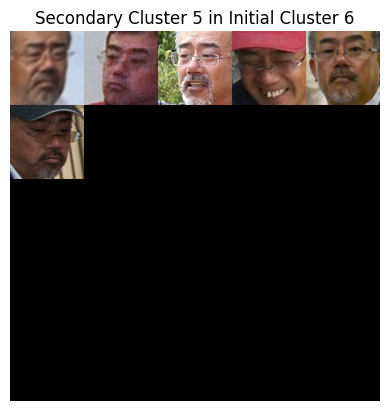

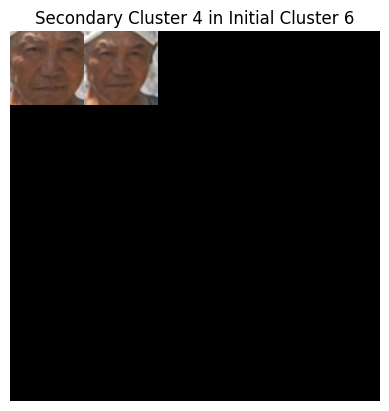

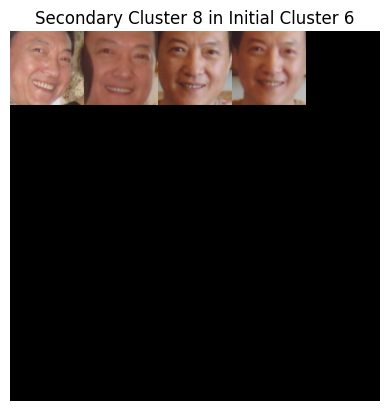

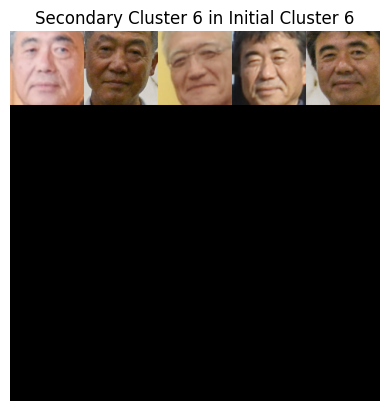

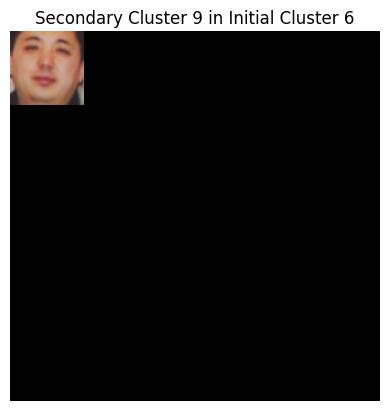

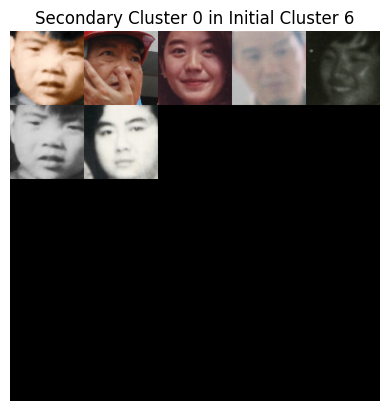

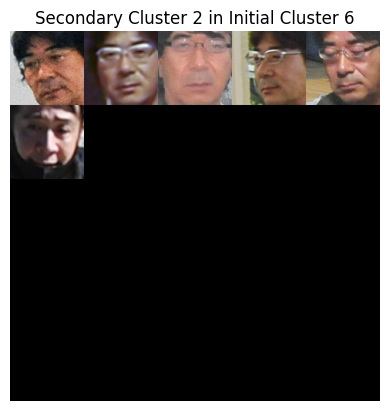

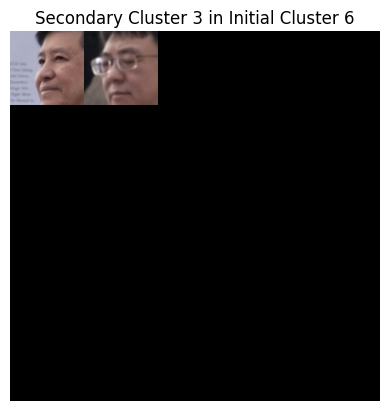

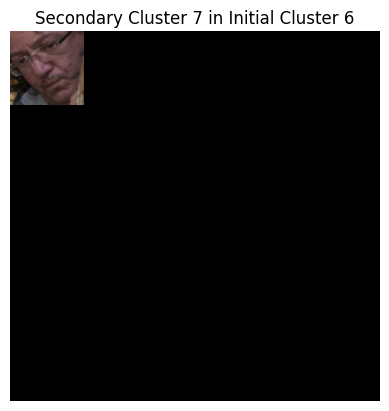

In [29]:

# Define the initial cluster you want to visualize
initial_cluster_label = 6

# Filter the DataFrame for the specified initial cluster
filtered_df = df[df['initial cluster'] == initial_cluster_label]

# Get the unique secondary clusters within the initial cluster
secondary_cluster_labels = filtered_df['secondary cluster'].unique()

# Iterate over each secondary cluster and create a montage
for secondary_cluster_label in secondary_cluster_labels:
    # Filter the DataFrame for the current secondary cluster
    sec_cluster_df = filtered_df[filtered_df['secondary cluster'] == secondary_cluster_label]
    
    # Randomly sample up to 25 images from the filtered DataFrame
    sample_size = min(25, len(sec_cluster_df))
    sampled_df = sec_cluster_df.sample(n=sample_size, random_state=42)
    
    faces = []

    # Loop over the sampled DataFrame rows to extract and process the face images
    for _, row in sampled_df.iterrows():
        image_path = row["image path"]
        image = cv2.imread(image_path)
        # Assuming the 'loc' column is in your DataFrame and contains the face bounding box
        (top, right, bottom, left) = row["loc"]
        face = image[top:bottom, left:right]
        face = cv2.resize(face, (96, 96))
        faces.append(face)

    # Create a montage using 96x96 "tiles" with 5 rows and 5 columns
    if faces:
        montage = build_montages(faces, (96, 96), (5, 5))[0]
        rgb_image = cv2.cvtColor(montage, cv2.COLOR_BGR2RGB)
        
        title = f"Secondary Cluster {secondary_cluster_label} in Initial Cluster {initial_cluster_label}"
        plt.imshow(rgb_image)
        plt.title(title)
        plt.axis('off')  # Optional: Turn off the axis labels
        plt.show()
    else:
        print(f"[INFO] No images found for Secondary Cluster {secondary_cluster_label} in Initial Cluster {initial_cluster_label}")

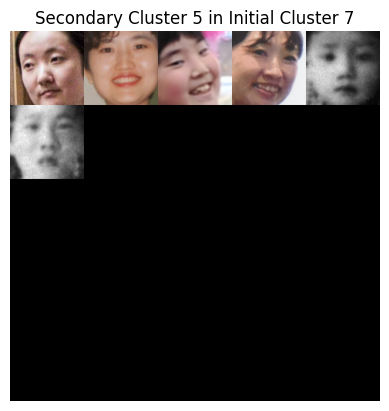

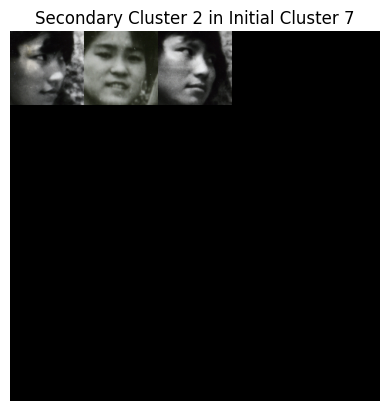

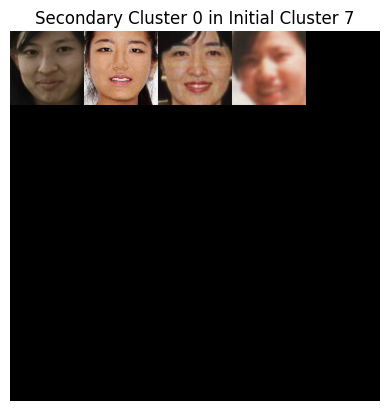

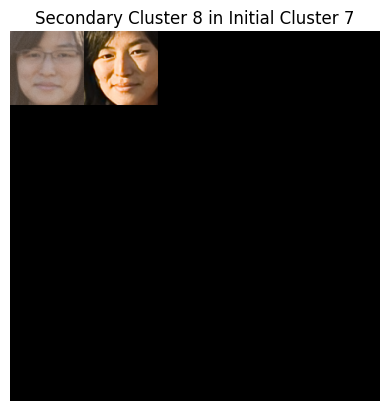

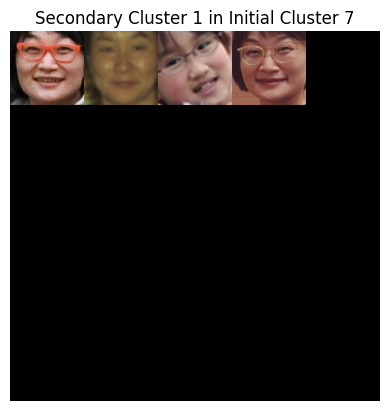

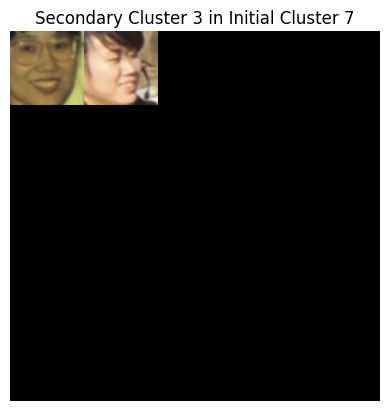

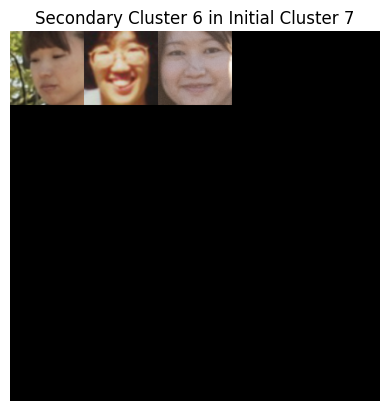

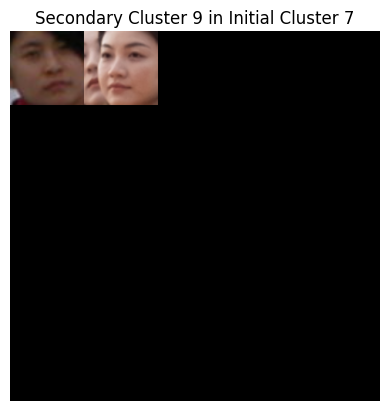

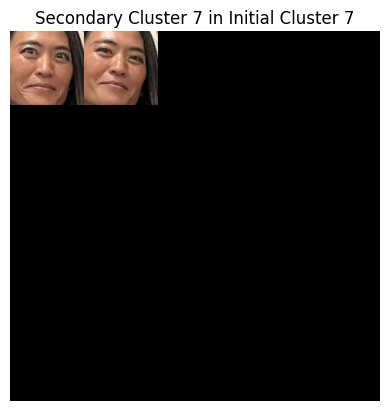

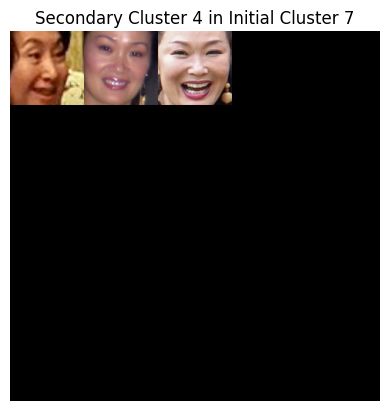

In [30]:

# Define the initial cluster you want to visualize
initial_cluster_label = 7

# Filter the DataFrame for the specified initial cluster
filtered_df = df[df['initial cluster'] == initial_cluster_label]

# Get the unique secondary clusters within the initial cluster
secondary_cluster_labels = filtered_df['secondary cluster'].unique()

# Iterate over each secondary cluster and create a montage
for secondary_cluster_label in secondary_cluster_labels:
    # Filter the DataFrame for the current secondary cluster
    sec_cluster_df = filtered_df[filtered_df['secondary cluster'] == secondary_cluster_label]
    
    # Randomly sample up to 25 images from the filtered DataFrame
    sample_size = min(25, len(sec_cluster_df))
    sampled_df = sec_cluster_df.sample(n=sample_size, random_state=42)
    
    faces = []

    # Loop over the sampled DataFrame rows to extract and process the face images
    for _, row in sampled_df.iterrows():
        image_path = row["image path"]
        image = cv2.imread(image_path)
        # Assuming the 'loc' column is in your DataFrame and contains the face bounding box
        (top, right, bottom, left) = row["loc"]
        face = image[top:bottom, left:right]
        face = cv2.resize(face, (96, 96))
        faces.append(face)

    # Create a montage using 96x96 "tiles" with 5 rows and 5 columns
    if faces:
        montage = build_montages(faces, (96, 96), (5, 5))[0]
        rgb_image = cv2.cvtColor(montage, cv2.COLOR_BGR2RGB)
        
        title = f"Secondary Cluster {secondary_cluster_label} in Initial Cluster {initial_cluster_label}"
        plt.imshow(rgb_image)
        plt.title(title)
        plt.axis('off')  # Optional: Turn off the axis labels
        plt.show()
    else:
        print(f"[INFO] No images found for Secondary Cluster {secondary_cluster_label} in Initial Cluster {initial_cluster_label}")

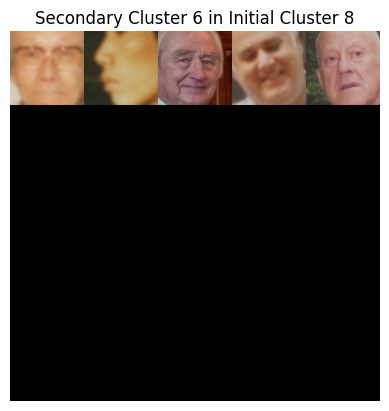

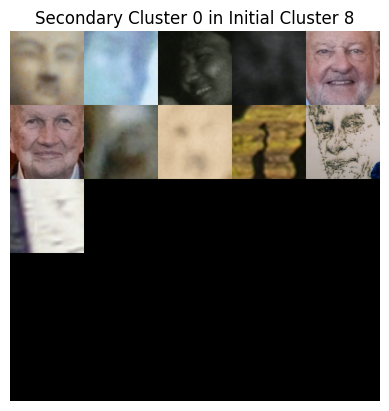

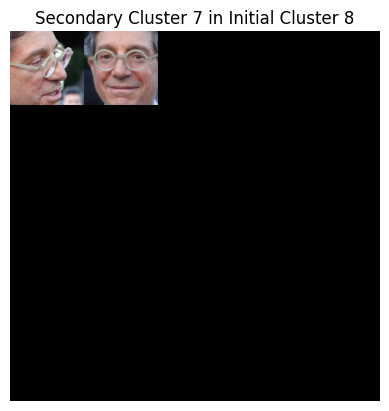

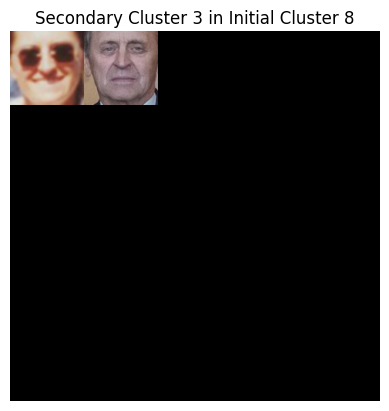

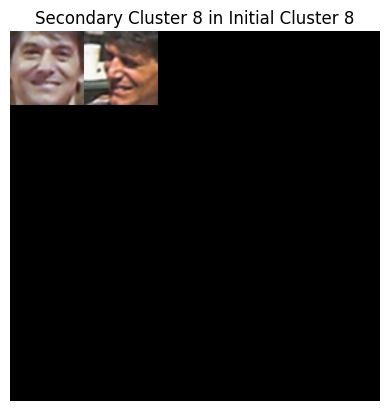

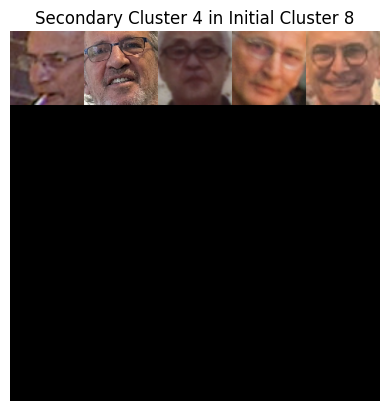

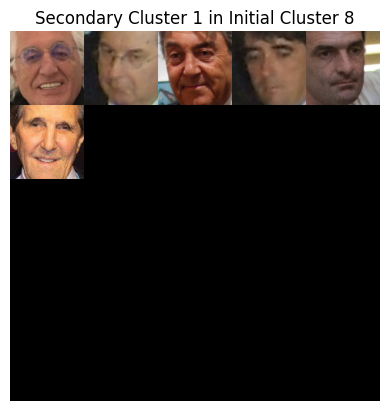

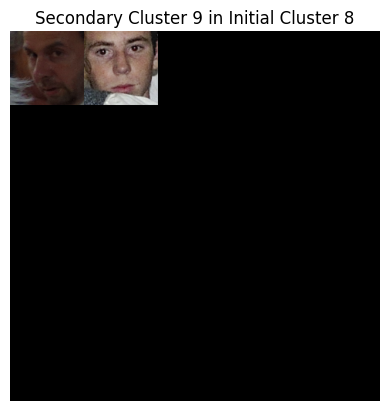

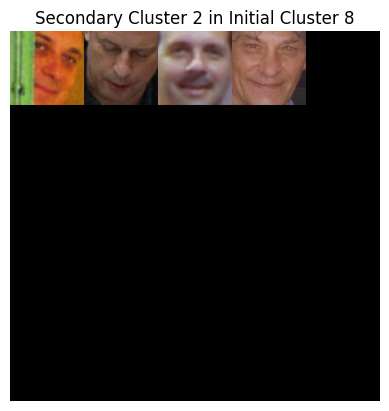

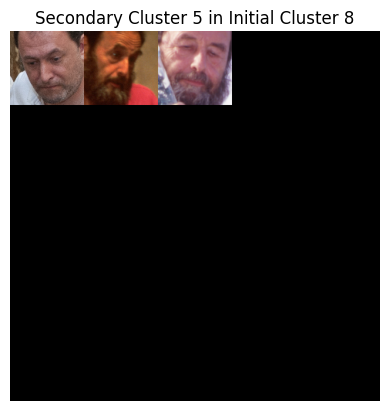

In [32]:

# Define the initial cluster you want to visualize
initial_cluster_label = 8

# Filter the DataFrame for the specified initial cluster
filtered_df = df[df['initial cluster'] == initial_cluster_label]

# Get the unique secondary clusters within the initial cluster
secondary_cluster_labels = filtered_df['secondary cluster'].unique()

# Iterate over each secondary cluster and create a montage
for secondary_cluster_label in secondary_cluster_labels:
    # Filter the DataFrame for the current secondary cluster
    sec_cluster_df = filtered_df[filtered_df['secondary cluster'] == secondary_cluster_label]
    
    # Randomly sample up to 25 images from the filtered DataFrame
    sample_size = min(25, len(sec_cluster_df))
    sampled_df = sec_cluster_df.sample(n=sample_size, random_state=42)
    
    faces = []

    # Loop over the sampled DataFrame rows to extract and process the face images
    for _, row in sampled_df.iterrows():
        image_path = row["image path"]
        image = cv2.imread(image_path)
        # Assuming the 'loc' column is in your DataFrame and contains the face bounding box
        (top, right, bottom, left) = row["loc"]
        face = image[top:bottom, left:right]
        face = cv2.resize(face, (96, 96))
        faces.append(face)

    # Create a montage using 96x96 "tiles" with 5 rows and 5 columns
    if faces:
        montage = build_montages(faces, (96, 96), (5, 5))[0]
        rgb_image = cv2.cvtColor(montage, cv2.COLOR_BGR2RGB)
        
        title = f"Secondary Cluster {secondary_cluster_label} in Initial Cluster {initial_cluster_label}"
        plt.imshow(rgb_image)
        plt.title(title)
        plt.axis('off')  # Optional: Turn off the axis labels
        plt.show()
    else:
        print(f"[INFO] No images found for Secondary Cluster {secondary_cluster_label} in Initial Cluster {initial_cluster_label}")

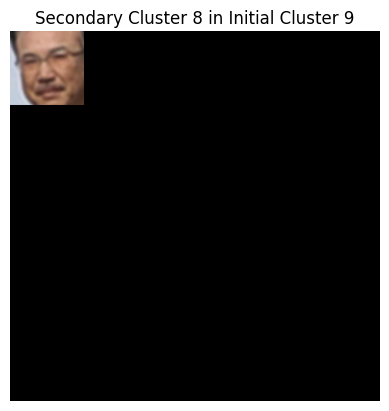

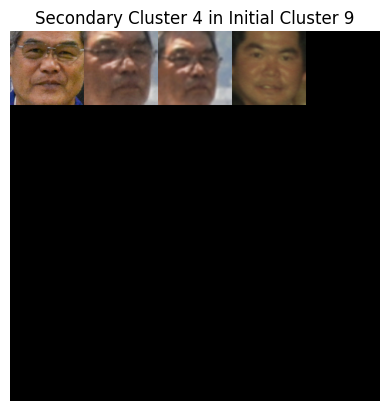

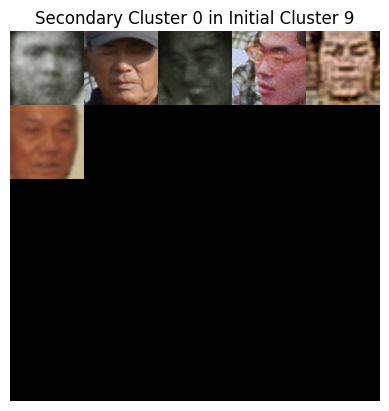

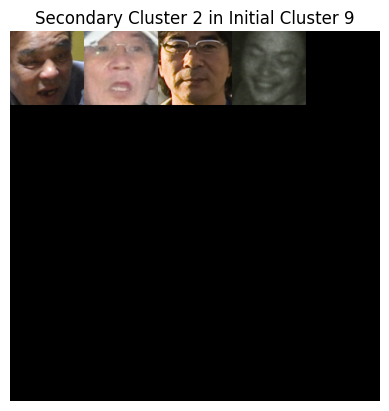

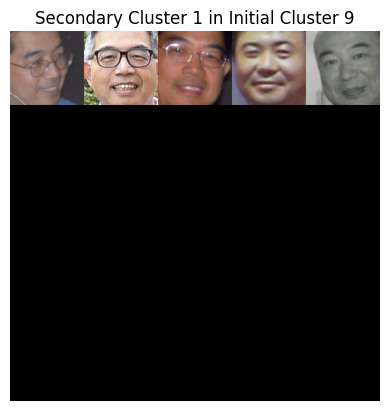

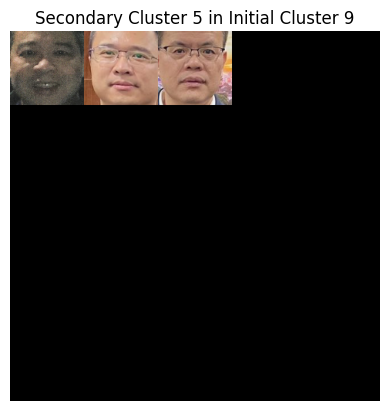

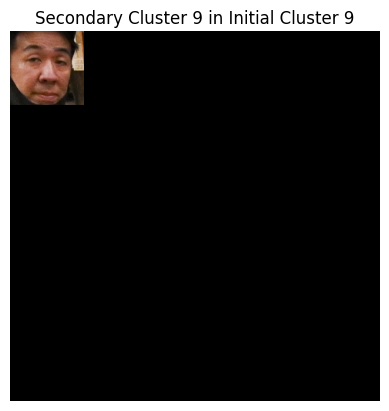

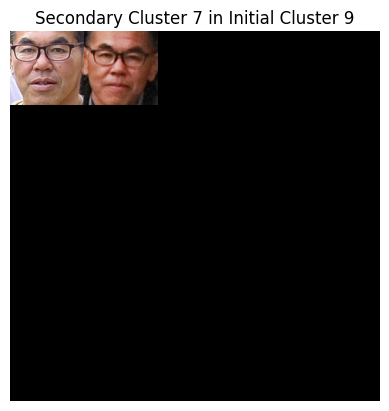

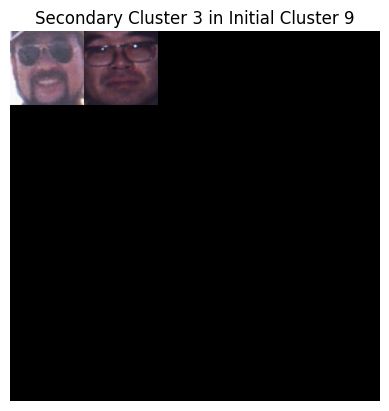

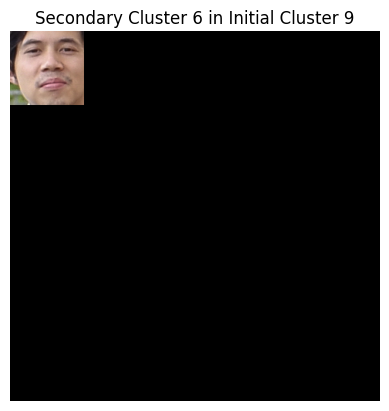

In [33]:

# Define the initial cluster you want to visualize
initial_cluster_label = 9

# Filter the DataFrame for the specified initial cluster
filtered_df = df[df['initial cluster'] == initial_cluster_label]

# Get the unique secondary clusters within the initial cluster
secondary_cluster_labels = filtered_df['secondary cluster'].unique()

# Iterate over each secondary cluster and create a montage
for secondary_cluster_label in secondary_cluster_labels:
    # Filter the DataFrame for the current secondary cluster
    sec_cluster_df = filtered_df[filtered_df['secondary cluster'] == secondary_cluster_label]
    
    # Randomly sample up to 25 images from the filtered DataFrame
    sample_size = min(25, len(sec_cluster_df))
    sampled_df = sec_cluster_df.sample(n=sample_size, random_state=42)
    
    faces = []

    # Loop over the sampled DataFrame rows to extract and process the face images
    for _, row in sampled_df.iterrows():
        image_path = row["image path"]
        image = cv2.imread(image_path)
        # Assuming the 'loc' column is in your DataFrame and contains the face bounding box
        (top, right, bottom, left) = row["loc"]
        face = image[top:bottom, left:right]
        face = cv2.resize(face, (96, 96))
        faces.append(face)

    # Create a montage using 96x96 "tiles" with 5 rows and 5 columns
    if faces:
        montage = build_montages(faces, (96, 96), (5, 5))[0]
        rgb_image = cv2.cvtColor(montage, cv2.COLOR_BGR2RGB)
        
        title = f"Secondary Cluster {secondary_cluster_label} in Initial Cluster {initial_cluster_label}"
        plt.imshow(rgb_image)
        plt.title(title)
        plt.axis('off')  # Optional: Turn off the axis labels
        plt.show()
    else:
        print(f"[INFO] No images found for Secondary Cluster {secondary_cluster_label} in Initial Cluster {initial_cluster_label}")

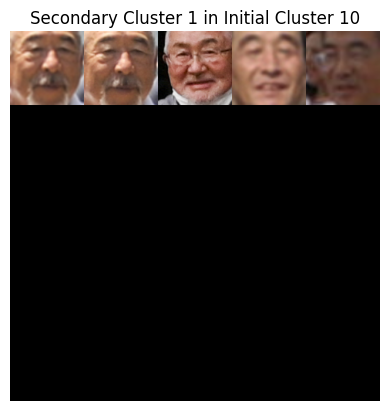

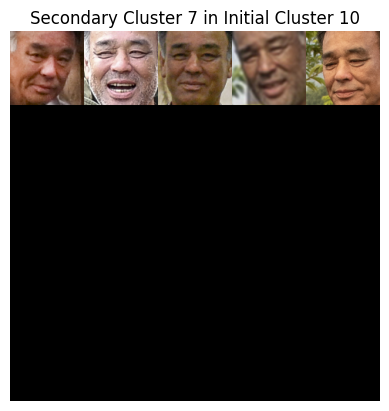

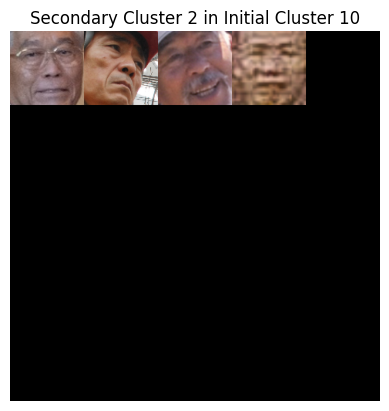

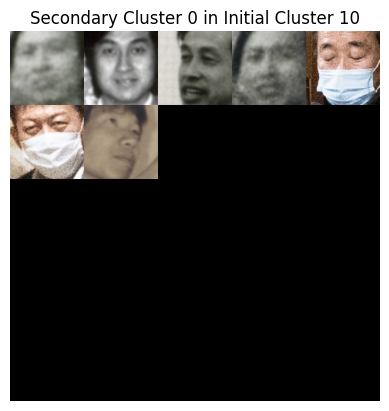

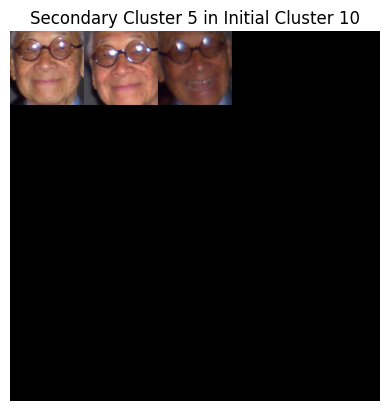

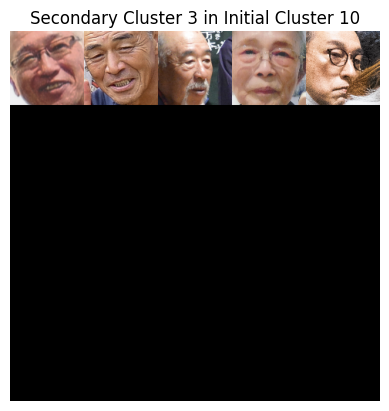

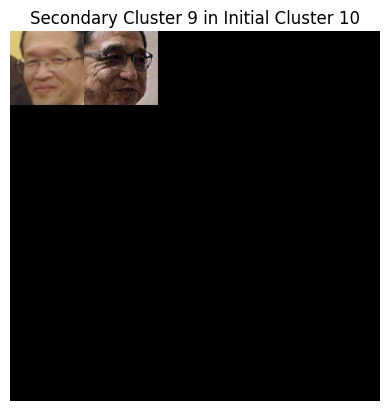

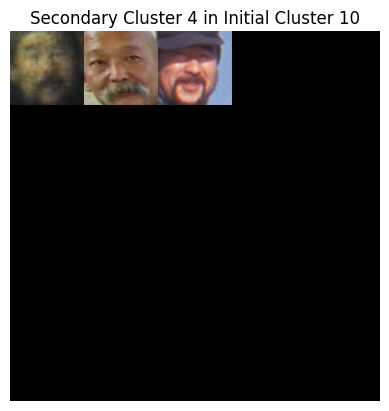

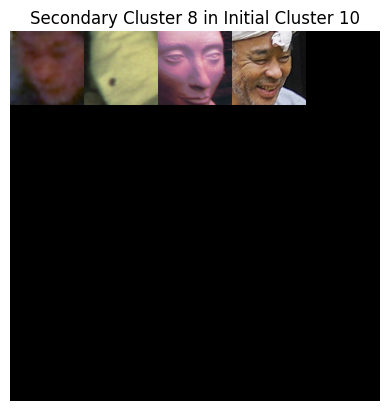

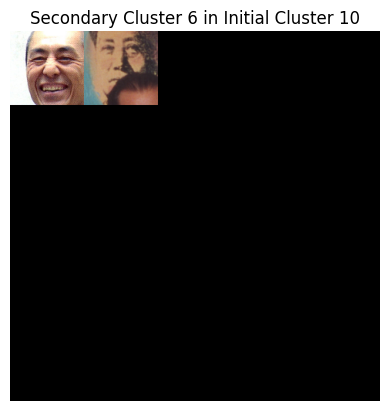

In [34]:

# Define the initial cluster you want to visualize
initial_cluster_label =10

# Filter the DataFrame for the specified initial cluster
filtered_df = df[df['initial cluster'] == initial_cluster_label]

# Get the unique secondary clusters within the initial cluster
secondary_cluster_labels = filtered_df['secondary cluster'].unique()

# Iterate over each secondary cluster and create a montage
for secondary_cluster_label in secondary_cluster_labels:
    # Filter the DataFrame for the current secondary cluster
    sec_cluster_df = filtered_df[filtered_df['secondary cluster'] == secondary_cluster_label]
    
    # Randomly sample up to 25 images from the filtered DataFrame
    sample_size = min(25, len(sec_cluster_df))
    sampled_df = sec_cluster_df.sample(n=sample_size, random_state=42)
    
    faces = []

    # Loop over the sampled DataFrame rows to extract and process the face images
    for _, row in sampled_df.iterrows():
        image_path = row["image path"]
        image = cv2.imread(image_path)
        # Assuming the 'loc' column is in your DataFrame and contains the face bounding box
        (top, right, bottom, left) = row["loc"]
        face = image[top:bottom, left:right]
        face = cv2.resize(face, (96, 96))
        faces.append(face)

    # Create a montage using 96x96 "tiles" with 5 rows and 5 columns
    if faces:
        montage = build_montages(faces, (96, 96), (5, 5))[0]
        rgb_image = cv2.cvtColor(montage, cv2.COLOR_BGR2RGB)
        
        title = f"Secondary Cluster {secondary_cluster_label} in Initial Cluster {initial_cluster_label}"
        plt.imshow(rgb_image)
        plt.title(title)
        plt.axis('off')  # Optional: Turn off the axis labels
        plt.show()
    else:
        print(f"[INFO] No images found for Secondary Cluster {secondary_cluster_label} in Initial Cluster {initial_cluster_label}")

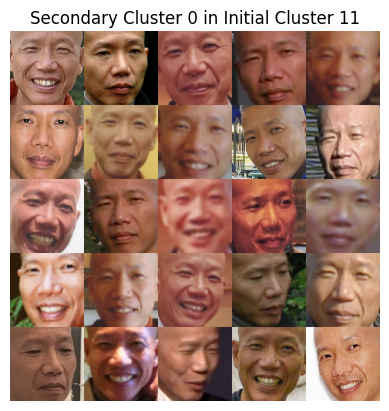

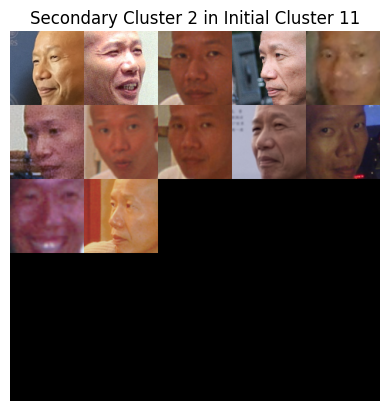

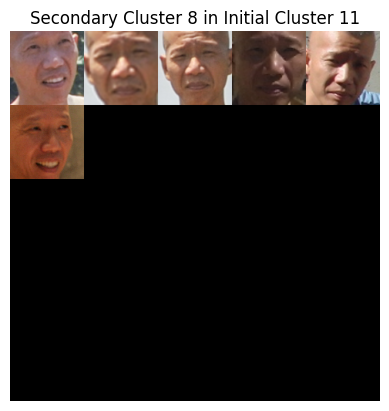

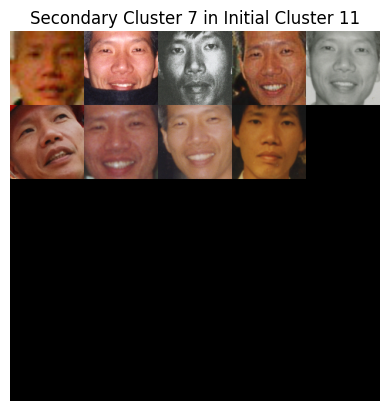

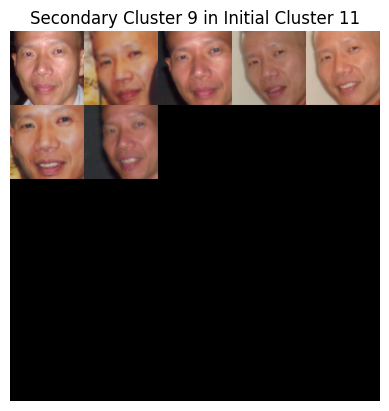

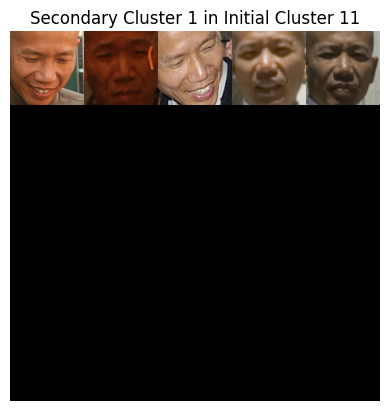

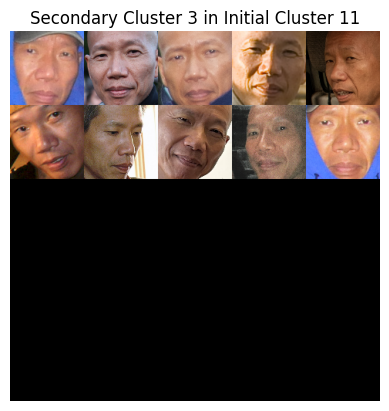

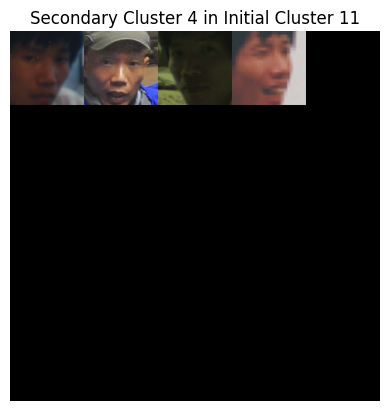

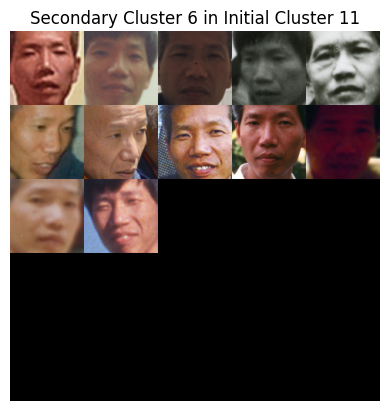

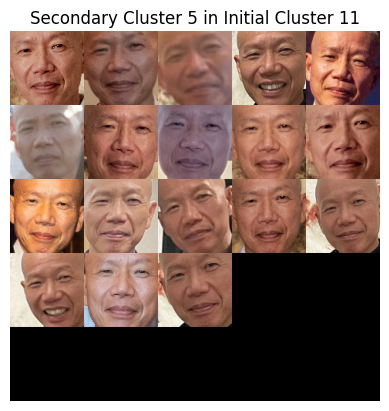

In [35]:

# Define the initial cluster you want to visualize
initial_cluster_label = 11

# Filter the DataFrame for the specified initial cluster
filtered_df = df[df['initial cluster'] == initial_cluster_label]

# Get the unique secondary clusters within the initial cluster
secondary_cluster_labels = filtered_df['secondary cluster'].unique()

# Iterate over each secondary cluster and create a montage
for secondary_cluster_label in secondary_cluster_labels:
    # Filter the DataFrame for the current secondary cluster
    sec_cluster_df = filtered_df[filtered_df['secondary cluster'] == secondary_cluster_label]
    
    # Randomly sample up to 25 images from the filtered DataFrame
    sample_size = min(25, len(sec_cluster_df))
    sampled_df = sec_cluster_df.sample(n=sample_size, random_state=42)
    
    faces = []

    # Loop over the sampled DataFrame rows to extract and process the face images
    for _, row in sampled_df.iterrows():
        image_path = row["image path"]
        image = cv2.imread(image_path)
        # Assuming the 'loc' column is in your DataFrame and contains the face bounding box
        (top, right, bottom, left) = row["loc"]
        face = image[top:bottom, left:right]
        face = cv2.resize(face, (96, 96))
        faces.append(face)

    # Create a montage using 96x96 "tiles" with 5 rows and 5 columns
    if faces:
        montage = build_montages(faces, (96, 96), (5, 5))[0]
        rgb_image = cv2.cvtColor(montage, cv2.COLOR_BGR2RGB)
        
        title = f"Secondary Cluster {secondary_cluster_label} in Initial Cluster {initial_cluster_label}"
        plt.imshow(rgb_image)
        plt.title(title)
        plt.axis('off')  # Optional: Turn off the axis labels
        plt.show()
    else:
        print(f"[INFO] No images found for Secondary Cluster {secondary_cluster_label} in Initial Cluster {initial_cluster_label}")

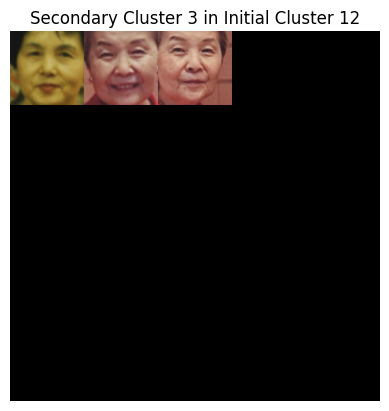

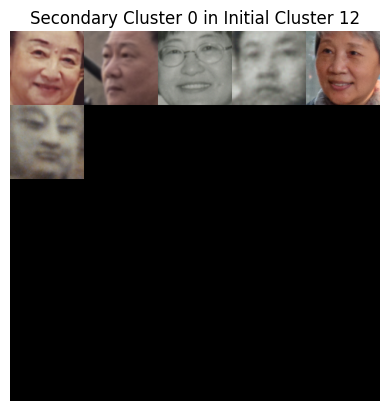

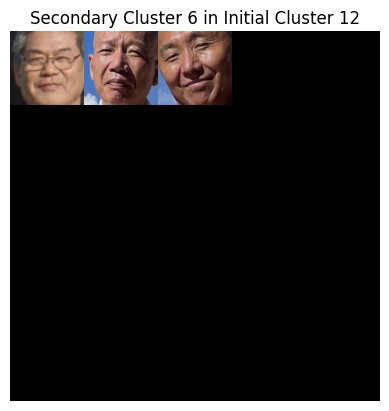

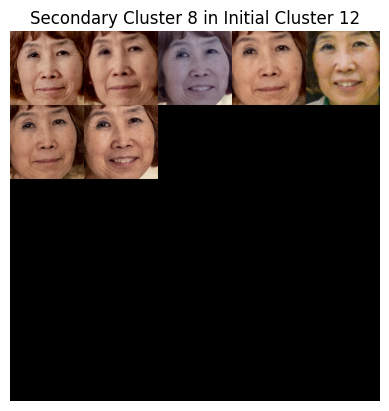

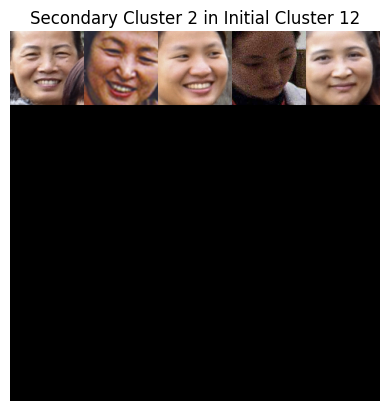

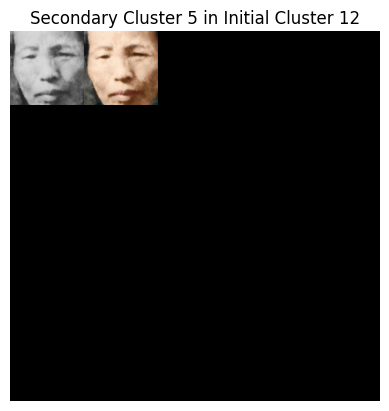

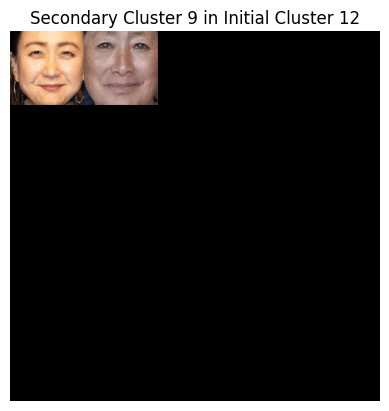

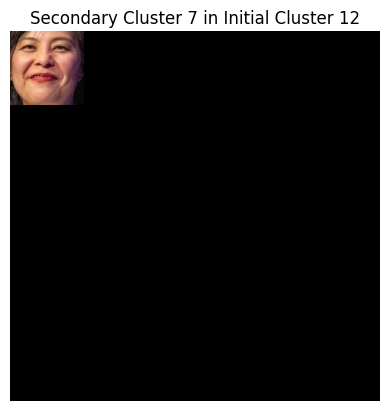

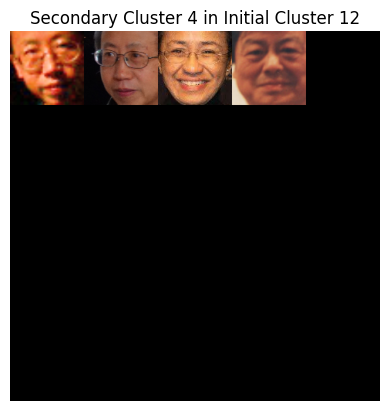

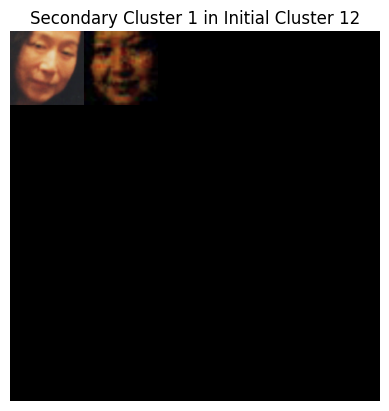

In [36]:

# Define the initial cluster you want to visualize
initial_cluster_label = 12

# Filter the DataFrame for the specified initial cluster
filtered_df = df[df['initial cluster'] == initial_cluster_label]

# Get the unique secondary clusters within the initial cluster
secondary_cluster_labels = filtered_df['secondary cluster'].unique()

# Iterate over each secondary cluster and create a montage
for secondary_cluster_label in secondary_cluster_labels:
    # Filter the DataFrame for the current secondary cluster
    sec_cluster_df = filtered_df[filtered_df['secondary cluster'] == secondary_cluster_label]
    
    # Randomly sample up to 25 images from the filtered DataFrame
    sample_size = min(25, len(sec_cluster_df))
    sampled_df = sec_cluster_df.sample(n=sample_size, random_state=42)
    
    faces = []

    # Loop over the sampled DataFrame rows to extract and process the face images
    for _, row in sampled_df.iterrows():
        image_path = row["image path"]
        image = cv2.imread(image_path)
        # Assuming the 'loc' column is in your DataFrame and contains the face bounding box
        (top, right, bottom, left) = row["loc"]
        face = image[top:bottom, left:right]
        face = cv2.resize(face, (96, 96))
        faces.append(face)

    # Create a montage using 96x96 "tiles" with 5 rows and 5 columns
    if faces:
        montage = build_montages(faces, (96, 96), (5, 5))[0]
        rgb_image = cv2.cvtColor(montage, cv2.COLOR_BGR2RGB)
        
        title = f"Secondary Cluster {secondary_cluster_label} in Initial Cluster {initial_cluster_label}"
        plt.imshow(rgb_image)
        plt.title(title)
        plt.axis('off')  # Optional: Turn off the axis labels
        plt.show()
    else:
        print(f"[INFO] No images found for Secondary Cluster {secondary_cluster_label} in Initial Cluster {initial_cluster_label}")

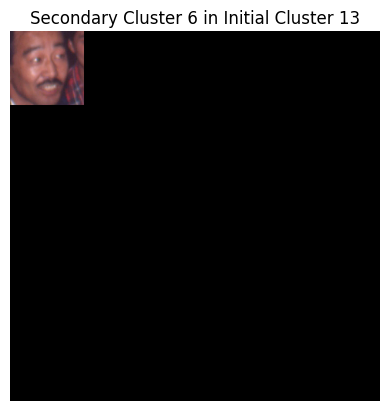

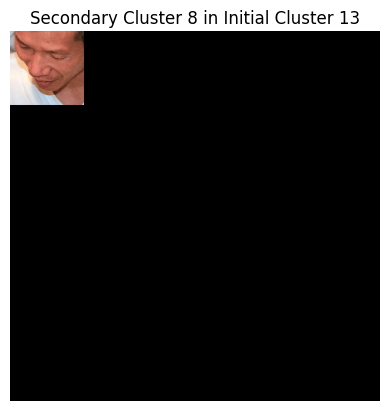

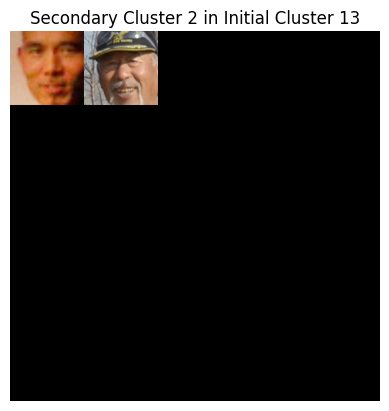

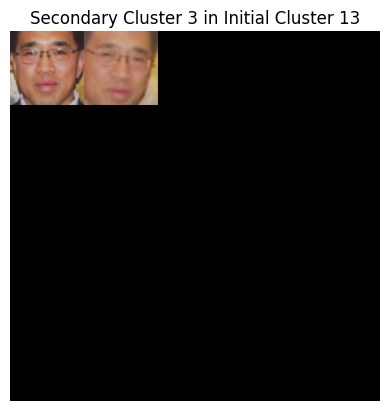

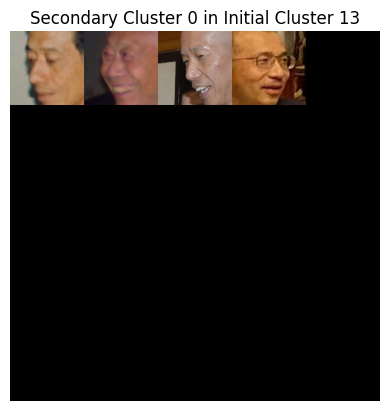

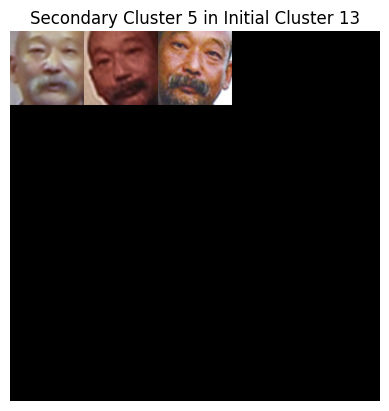

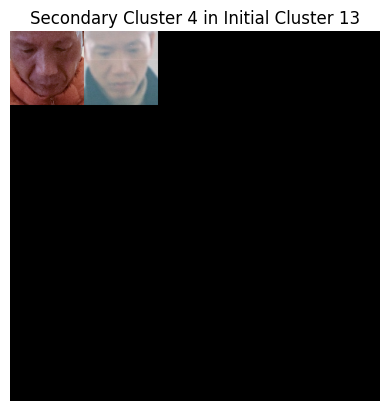

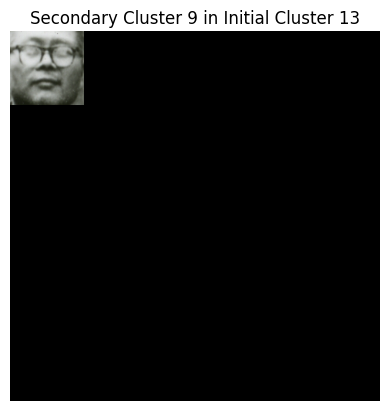

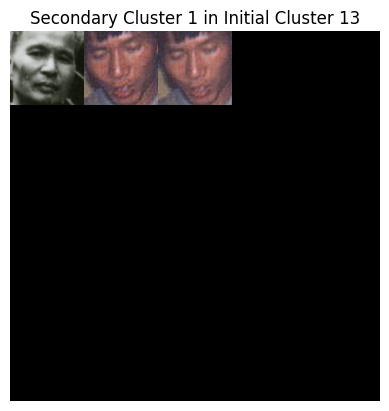

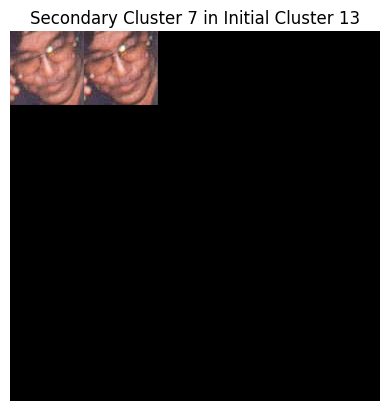

In [37]:

# Define the initial cluster you want to visualize
initial_cluster_label = 13

# Filter the DataFrame for the specified initial cluster
filtered_df = df[df['initial cluster'] == initial_cluster_label]

# Get the unique secondary clusters within the initial cluster
secondary_cluster_labels = filtered_df['secondary cluster'].unique()

# Iterate over each secondary cluster and create a montage
for secondary_cluster_label in secondary_cluster_labels:
    # Filter the DataFrame for the current secondary cluster
    sec_cluster_df = filtered_df[filtered_df['secondary cluster'] == secondary_cluster_label]
    
    # Randomly sample up to 25 images from the filtered DataFrame
    sample_size = min(25, len(sec_cluster_df))
    sampled_df = sec_cluster_df.sample(n=sample_size, random_state=42)
    
    faces = []

    # Loop over the sampled DataFrame rows to extract and process the face images
    for _, row in sampled_df.iterrows():
        image_path = row["image path"]
        image = cv2.imread(image_path)
        # Assuming the 'loc' column is in your DataFrame and contains the face bounding box
        (top, right, bottom, left) = row["loc"]
        face = image[top:bottom, left:right]
        face = cv2.resize(face, (96, 96))
        faces.append(face)

    # Create a montage using 96x96 "tiles" with 5 rows and 5 columns
    if faces:
        montage = build_montages(faces, (96, 96), (5, 5))[0]
        rgb_image = cv2.cvtColor(montage, cv2.COLOR_BGR2RGB)
        
        title = f"Secondary Cluster {secondary_cluster_label} in Initial Cluster {initial_cluster_label}"
        plt.imshow(rgb_image)
        plt.title(title)
        plt.axis('off')  # Optional: Turn off the axis labels
        plt.show()
    else:
        print(f"[INFO] No images found for Secondary Cluster {secondary_cluster_label} in Initial Cluster {initial_cluster_label}")

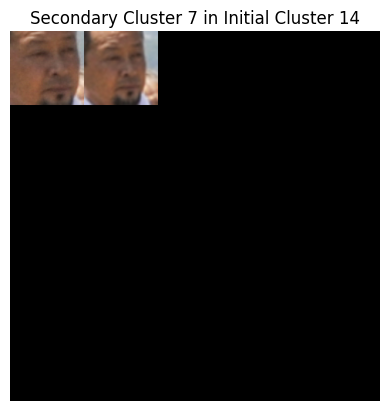

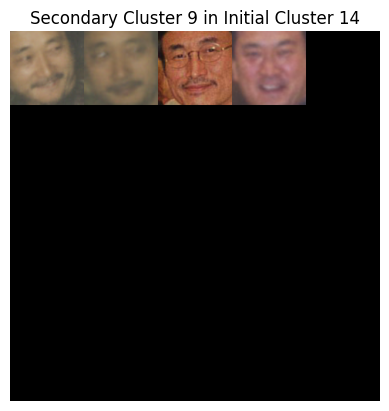

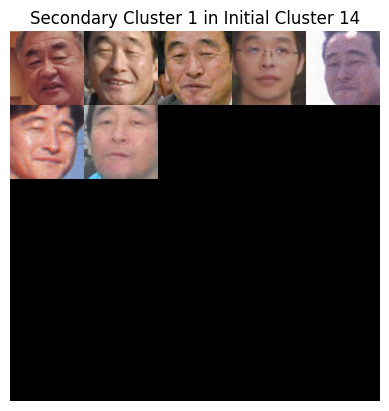

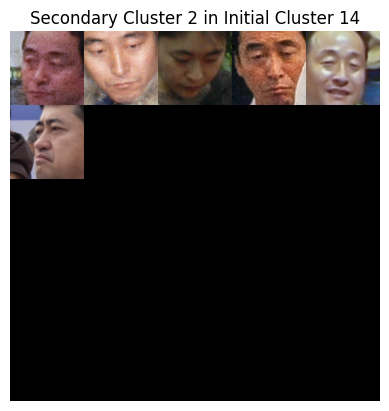

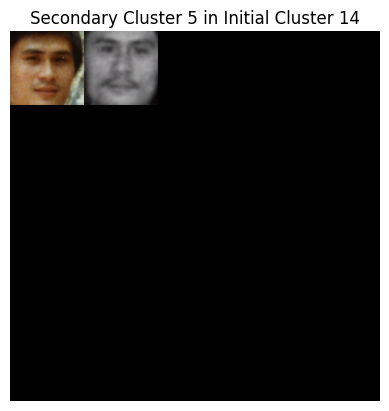

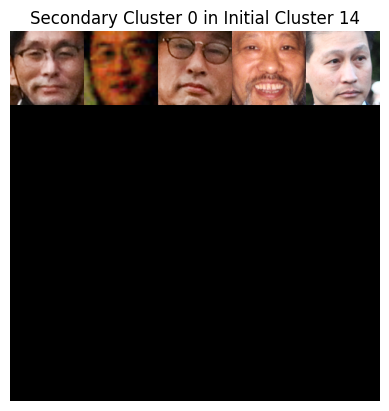

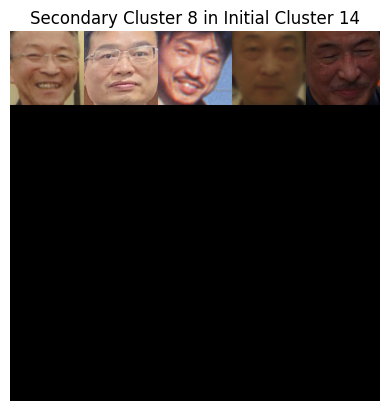

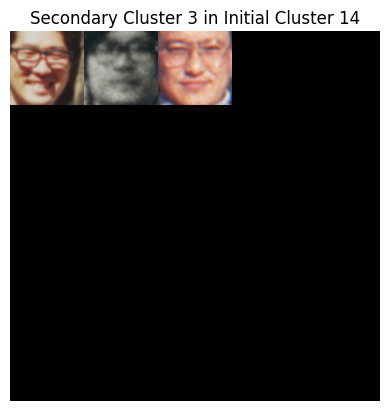

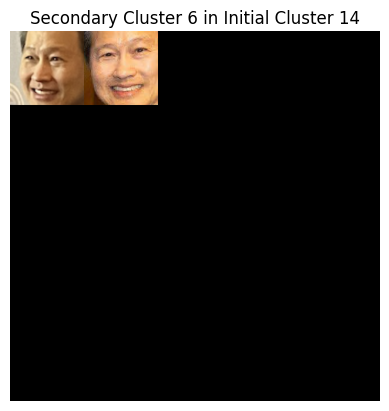

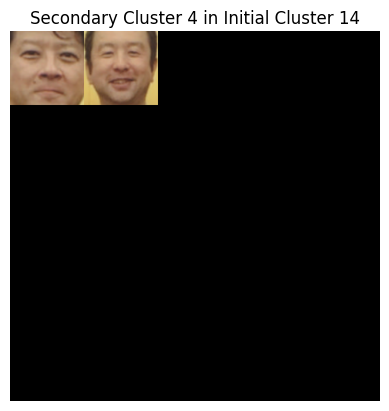

In [38]:

# Define the initial cluster you want to visualize
initial_cluster_label = 14

# Filter the DataFrame for the specified initial cluster
filtered_df = df[df['initial cluster'] == initial_cluster_label]

# Get the unique secondary clusters within the initial cluster
secondary_cluster_labels = filtered_df['secondary cluster'].unique()

# Iterate over each secondary cluster and create a montage
for secondary_cluster_label in secondary_cluster_labels:
    # Filter the DataFrame for the current secondary cluster
    sec_cluster_df = filtered_df[filtered_df['secondary cluster'] == secondary_cluster_label]
    
    # Randomly sample up to 25 images from the filtered DataFrame
    sample_size = min(25, len(sec_cluster_df))
    sampled_df = sec_cluster_df.sample(n=sample_size, random_state=42)
    
    faces = []

    # Loop over the sampled DataFrame rows to extract and process the face images
    for _, row in sampled_df.iterrows():
        image_path = row["image path"]
        image = cv2.imread(image_path)
        # Assuming the 'loc' column is in your DataFrame and contains the face bounding box
        (top, right, bottom, left) = row["loc"]
        face = image[top:bottom, left:right]
        face = cv2.resize(face, (96, 96))
        faces.append(face)

    # Create a montage using 96x96 "tiles" with 5 rows and 5 columns
    if faces:
        montage = build_montages(faces, (96, 96), (5, 5))[0]
        rgb_image = cv2.cvtColor(montage, cv2.COLOR_BGR2RGB)
        
        title = f"Secondary Cluster {secondary_cluster_label} in Initial Cluster {initial_cluster_label}"
        plt.imshow(rgb_image)
        plt.title(title)
        plt.axis('off')  # Optional: Turn off the axis labels
        plt.show()
    else:
        print(f"[INFO] No images found for Secondary Cluster {secondary_cluster_label} in Initial Cluster {initial_cluster_label}")

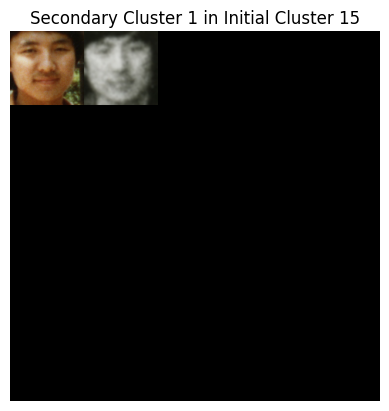

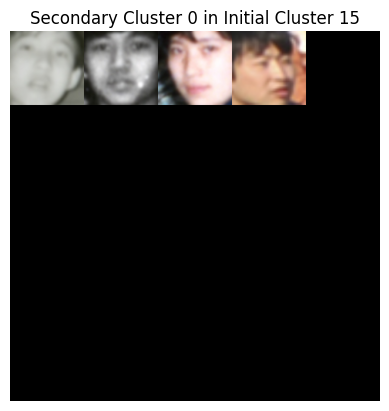

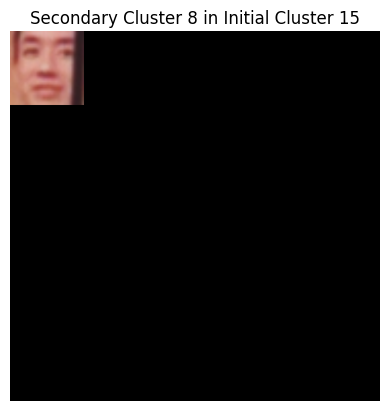

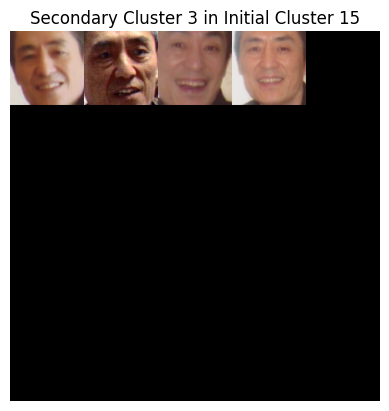

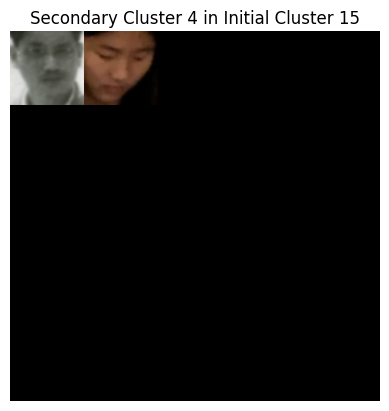

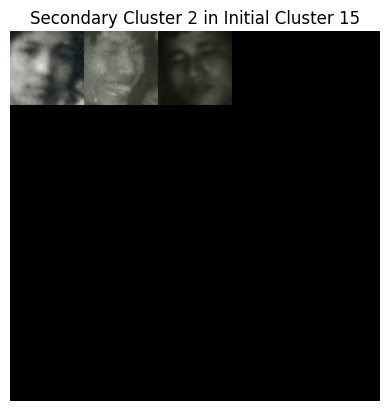

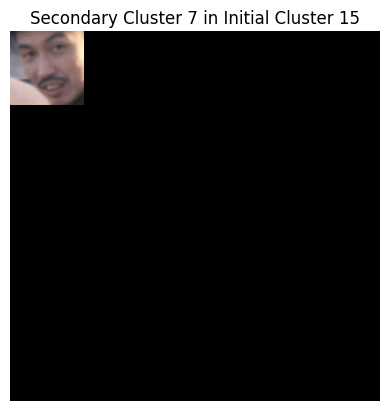

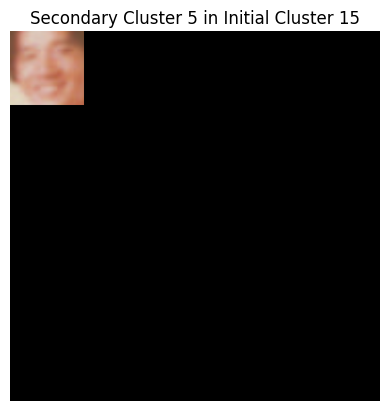

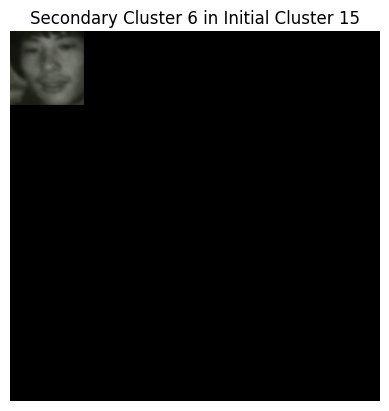

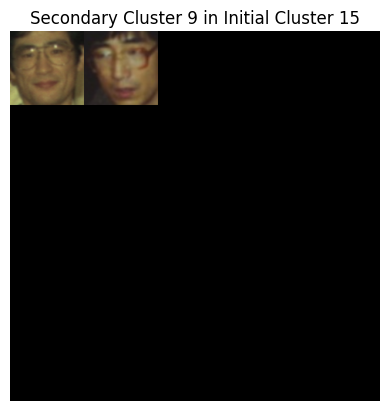

In [39]:

# Define the initial cluster you want to visualize
initial_cluster_label = 15

# Filter the DataFrame for the specified initial cluster
filtered_df = df[df['initial cluster'] == initial_cluster_label]

# Get the unique secondary clusters within the initial cluster
secondary_cluster_labels = filtered_df['secondary cluster'].unique()

# Iterate over each secondary cluster and create a montage
for secondary_cluster_label in secondary_cluster_labels:
    # Filter the DataFrame for the current secondary cluster
    sec_cluster_df = filtered_df[filtered_df['secondary cluster'] == secondary_cluster_label]
    
    # Randomly sample up to 25 images from the filtered DataFrame
    sample_size = min(25, len(sec_cluster_df))
    sampled_df = sec_cluster_df.sample(n=sample_size, random_state=42)
    
    faces = []

    # Loop over the sampled DataFrame rows to extract and process the face images
    for _, row in sampled_df.iterrows():
        image_path = row["image path"]
        image = cv2.imread(image_path)
        # Assuming the 'loc' column is in your DataFrame and contains the face bounding box
        (top, right, bottom, left) = row["loc"]
        face = image[top:bottom, left:right]
        face = cv2.resize(face, (96, 96))
        faces.append(face)

    # Create a montage using 96x96 "tiles" with 5 rows and 5 columns
    if faces:
        montage = build_montages(faces, (96, 96), (5, 5))[0]
        rgb_image = cv2.cvtColor(montage, cv2.COLOR_BGR2RGB)
        
        title = f"Secondary Cluster {secondary_cluster_label} in Initial Cluster {initial_cluster_label}"
        plt.imshow(rgb_image)
        plt.title(title)
        plt.axis('off')  # Optional: Turn off the axis labels
        plt.show()
    else:
        print(f"[INFO] No images found for Secondary Cluster {secondary_cluster_label} in Initial Cluster {initial_cluster_label}")

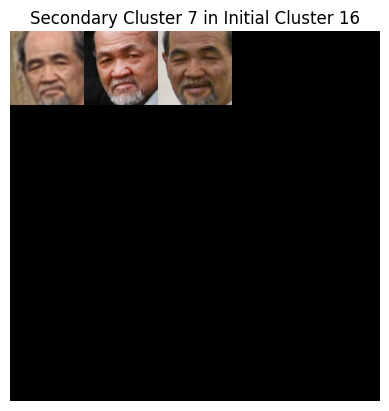

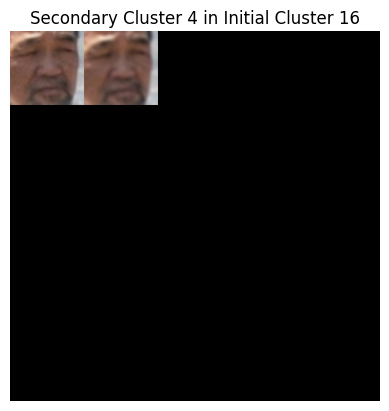

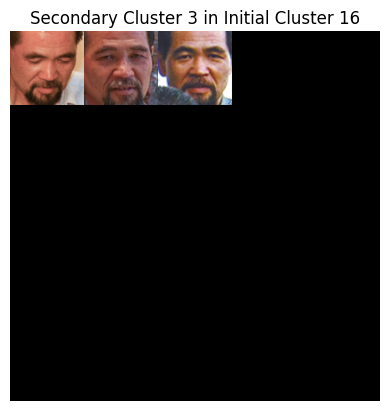

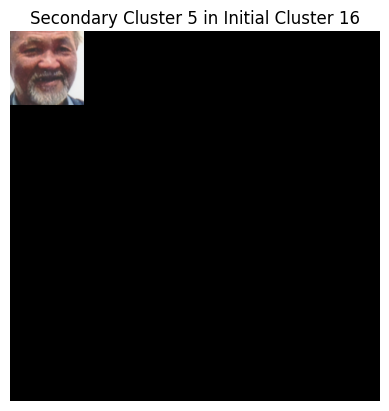

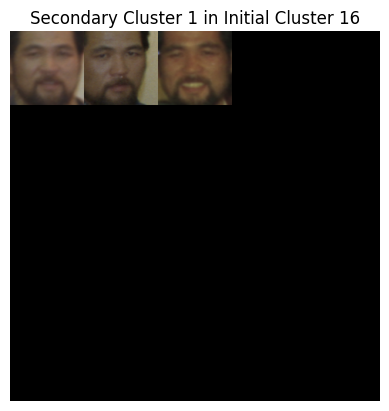

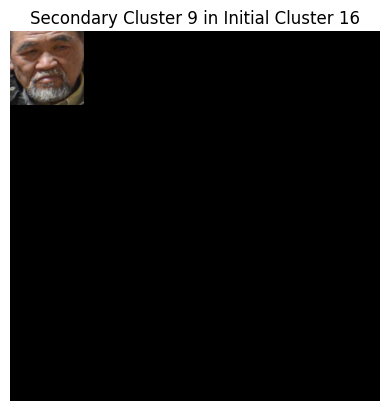

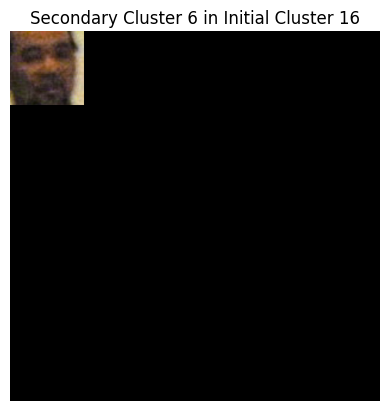

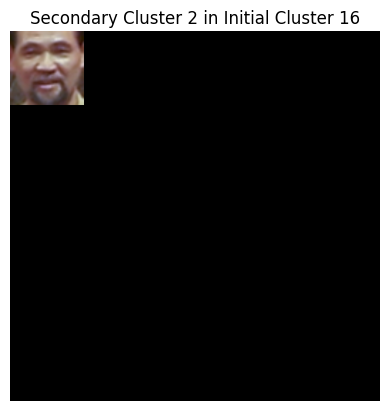

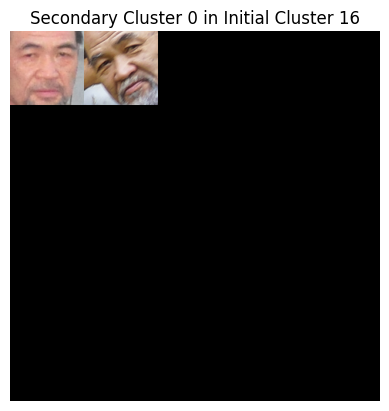

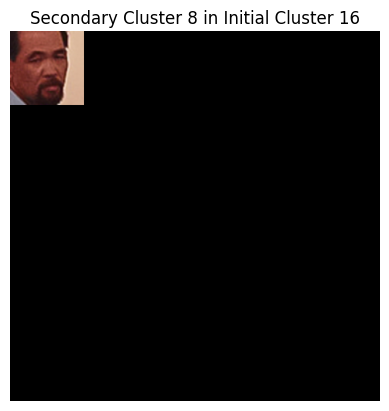

In [40]:

# Define the initial cluster you want to visualize
initial_cluster_label = 16

# Filter the DataFrame for the specified initial cluster
filtered_df = df[df['initial cluster'] == initial_cluster_label]

# Get the unique secondary clusters within the initial cluster
secondary_cluster_labels = filtered_df['secondary cluster'].unique()

# Iterate over each secondary cluster and create a montage
for secondary_cluster_label in secondary_cluster_labels:
    # Filter the DataFrame for the current secondary cluster
    sec_cluster_df = filtered_df[filtered_df['secondary cluster'] == secondary_cluster_label]
    
    # Randomly sample up to 25 images from the filtered DataFrame
    sample_size = min(25, len(sec_cluster_df))
    sampled_df = sec_cluster_df.sample(n=sample_size, random_state=42)
    
    faces = []

    # Loop over the sampled DataFrame rows to extract and process the face images
    for _, row in sampled_df.iterrows():
        image_path = row["image path"]
        image = cv2.imread(image_path)
        # Assuming the 'loc' column is in your DataFrame and contains the face bounding box
        (top, right, bottom, left) = row["loc"]
        face = image[top:bottom, left:right]
        face = cv2.resize(face, (96, 96))
        faces.append(face)

    # Create a montage using 96x96 "tiles" with 5 rows and 5 columns
    if faces:
        montage = build_montages(faces, (96, 96), (5, 5))[0]
        rgb_image = cv2.cvtColor(montage, cv2.COLOR_BGR2RGB)
        
        title = f"Secondary Cluster {secondary_cluster_label} in Initial Cluster {initial_cluster_label}"
        plt.imshow(rgb_image)
        plt.title(title)
        plt.axis('off')  # Optional: Turn off the axis labels
        plt.show()
    else:
        print(f"[INFO] No images found for Secondary Cluster {secondary_cluster_label} in Initial Cluster {initial_cluster_label}")

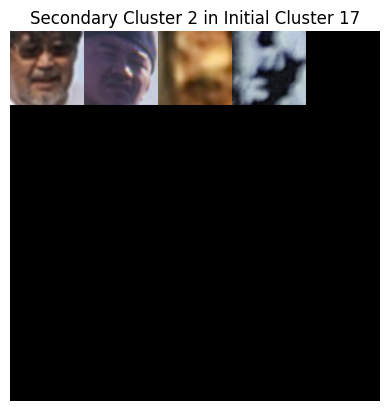

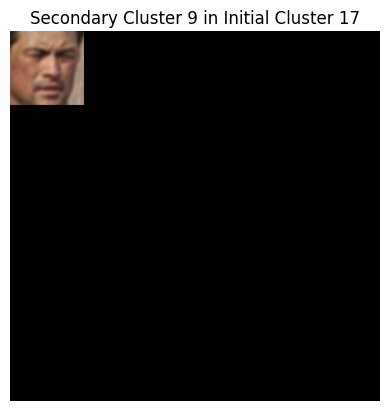

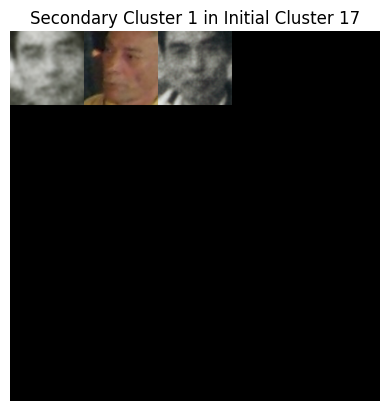

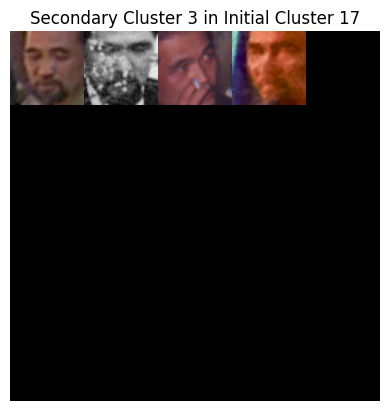

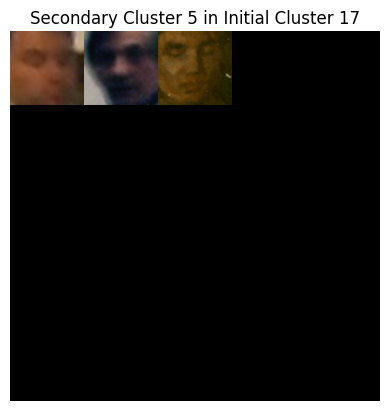

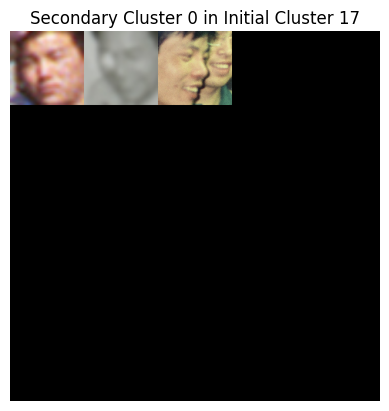

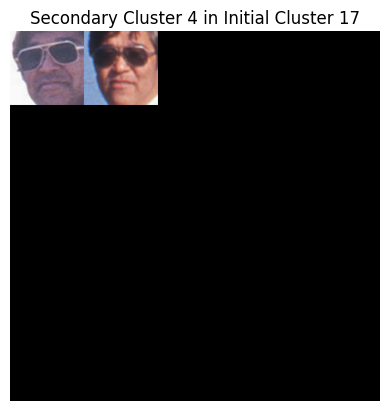

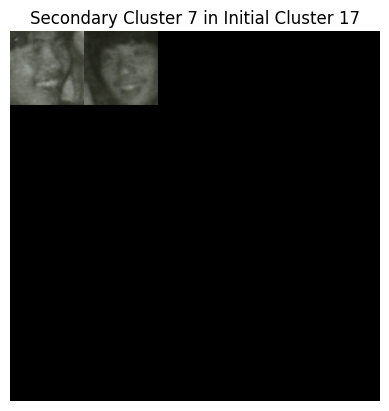

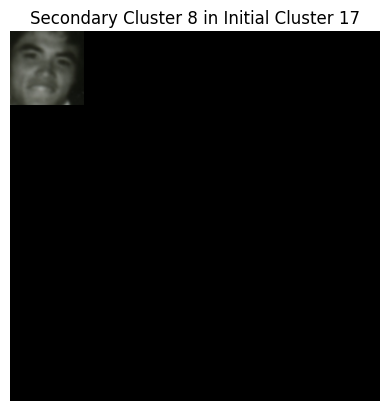

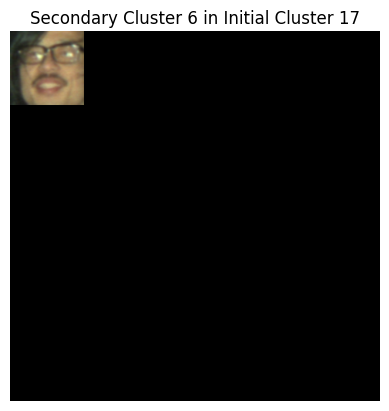

In [41]:

# Define the initial cluster you want to visualize
initial_cluster_label = 17

# Filter the DataFrame for the specified initial cluster
filtered_df = df[df['initial cluster'] == initial_cluster_label]

# Get the unique secondary clusters within the initial cluster
secondary_cluster_labels = filtered_df['secondary cluster'].unique()

# Iterate over each secondary cluster and create a montage
for secondary_cluster_label in secondary_cluster_labels:
    # Filter the DataFrame for the current secondary cluster
    sec_cluster_df = filtered_df[filtered_df['secondary cluster'] == secondary_cluster_label]
    
    # Randomly sample up to 25 images from the filtered DataFrame
    sample_size = min(25, len(sec_cluster_df))
    sampled_df = sec_cluster_df.sample(n=sample_size, random_state=42)
    
    faces = []

    # Loop over the sampled DataFrame rows to extract and process the face images
    for _, row in sampled_df.iterrows():
        image_path = row["image path"]
        image = cv2.imread(image_path)
        # Assuming the 'loc' column is in your DataFrame and contains the face bounding box
        (top, right, bottom, left) = row["loc"]
        face = image[top:bottom, left:right]
        face = cv2.resize(face, (96, 96))
        faces.append(face)

    # Create a montage using 96x96 "tiles" with 5 rows and 5 columns
    if faces:
        montage = build_montages(faces, (96, 96), (5, 5))[0]
        rgb_image = cv2.cvtColor(montage, cv2.COLOR_BGR2RGB)
        
        title = f"Secondary Cluster {secondary_cluster_label} in Initial Cluster {initial_cluster_label}"
        plt.imshow(rgb_image)
        plt.title(title)
        plt.axis('off')  # Optional: Turn off the axis labels
        plt.show()
    else:
        print(f"[INFO] No images found for Secondary Cluster {secondary_cluster_label} in Initial Cluster {initial_cluster_label}")

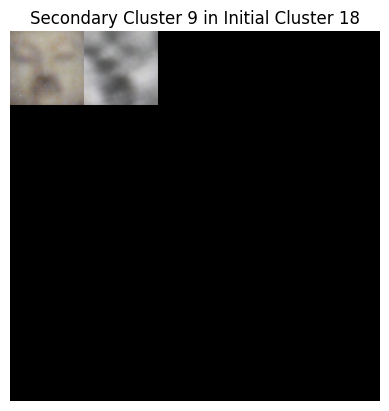

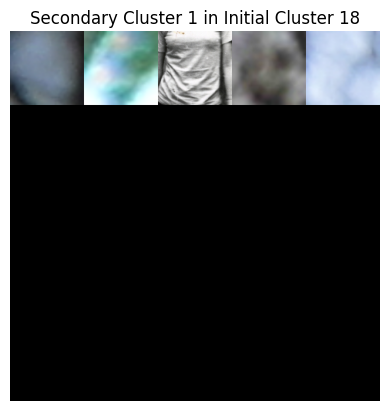

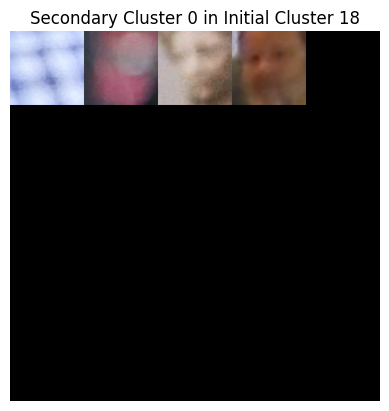

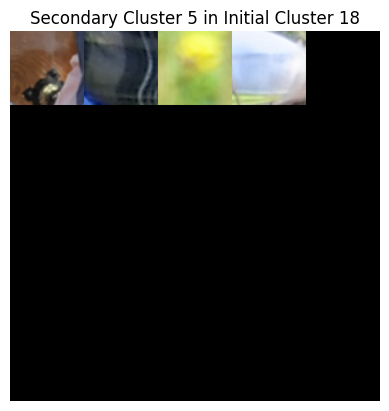

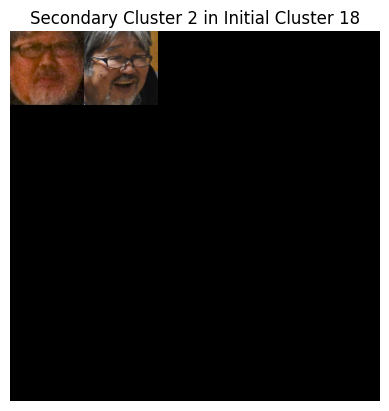

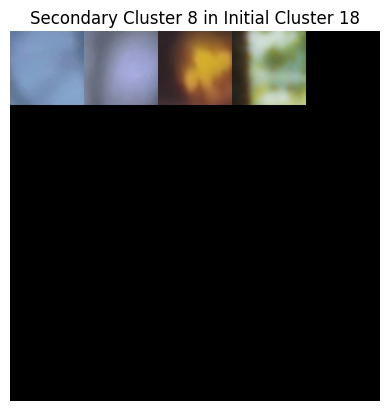

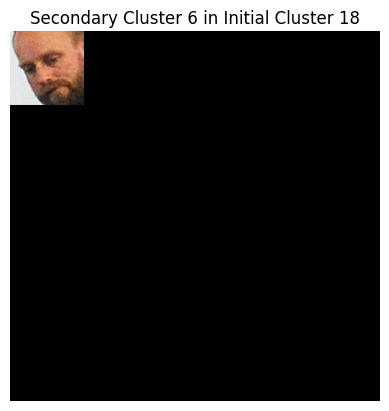

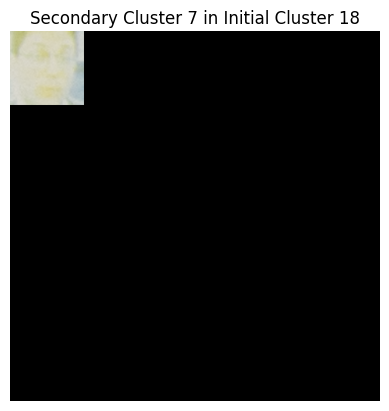

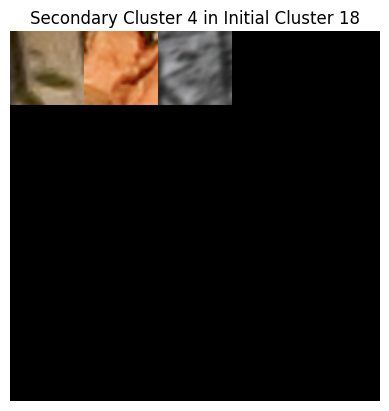

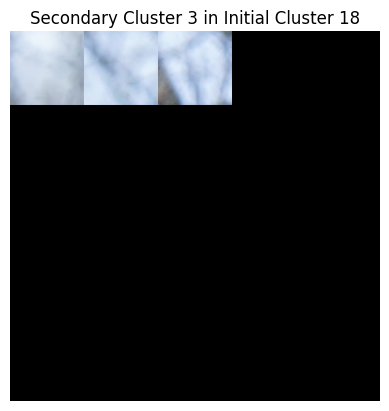

In [42]:

# Define the initial cluster you want to visualize
initial_cluster_label = 18

# Filter the DataFrame for the specified initial cluster
filtered_df = df[df['initial cluster'] == initial_cluster_label]

# Get the unique secondary clusters within the initial cluster
secondary_cluster_labels = filtered_df['secondary cluster'].unique()

# Iterate over each secondary cluster and create a montage
for secondary_cluster_label in secondary_cluster_labels:
    # Filter the DataFrame for the current secondary cluster
    sec_cluster_df = filtered_df[filtered_df['secondary cluster'] == secondary_cluster_label]
    
    # Randomly sample up to 25 images from the filtered DataFrame
    sample_size = min(25, len(sec_cluster_df))
    sampled_df = sec_cluster_df.sample(n=sample_size, random_state=42)
    
    faces = []

    # Loop over the sampled DataFrame rows to extract and process the face images
    for _, row in sampled_df.iterrows():
        image_path = row["image path"]
        image = cv2.imread(image_path)
        # Assuming the 'loc' column is in your DataFrame and contains the face bounding box
        (top, right, bottom, left) = row["loc"]
        face = image[top:bottom, left:right]
        face = cv2.resize(face, (96, 96))
        faces.append(face)

    # Create a montage using 96x96 "tiles" with 5 rows and 5 columns
    if faces:
        montage = build_montages(faces, (96, 96), (5, 5))[0]
        rgb_image = cv2.cvtColor(montage, cv2.COLOR_BGR2RGB)
        
        title = f"Secondary Cluster {secondary_cluster_label} in Initial Cluster {initial_cluster_label}"
        plt.imshow(rgb_image)
        plt.title(title)
        plt.axis('off')  # Optional: Turn off the axis labels
        plt.show()
    else:
        print(f"[INFO] No images found for Secondary Cluster {secondary_cluster_label} in Initial Cluster {initial_cluster_label}")

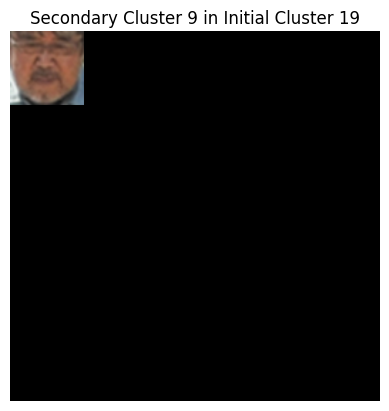

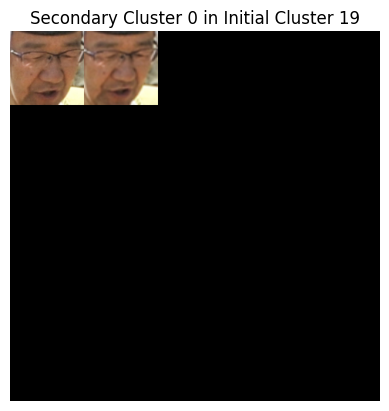

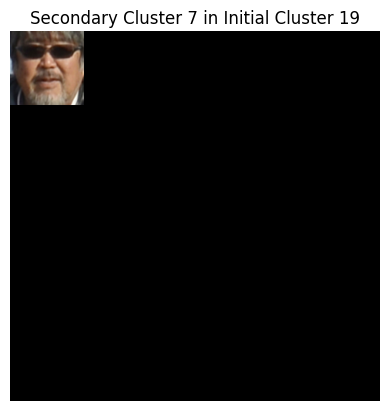

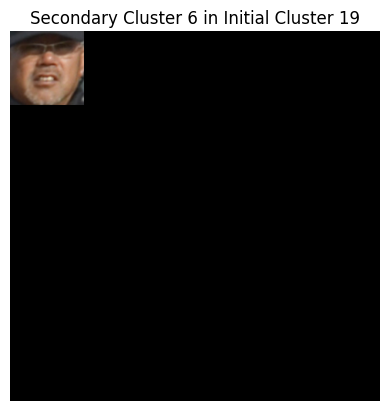

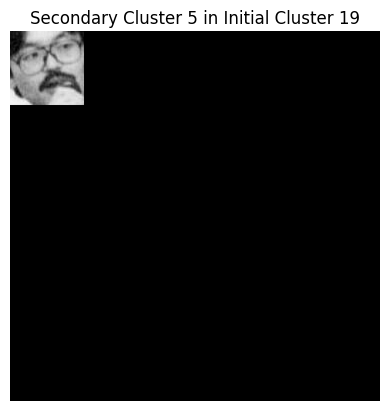

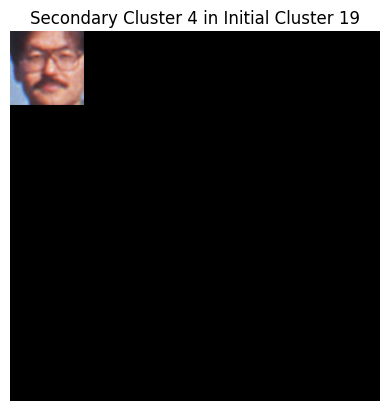

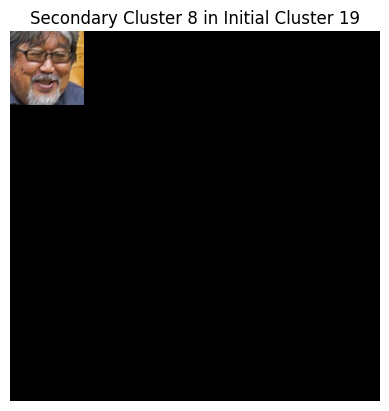

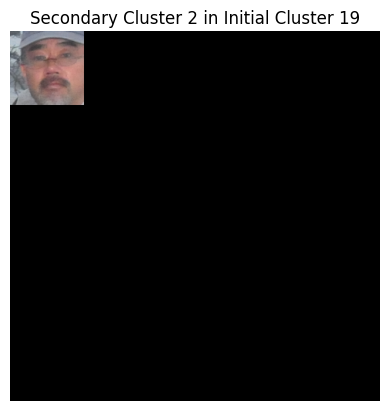

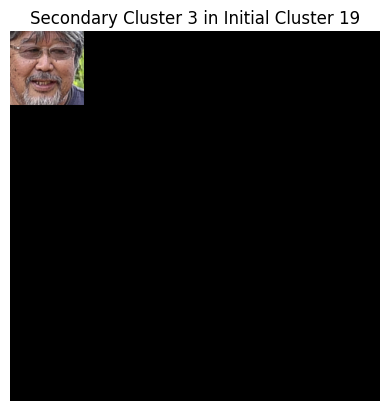

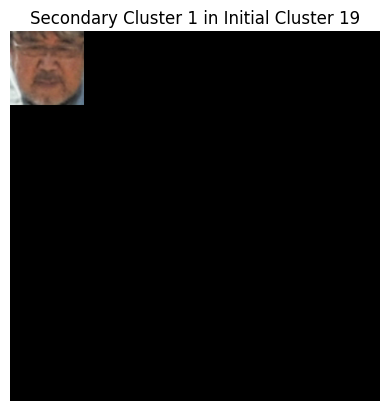

In [43]:

# Define the initial cluster you want to visualize
initial_cluster_label = 19

# Filter the DataFrame for the specified initial cluster
filtered_df = df[df['initial cluster'] == initial_cluster_label]

# Get the unique secondary clusters within the initial cluster
secondary_cluster_labels = filtered_df['secondary cluster'].unique()

# Iterate over each secondary cluster and create a montage
for secondary_cluster_label in secondary_cluster_labels:
    # Filter the DataFrame for the current secondary cluster
    sec_cluster_df = filtered_df[filtered_df['secondary cluster'] == secondary_cluster_label]
    
    # Randomly sample up to 25 images from the filtered DataFrame
    sample_size = min(25, len(sec_cluster_df))
    sampled_df = sec_cluster_df.sample(n=sample_size, random_state=42)
    
    faces = []

    # Loop over the sampled DataFrame rows to extract and process the face images
    for _, row in sampled_df.iterrows():
        image_path = row["image path"]
        image = cv2.imread(image_path)
        # Assuming the 'loc' column is in your DataFrame and contains the face bounding box
        (top, right, bottom, left) = row["loc"]
        face = image[top:bottom, left:right]
        face = cv2.resize(face, (96, 96))
        faces.append(face)

    # Create a montage using 96x96 "tiles" with 5 rows and 5 columns
    if faces:
        montage = build_montages(faces, (96, 96), (5, 5))[0]
        rgb_image = cv2.cvtColor(montage, cv2.COLOR_BGR2RGB)
        
        title = f"Secondary Cluster {secondary_cluster_label} in Initial Cluster {initial_cluster_label}"
        plt.imshow(rgb_image)
        plt.title(title)
        plt.axis('off')  # Optional: Turn off the axis labels
        plt.show()
    else:
        print(f"[INFO] No images found for Secondary Cluster {secondary_cluster_label} in Initial Cluster {initial_cluster_label}")

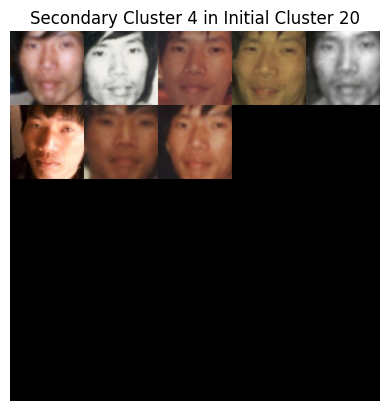

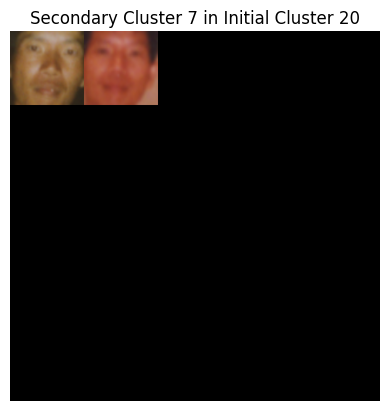

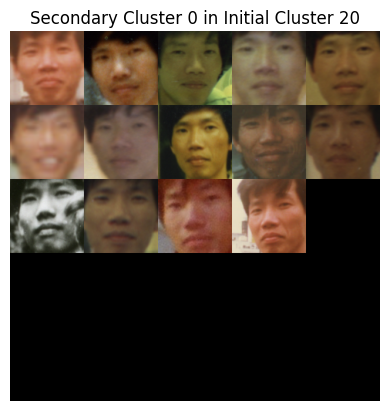

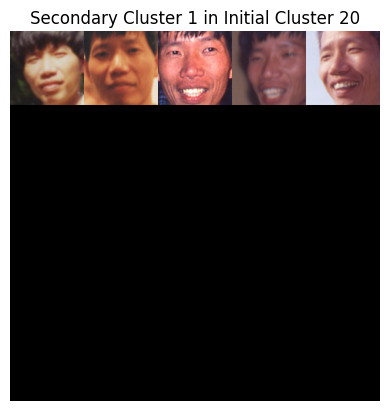

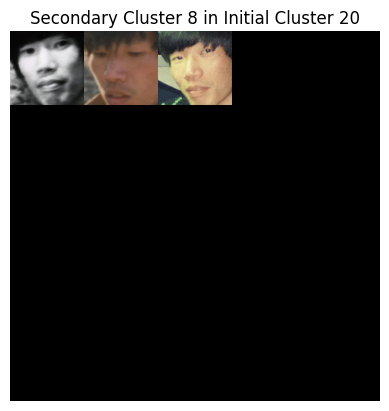

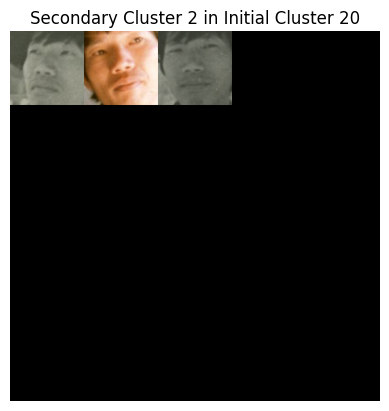

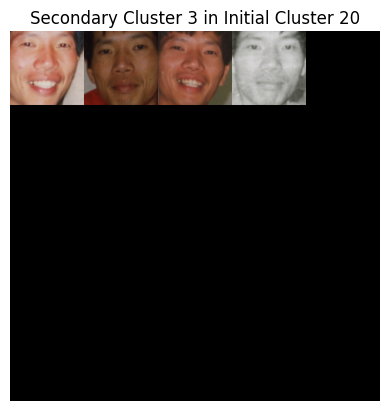

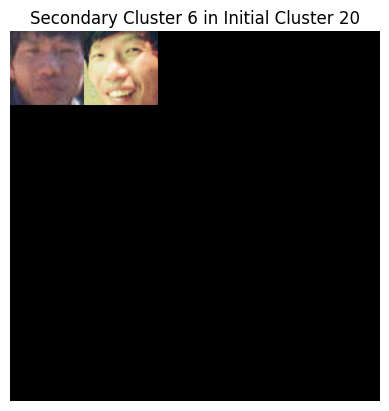

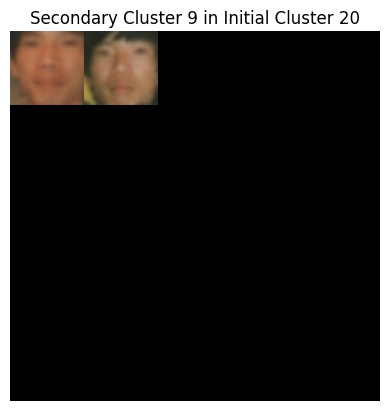

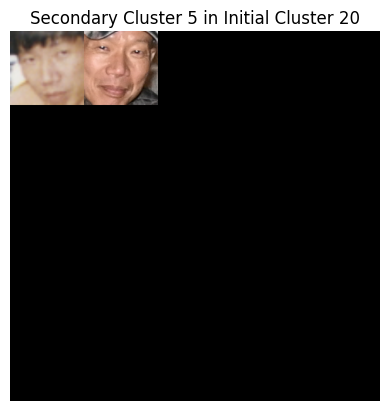

In [44]:

# Define the initial cluster you want to visualize
initial_cluster_label = 20

# Filter the DataFrame for the specified initial cluster
filtered_df = df[df['initial cluster'] == initial_cluster_label]

# Get the unique secondary clusters within the initial cluster
secondary_cluster_labels = filtered_df['secondary cluster'].unique()

# Iterate over each secondary cluster and create a montage
for secondary_cluster_label in secondary_cluster_labels:
    # Filter the DataFrame for the current secondary cluster
    sec_cluster_df = filtered_df[filtered_df['secondary cluster'] == secondary_cluster_label]
    
    # Randomly sample up to 25 images from the filtered DataFrame
    sample_size = min(25, len(sec_cluster_df))
    sampled_df = sec_cluster_df.sample(n=sample_size, random_state=42)
    
    faces = []

    # Loop over the sampled DataFrame rows to extract and process the face images
    for _, row in sampled_df.iterrows():
        image_path = row["image path"]
        image = cv2.imread(image_path)
        # Assuming the 'loc' column is in your DataFrame and contains the face bounding box
        (top, right, bottom, left) = row["loc"]
        face = image[top:bottom, left:right]
        face = cv2.resize(face, (96, 96))
        faces.append(face)

    # Create a montage using 96x96 "tiles" with 5 rows and 5 columns
    if faces:
        montage = build_montages(faces, (96, 96), (5, 5))[0]
        rgb_image = cv2.cvtColor(montage, cv2.COLOR_BGR2RGB)
        
        title = f"Secondary Cluster {secondary_cluster_label} in Initial Cluster {initial_cluster_label}"
        plt.imshow(rgb_image)
        plt.title(title)
        plt.axis('off')  # Optional: Turn off the axis labels
        plt.show()
    else:
        print(f"[INFO] No images found for Secondary Cluster {secondary_cluster_label} in Initial Cluster {initial_cluster_label}")